In [165]:
%matplotlib inline
import numpy as np
import pandas as pd

import datetime

import matplotlib.pyplot as plt
import pylab
from matplotlib.pylab import rcParams
rcParams['figure.figsize'] = 15, 6

import statsmodels.api as sm  
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.stattools import adfuller, acf, pacf, q_stat
from statsmodels.tsa.arima_model import ARIMA, ARMAResults
from statsmodels.graphics.gofplots import qqplot

from sklearn.metrics import mean_squared_error
from math import sqrt

In [166]:
np.random.seed(42)
data = pd.read_csv('../data/siteB.csv')

In [167]:
# Convert the date column to date data type.
data['Date_Name'] = data['Date_Name'].apply(lambda x: datetime.datetime.strptime(x,'%Y-%m-%d'))

In [168]:
print data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 78587 entries, 0 to 78586
Data columns (total 4 columns):
Date_Name        78587 non-null datetime64[ns]
subCategory      78587 non-null object
Purchase_Hour    78587 non-null int64
sales            78587 non-null float64
dtypes: datetime64[ns](1), float64(1), int64(1), object(1)
memory usage: 2.4+ MB
None


In [169]:
# Make a dataframe for each category, and put it into a list...len(list) = 15
# Essentially becomes a list of dataframe

def make_dataframe(df, lis):
    f = lambda x: df[df['subCategory'] == x]
    return map(f, lis)

tem_list = data['subCategory'].unique()
splitted_data = make_dataframe(data, temp_list)
print 'List length: ', len(splitted_data)
print 'For example, third category in the list: \n', splitted_data[2][0:5]

List length:  15
For example, third category in the list: 
       Date_Name subCategory  Purchase_Hour  sales
11887 2015-12-17           C              8  65.85
11888 2015-12-15           C              9  94.72
11889 2015-12-15           C             12   1.69
11890 2015-12-18           C             12   7.27
11891 2015-12-15           C             14   3.38


In [170]:
# Looks like some have missing dates, such as category I has only half of the data.

idx = pd.date_range('09-26-2015', '09-30-2016')

for i, item in enumerate(temp_list):
    splitted_data[i] = splitted_data[i].groupby(by=['Date_Name'])['sales'].sum()
    print item, ':', splitted_data[i].shape
    
#     # Fill in missing dates here.
    splitted_data[i].index = pd.DatetimeIndex(splitted_data[i].index)
    splitted_data[i] = splitted_data[i].reindex(idx, fill_value=1)
    print item, ':', splitted_data[i].shape, '-', splitted_data[i].index

    print 'Missing values: ', splitted_data[0].isnull().values.sum()

A : (365,)
A : (371,) - DatetimeIndex(['2015-09-26', '2015-09-27', '2015-09-28', '2015-09-29',
               '2015-09-30', '2015-10-01', '2015-10-02', '2015-10-03',
               '2015-10-04', '2015-10-05',
               ...
               '2016-09-21', '2016-09-22', '2016-09-23', '2016-09-24',
               '2016-09-25', '2016-09-26', '2016-09-27', '2016-09-28',
               '2016-09-29', '2016-09-30'],
              dtype='datetime64[ns]', length=371, freq='D')
Missing values:  0
B : (365,)
B : (371,) - DatetimeIndex(['2015-09-26', '2015-09-27', '2015-09-28', '2015-09-29',
               '2015-09-30', '2015-10-01', '2015-10-02', '2015-10-03',
               '2015-10-04', '2015-10-05',
               ...
               '2016-09-21', '2016-09-22', '2016-09-23', '2016-09-24',
               '2016-09-25', '2016-09-26', '2016-09-27', '2016-09-28',
               '2016-09-29', '2016-09-30'],
              dtype='datetime64[ns]', length=371, freq='D')
Missing values:  0
C : (364,)
C :

### Category D has the least amount of data...

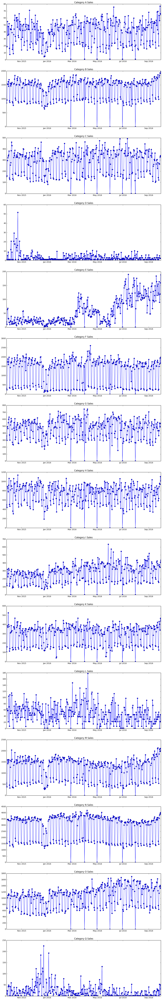

In [171]:
# Time series in connected point plot format...
# Scatter plot sales vs. DateTime for each subcategory...
# We can see the missing data(or date with 0 sales) in the time series this way

fig, axs = plt.subplots(len(temp_list),1, figsize=(15, 96))
axs = axs.ravel()

for i, item in enumerate(temp_list):
    axs[i].plot(splitted_data[i].index, splitted_data[i], '-o')
    axs[i].set_title('Category {} Sales'.format(item))

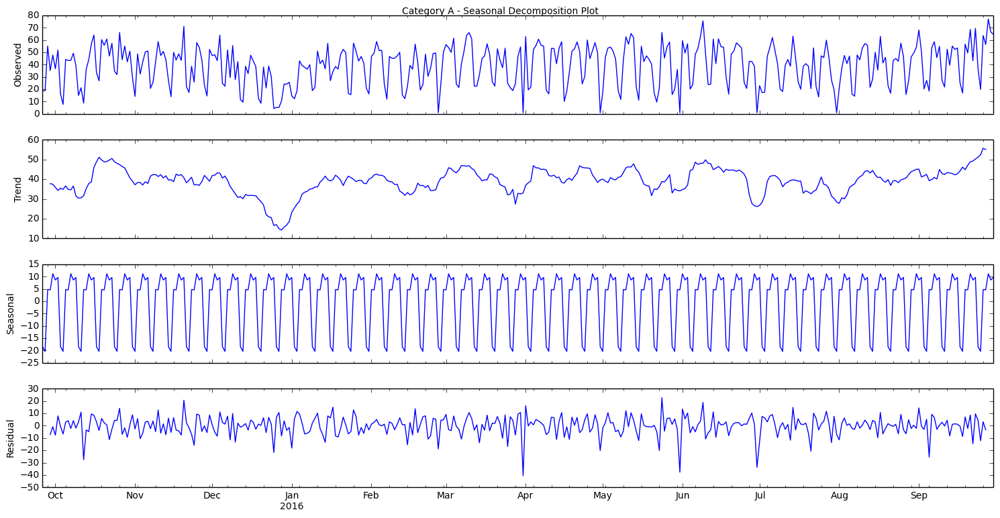

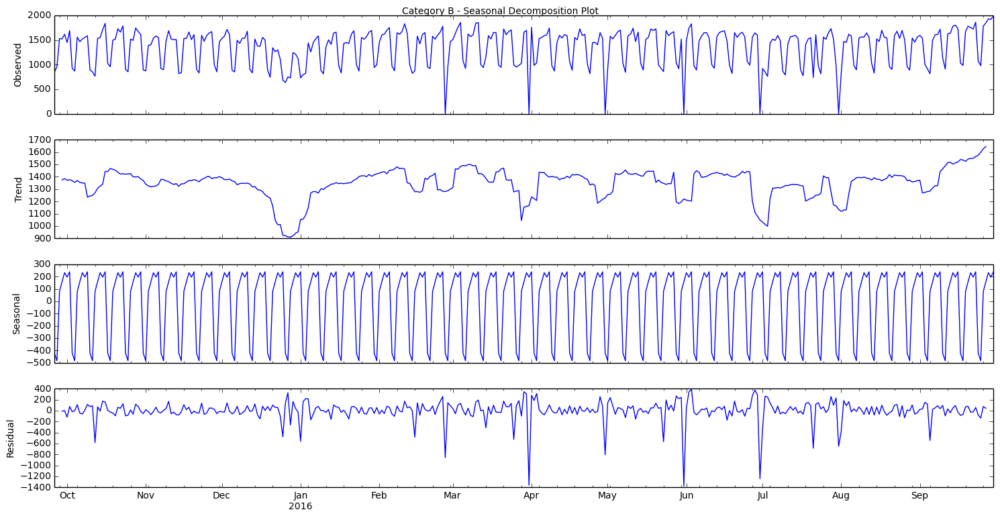

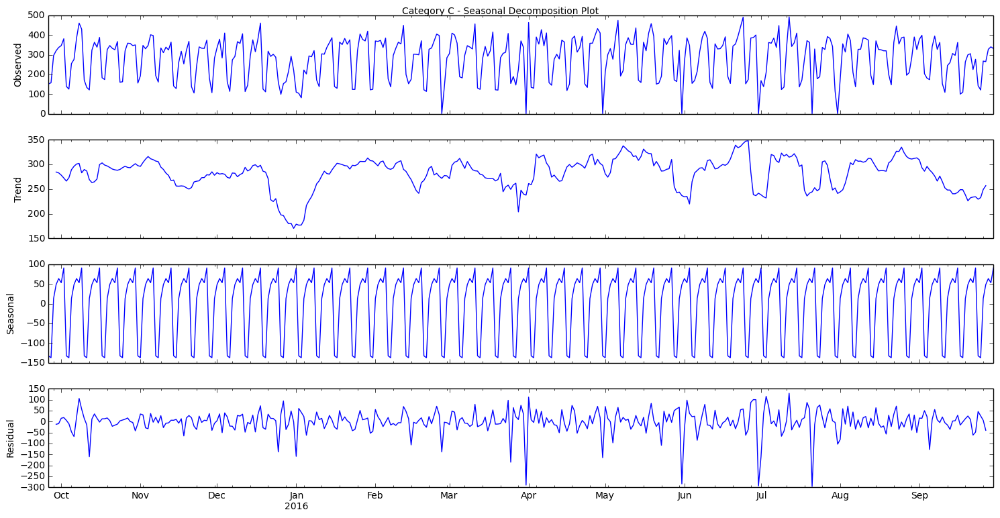

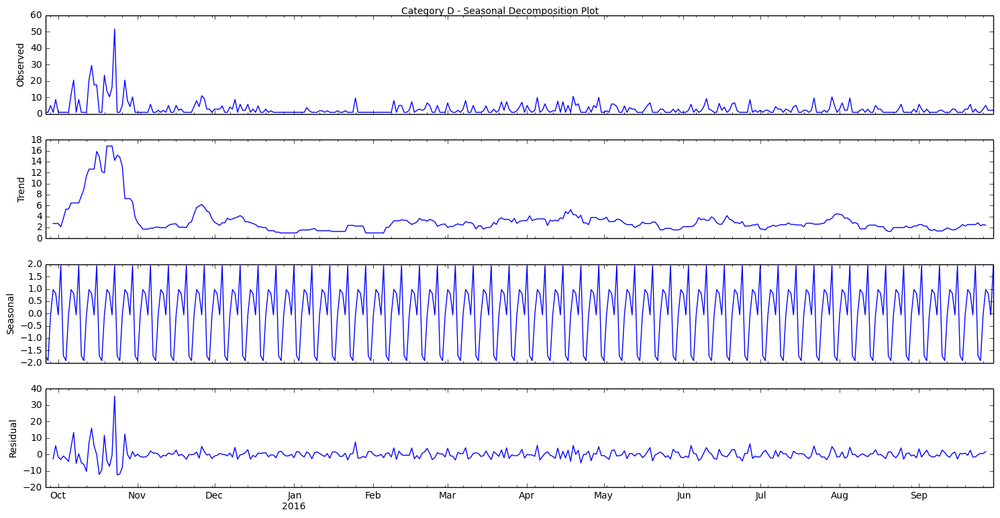

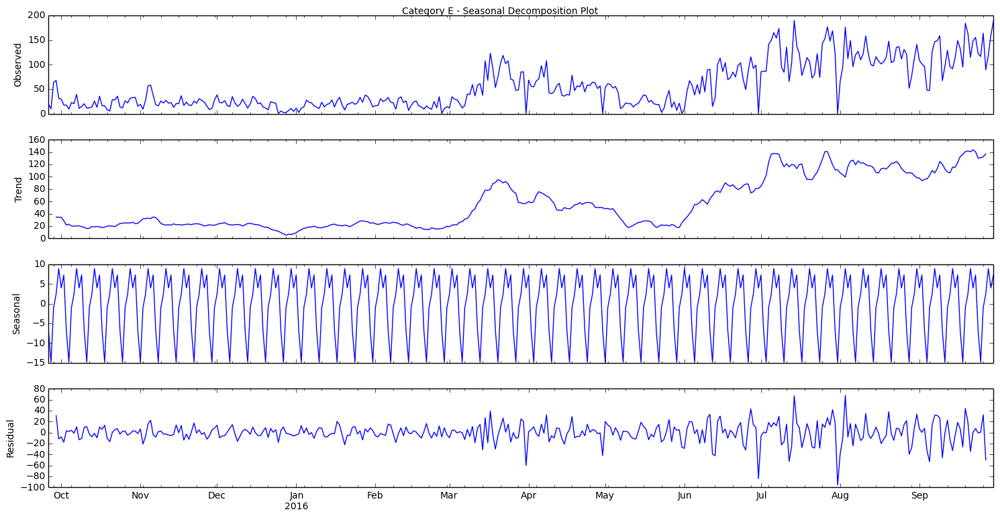

...

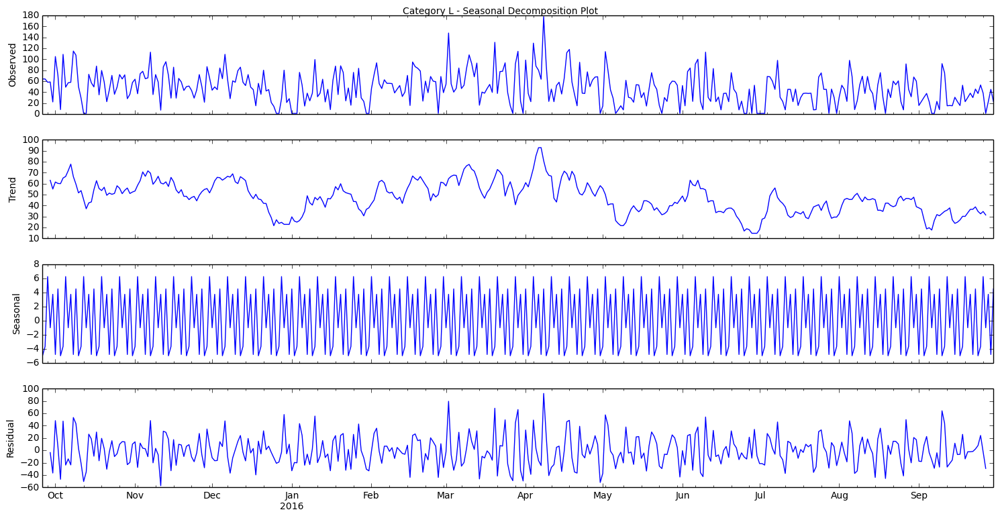

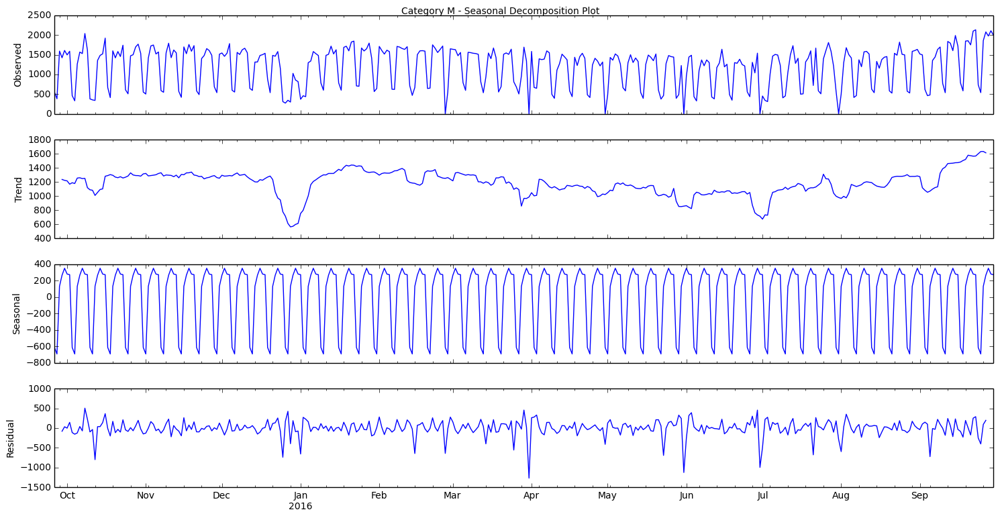

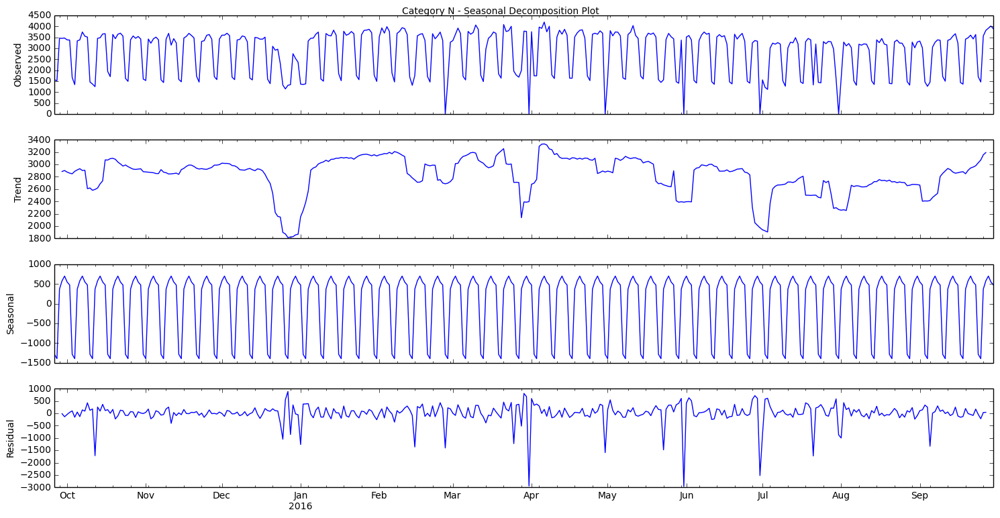

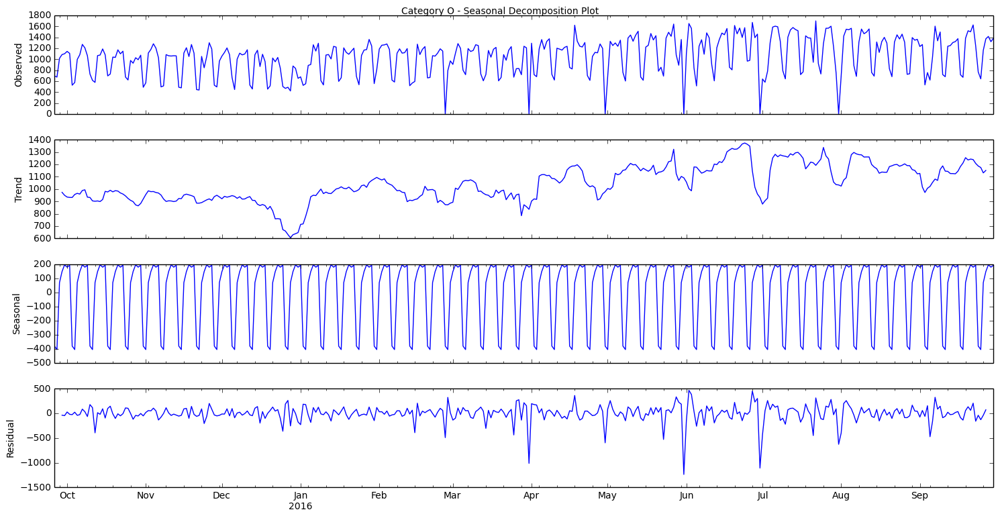

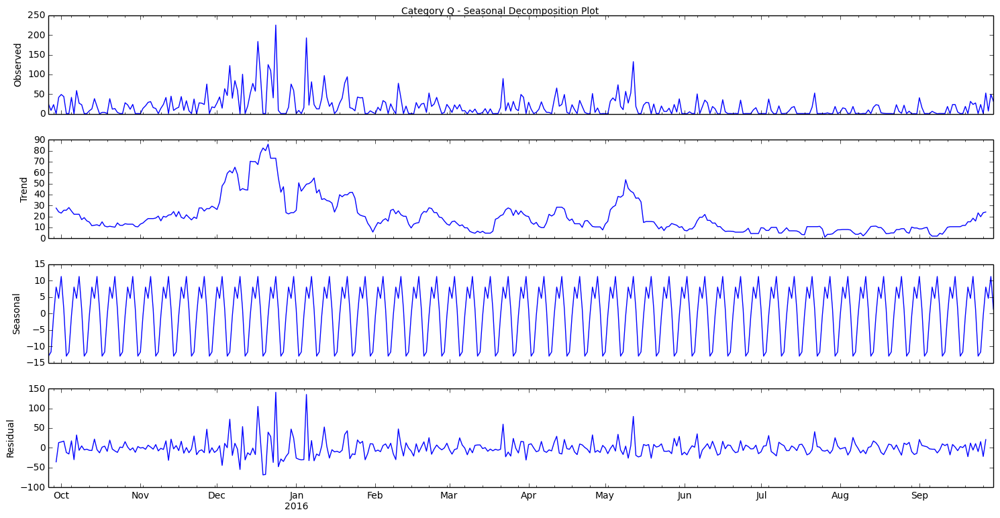

In [172]:
# Seasonal decomposition plots...
def decomposition(timeseries, item):
    decomposition = seasonal_decompose(timeseries, freq=7)
    fig = plt.figure()  
    fig = decomposition.plot()  
    fig.set_size_inches(15, 8)
    fig.suptitle('Category {} - Seasonal Decomposition Plot'.format(item))

_ = map(decomposition, splitted_data, temp_list)

In [173]:
# A function to test serie's stationarity... 

def test_stationarity(timeseries, item):
    
    #Determing rolling statistics
    rolmean = pd.rolling_mean(timeseries, window=12)
    rolstd = pd.rolling_std(timeseries, window=12)

    #Plot rolling statistics:
    orig = plt.plot(timeseries, color='blue',label='Original')
    mean = plt.plot(rolmean, color='red', label='Rolling Mean')
    std = plt.plot(rolstd, color='black', label = 'Rolling Std')
    plt.legend(loc='best')
    plt.title('{} - Rolling Mean & Standard Deviation'.format(item))
    plt.show(block=False)
    
    #Perform Dickey-Fuller test:
    print 'Results of Dickey-Fuller Test:'
    dftest = adfuller(timeseries, autolag='AIC')
    dfoutput = pd.Series(dftest[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
    for key,value in dftest[4].items():
        dfoutput['Critical Value (%s)'%key] = value
    print dfoutput

/Library/Python/2.7/site-packages/ipykernel/__main__.py:6: FutureWarning: pd.rolling_mean is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=12,center=False).mean()
/Library/Python/2.7/site-packages/ipykernel/__main__.py:7: FutureWarning: pd.rolling_std is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=12,center=False).std()


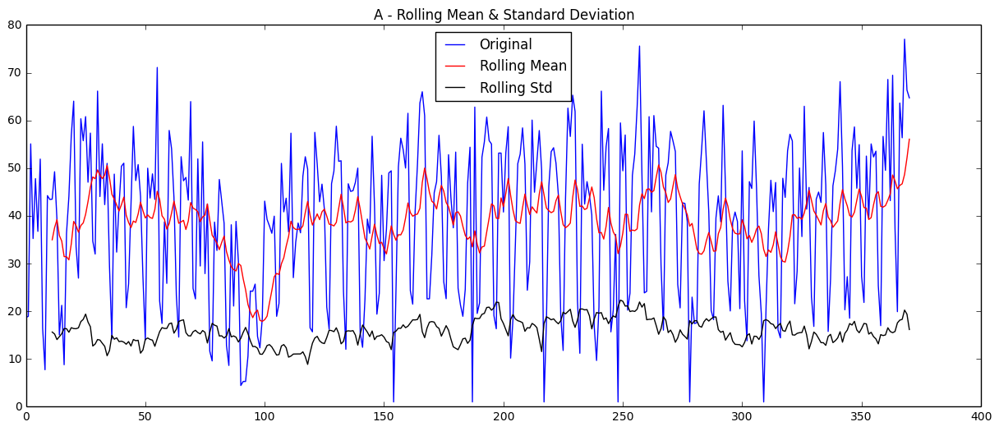

Results of Dickey-Fuller Test:
Test Statistic                  -3.620264
p-value                          0.005385
#Lags Used                      15.000000
Number of Observations Used    355.000000
Critical Value (5%)             -2.869716
Critical Value (1%)             -3.448906
Critical Value (10%)            -2.571126
dtype: float64


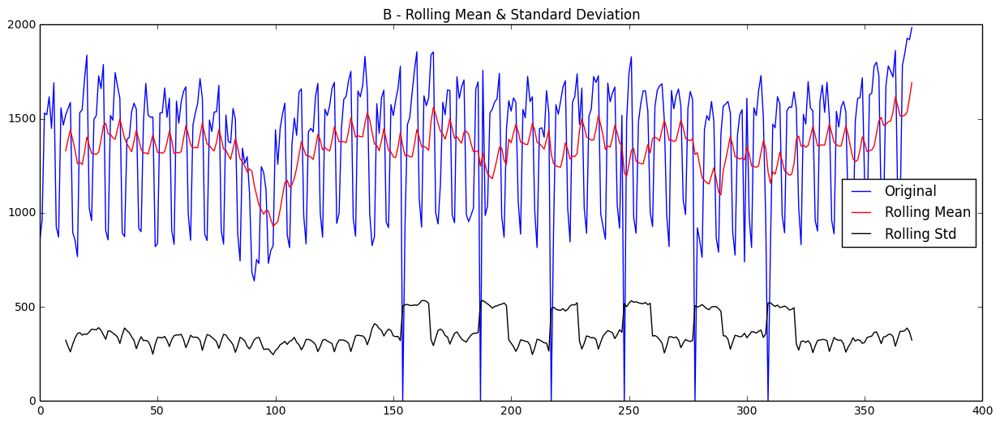

Results of Dickey-Fuller Test:
Test Statistic                  -3.194173
p-value                          0.020324
#Lags Used                      15.000000
Number of Observations Used    355.000000
Critical Value (5%)             -2.869716
Critical Value (1%)             -3.448906
Critical Value (10%)            -2.571126
dtype: float64


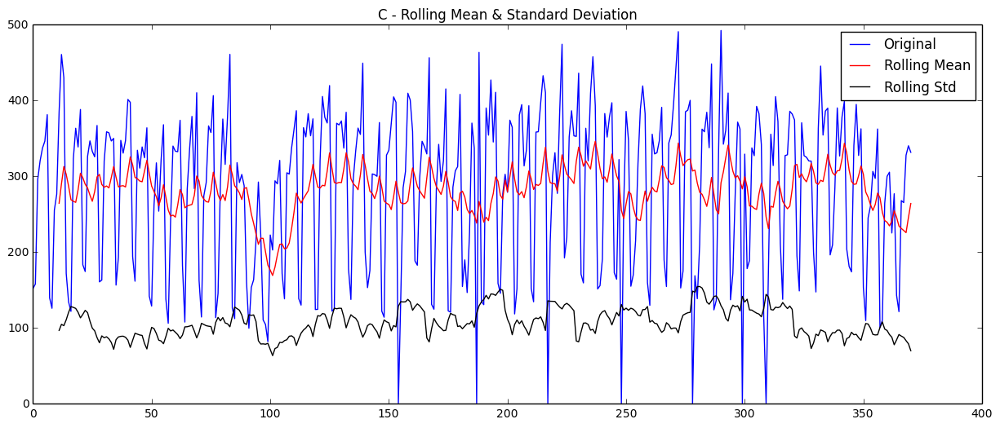

Results of Dickey-Fuller Test:
Test Statistic                  -4.455600
p-value                          0.000236
#Lags Used                      16.000000
Number of Observations Used    354.000000
Critical Value (5%)             -2.869739
Critical Value (1%)             -3.448958
Critical Value (10%)            -2.571138
dtype: float64


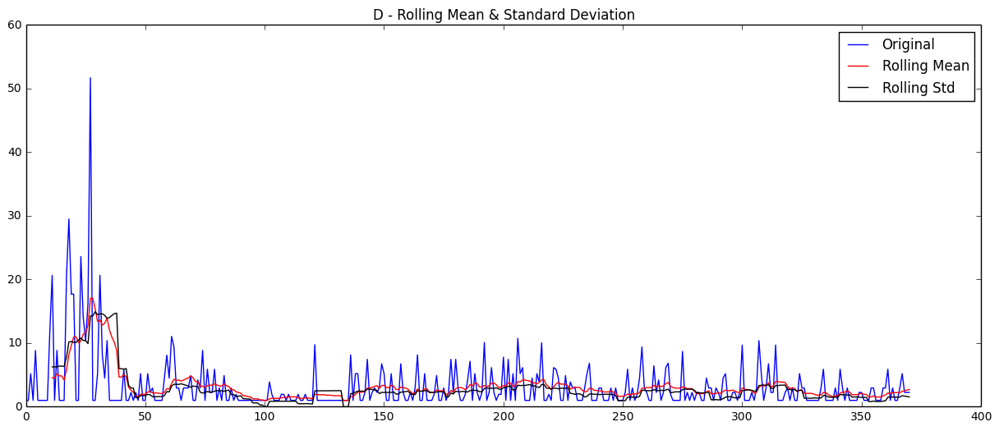

Results of Dickey-Fuller Test:
Test Statistic                  -3.744690
p-value                          0.003527
#Lags Used                      10.000000
Number of Observations Used    360.000000
Critical Value (5%)             -2.869602
Critical Value (1%)             -3.448646
Critical Value (10%)            -2.571065
dtype: float64


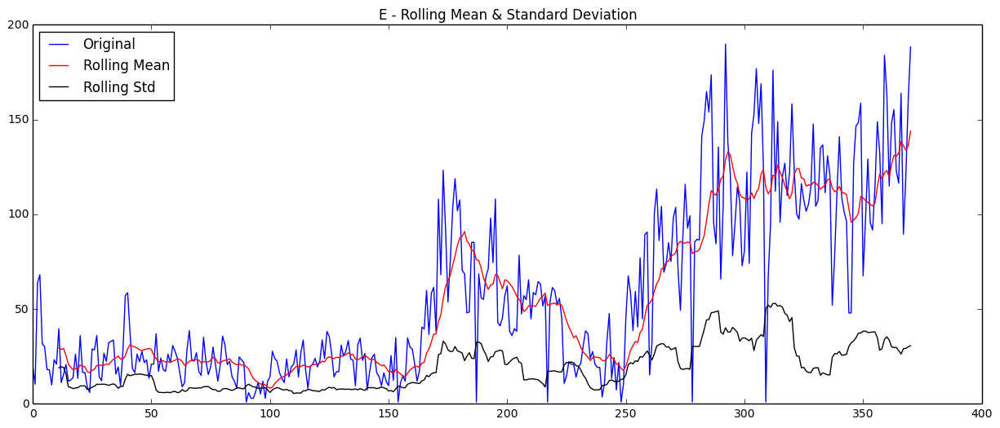

Results of Dickey-Fuller Test:
Test Statistic                  -0.250403
p-value                          0.932241
#Lags Used                      11.000000
Number of Observations Used    359.000000
Critical Value (5%)             -2.869625
Critical Value (1%)             -3.448697
Critical Value (10%)            -2.571077
dtype: float64


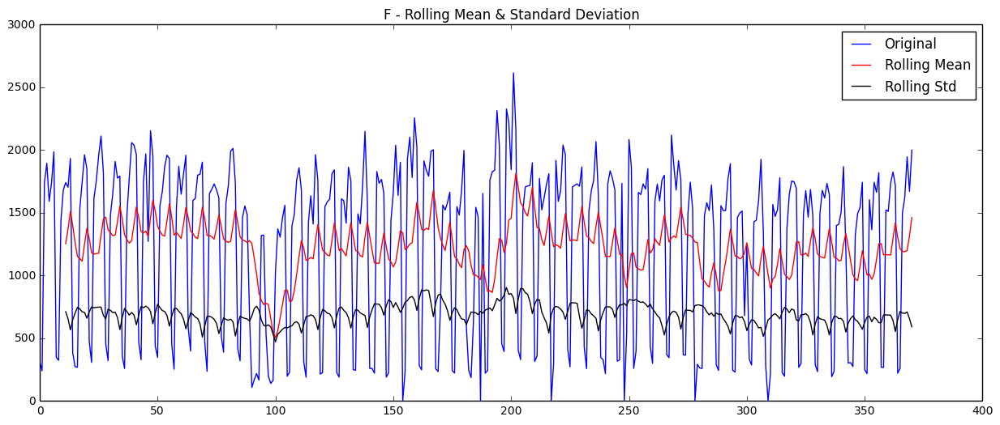

Results of Dickey-Fuller Test:
Test Statistic                  -4.210900
p-value                          0.000631
#Lags Used                      14.000000
Number of Observations Used    356.000000
Critical Value (5%)             -2.869693
Critical Value (1%)             -3.448853
Critical Value (10%)            -2.571114
dtype: float64


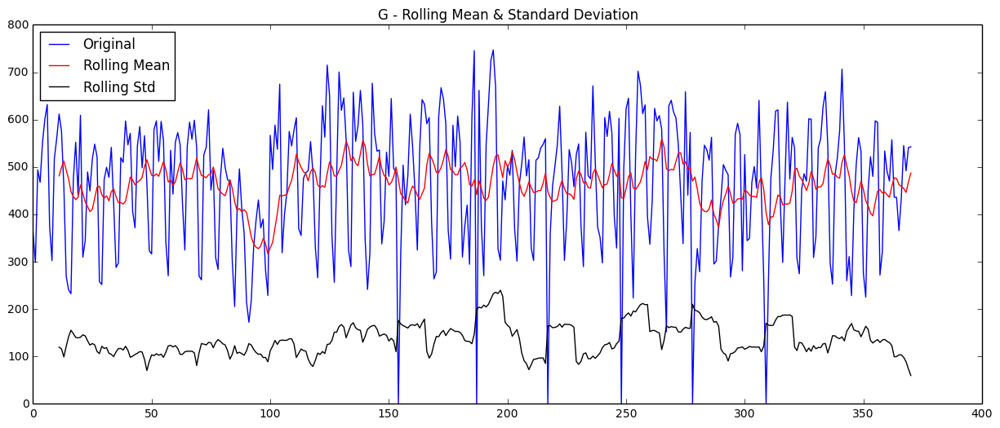

Results of Dickey-Fuller Test:
Test Statistic                  -4.072479
p-value                          0.001075
#Lags Used                      15.000000
Number of Observations Used    355.000000
Critical Value (5%)             -2.869716
Critical Value (1%)             -3.448906
Critical Value (10%)            -2.571126
dtype: float64


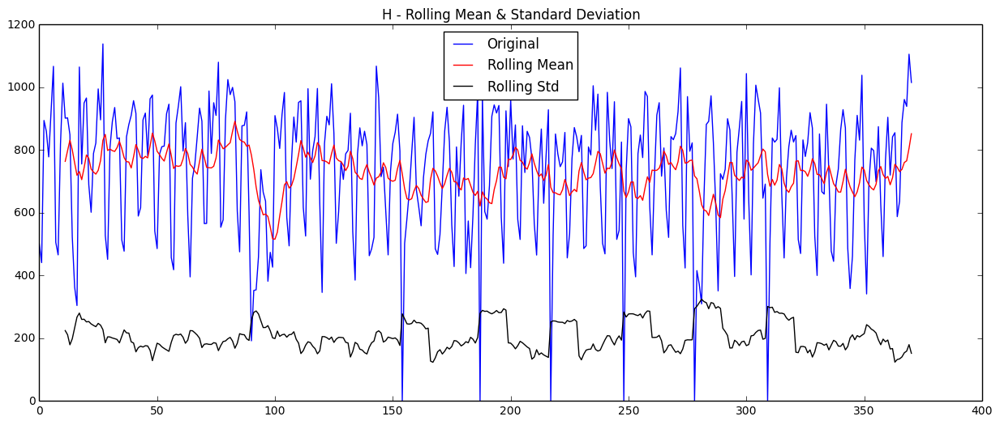

Results of Dickey-Fuller Test:
Test Statistic                  -4.746869
p-value                          0.000069
#Lags Used                      15.000000
Number of Observations Used    355.000000
Critical Value (5%)             -2.869716
Critical Value (1%)             -3.448906
Critical Value (10%)            -2.571126
dtype: float64


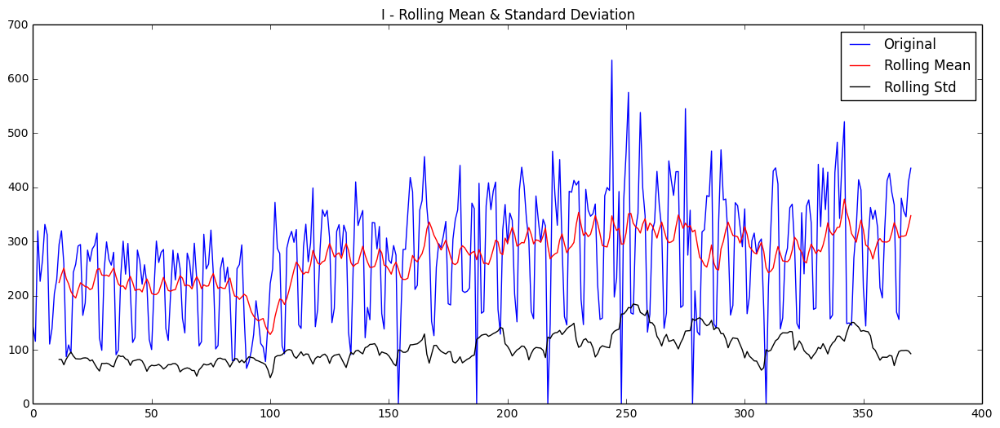

Results of Dickey-Fuller Test:
Test Statistic                  -2.006514
p-value                          0.283724
#Lags Used                      13.000000
Number of Observations Used    357.000000
Critical Value (5%)             -2.869670
Critical Value (1%)             -3.448801
Critical Value (10%)            -2.571101
dtype: float64


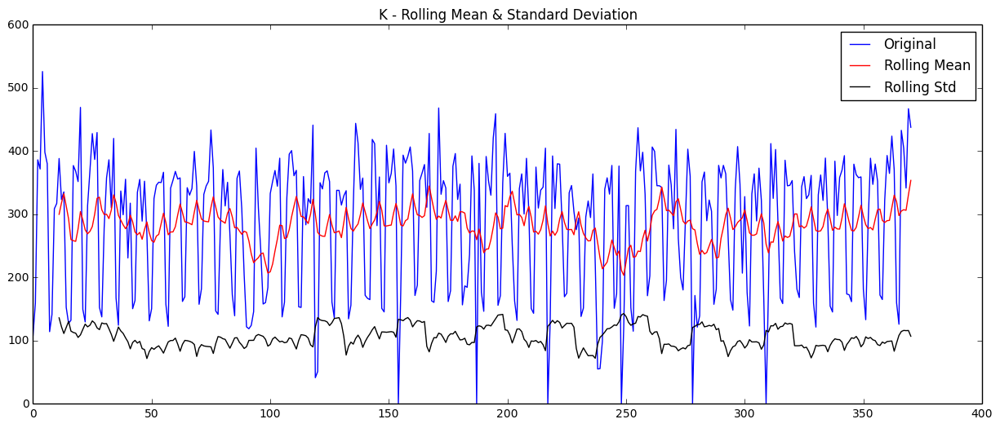

Results of Dickey-Fuller Test:
Test Statistic                  -4.908067
p-value                          0.000034
#Lags Used                      17.000000
Number of Observations Used    353.000000
Critical Value (5%)             -2.869763
Critical Value (1%)             -3.449011
Critical Value (10%)            -2.571151
dtype: float64


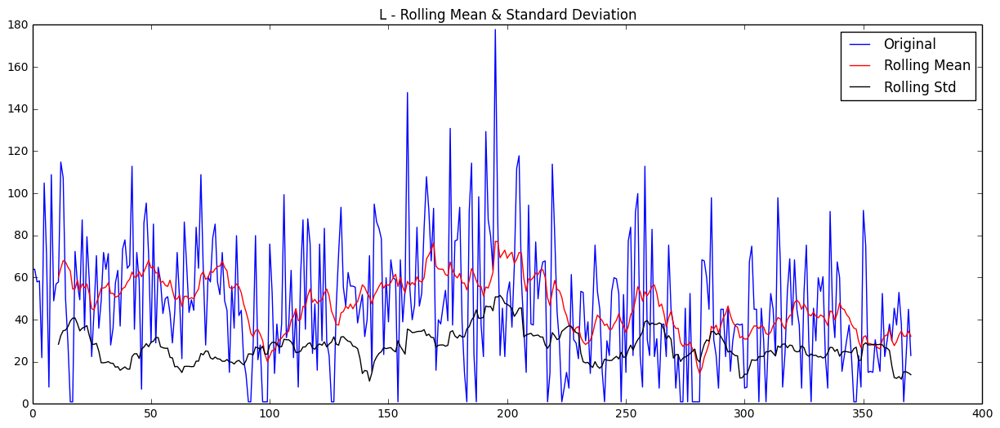

Results of Dickey-Fuller Test:
Test Statistic                  -4.866147
p-value                          0.000041
#Lags Used                       6.000000
Number of Observations Used    364.000000
Critical Value (5%)             -2.869513
Critical Value (1%)             -3.448443
Critical Value (10%)            -2.571018
dtype: float64


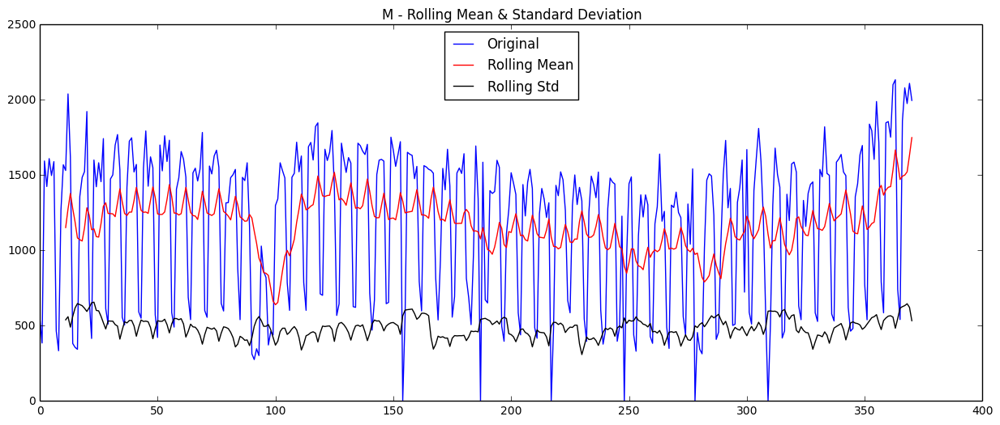

Results of Dickey-Fuller Test:
Test Statistic                  -2.444862
p-value                          0.129473
#Lags Used                      14.000000
Number of Observations Used    356.000000
Critical Value (5%)             -2.869693
Critical Value (1%)             -3.448853
Critical Value (10%)            -2.571114
dtype: float64


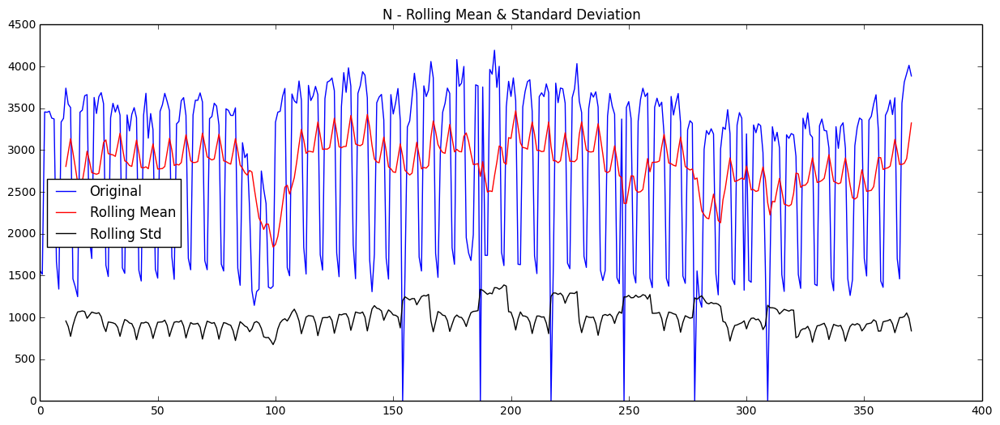

Results of Dickey-Fuller Test:
Test Statistic                  -3.980050
p-value                          0.001519
#Lags Used                      16.000000
Number of Observations Used    354.000000
Critical Value (5%)             -2.869739
Critical Value (1%)             -3.448958
Critical Value (10%)            -2.571138
dtype: float64


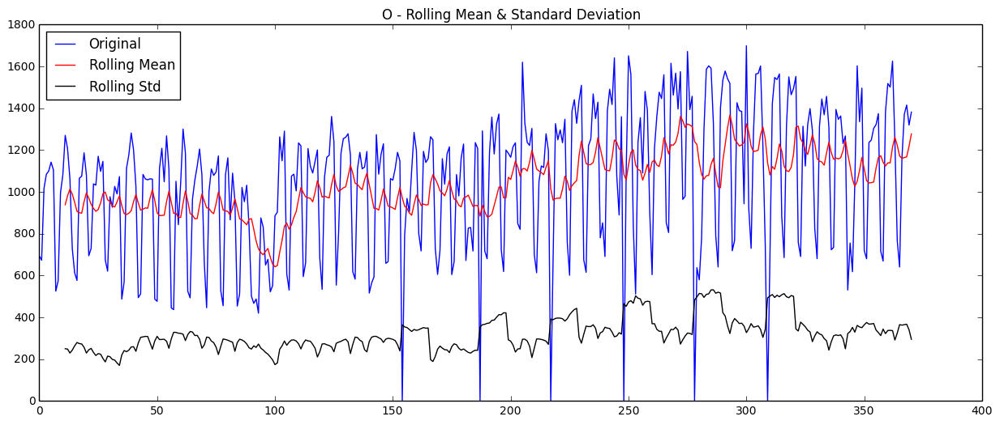

Results of Dickey-Fuller Test:
Test Statistic                  -2.039973
p-value                          0.269326
#Lags Used                      13.000000
Number of Observations Used    357.000000
Critical Value (5%)             -2.869670
Critical Value (1%)             -3.448801
Critical Value (10%)            -2.571101
dtype: float64


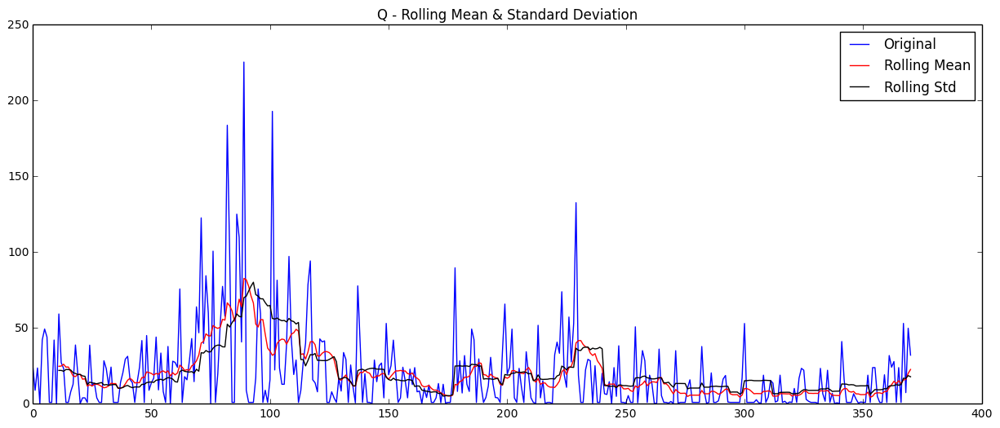

Results of Dickey-Fuller Test:
Test Statistic                  -3.189475
p-value                          0.020602
#Lags Used                       6.000000
Number of Observations Used    364.000000
Critical Value (5%)             -2.869513
Critical Value (1%)             -3.448443
Critical Value (10%)            -2.571018
dtype: float64


In [174]:
_ = map(test_stationarity, splitted_data, data['subCategory'].unique())

### Most categories are not stationary...let's make it stationary!
#### 1) Log it
#### 2) Diff(Log)
#### 3) Season_diff(Diff(Log))

In [175]:
def plot_data(original, trans_2, item, title, label_1, label_2, trans_3=None, label_3=None):
    original.plot(label=' {} '.format(label_1))
    trans_2.plot(label=' {} '.format(label_2))
    if label_3:
        trans_3.plot(label=' {} '.format(label_3))
    plt.legend()
    plt.title(' {} - {} '.format(item, title))
    plt.show(block=False)

In [176]:
def log_data(timeseries, item):
    logged_data = timeseries.apply(lambda x: np.log(x))
    return logged_data

splitted_data_log = list(map(log_data, splitted_data, data['subCategory'].unique()))
print len(splitted_data_log[0])

371


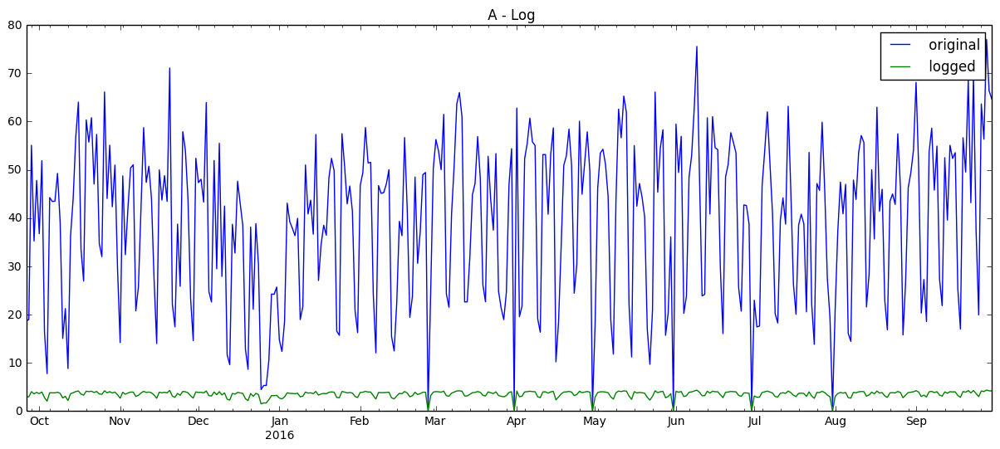

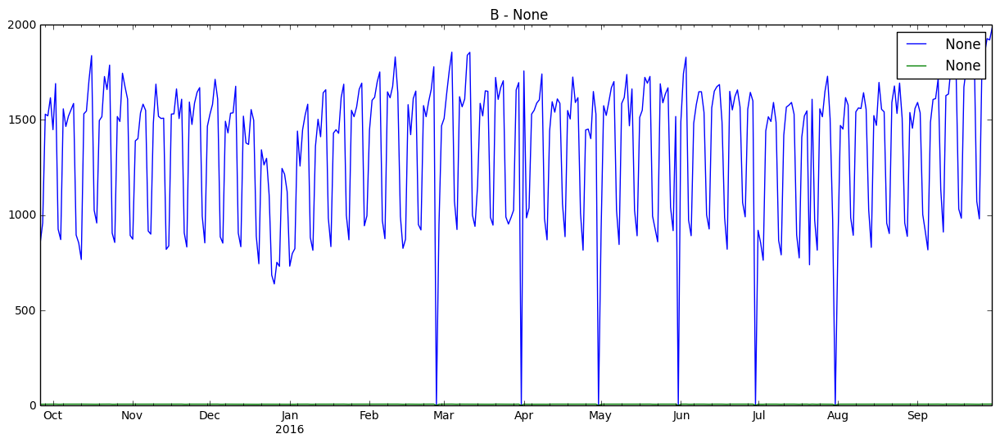

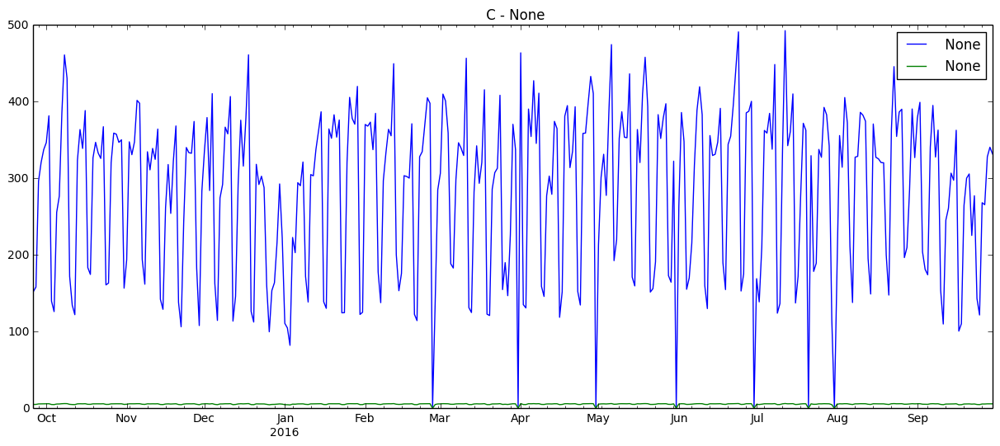

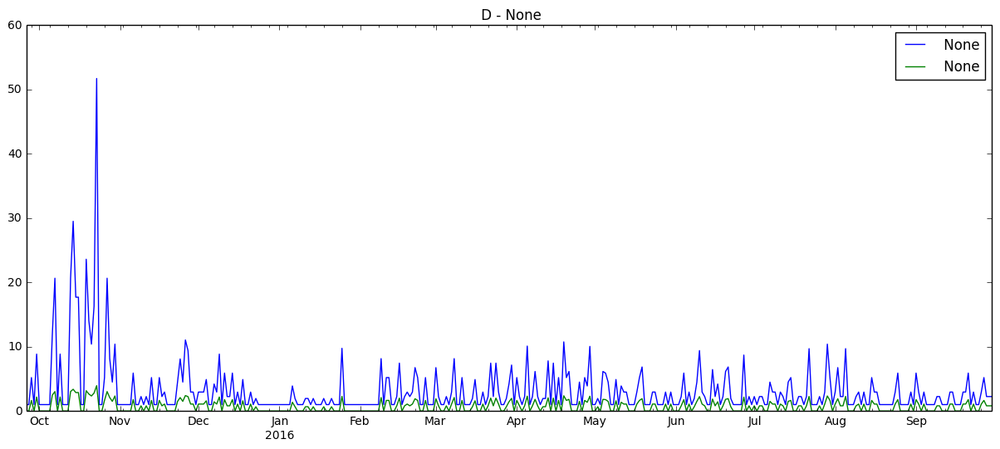

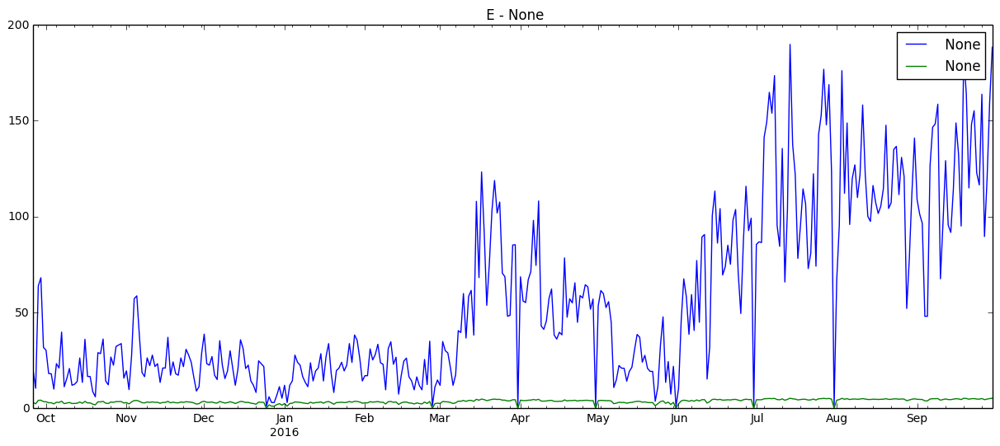

...

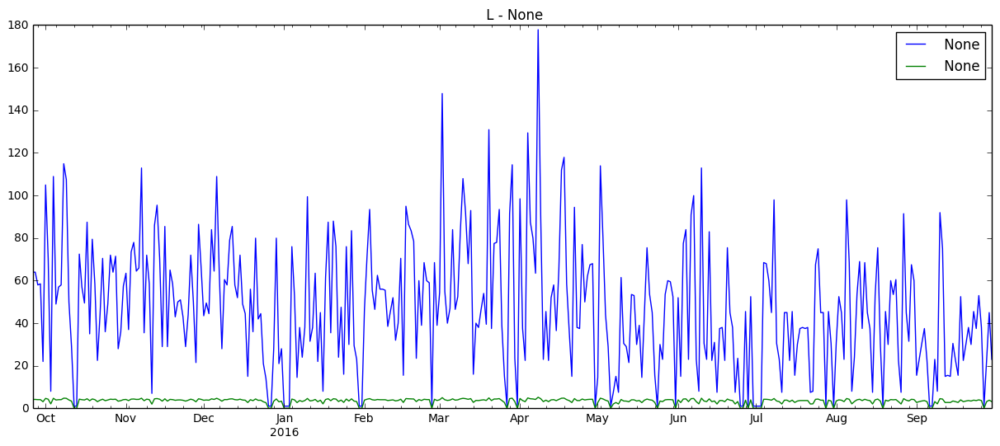

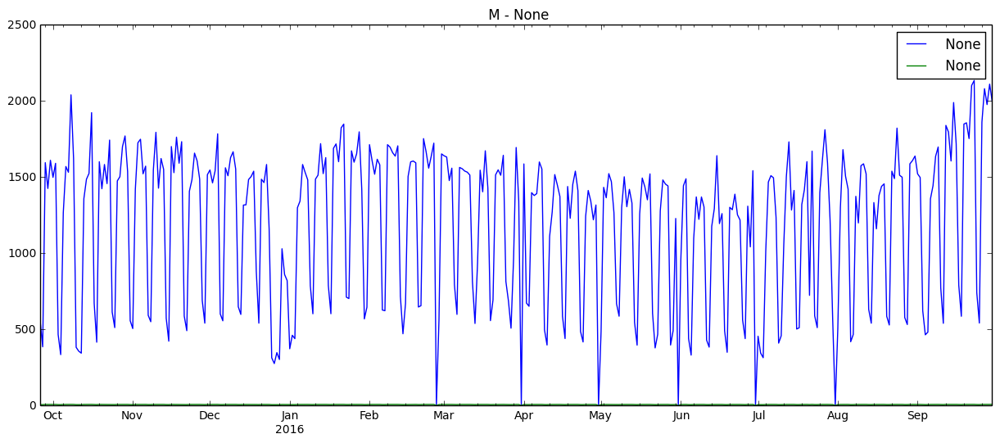

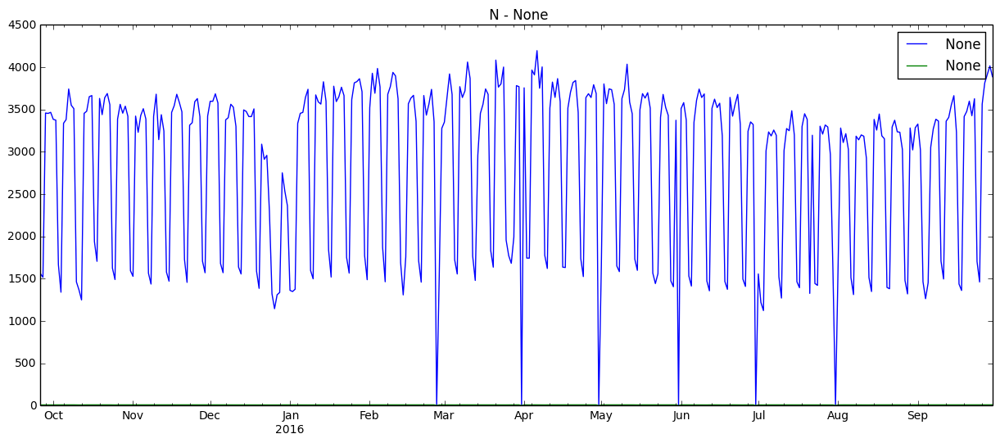

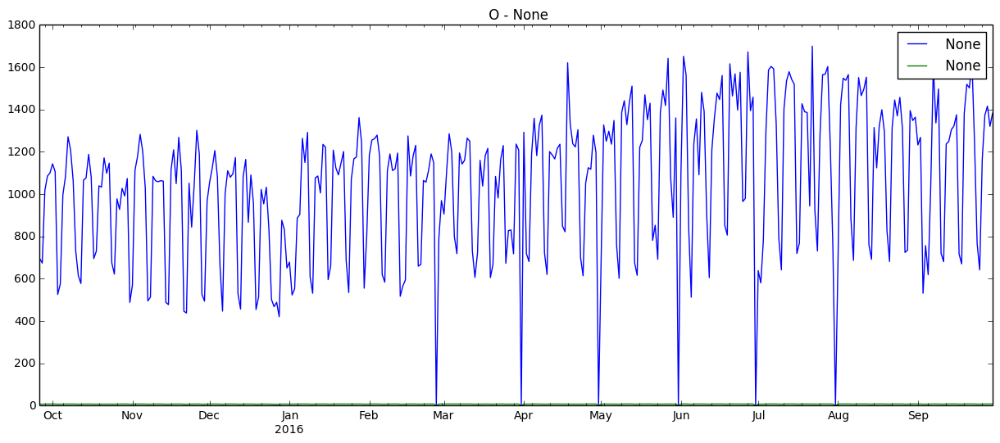

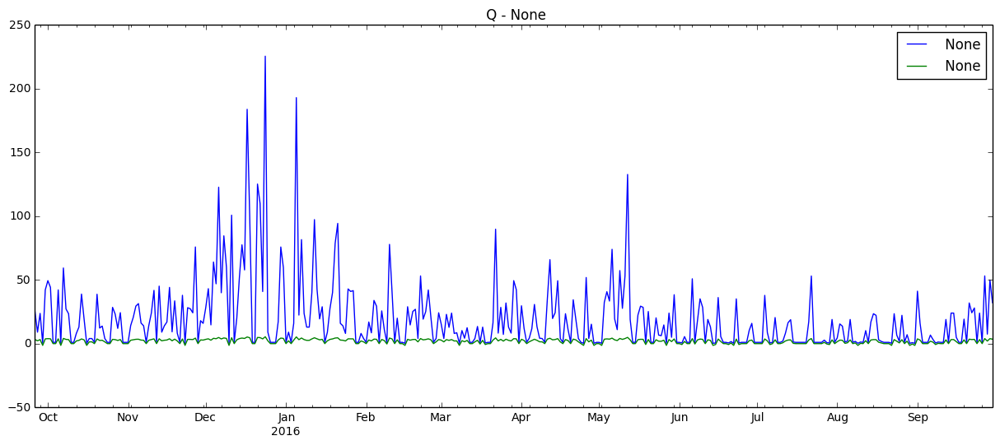

In [177]:
# Let's see the log plot.

_ = map(plot_data, splitted_data, splitted_data_log, data['subCategory'].unique(), ['Log'], ['original'], ['logged'])

In [ ]:
# TODO: Don't need it if we don't fill in missing dates with 0...

# Replace inf, -inf with 0...because after we log(0), we got inf values
replace_inf = lambda x: x.replace([np.inf, -np.inf], 0)
splitted_data_log = map(replace_inf, splitted_data_log)

# Check to see if we've replaced inf values with 0...
print splitted_data_log[15]['2015-12-20']

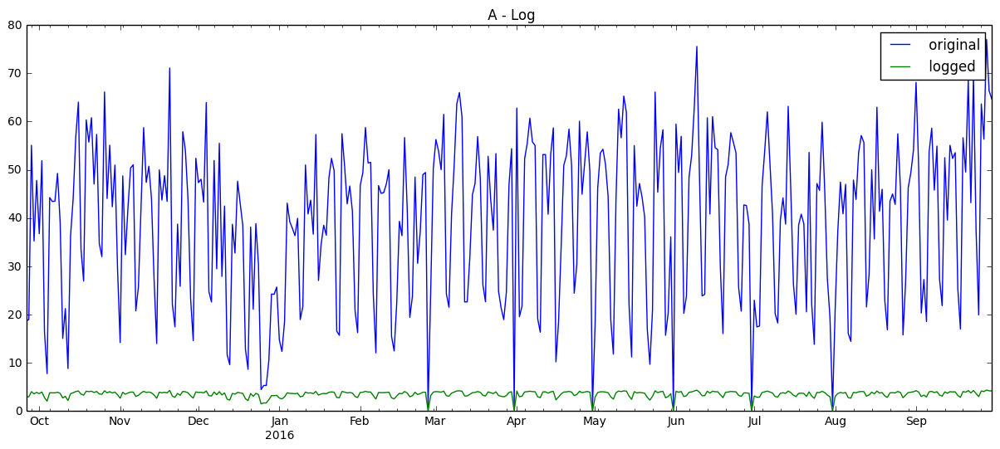

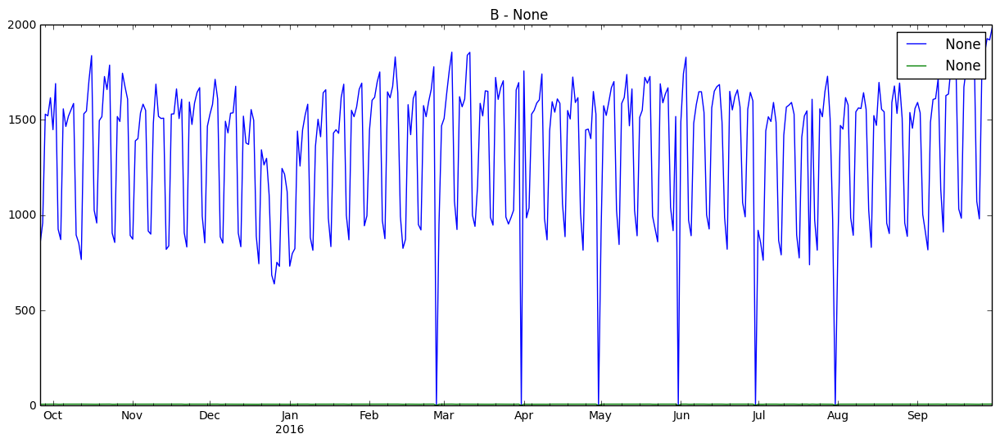

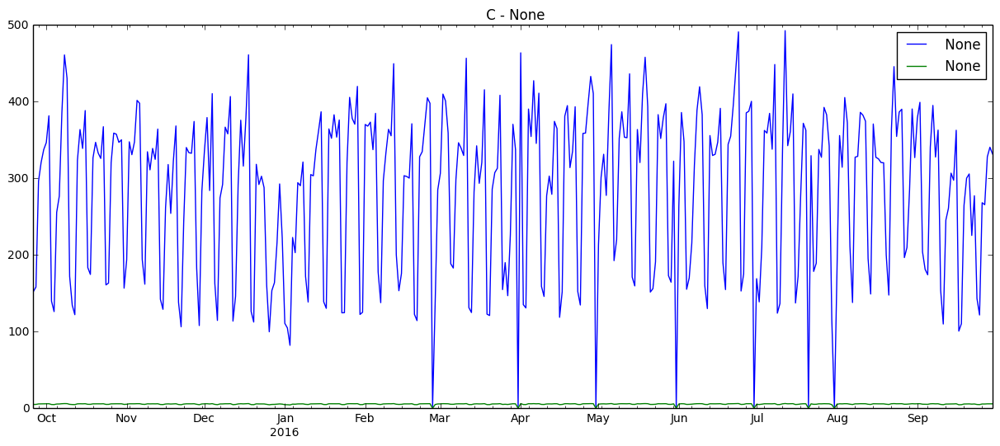

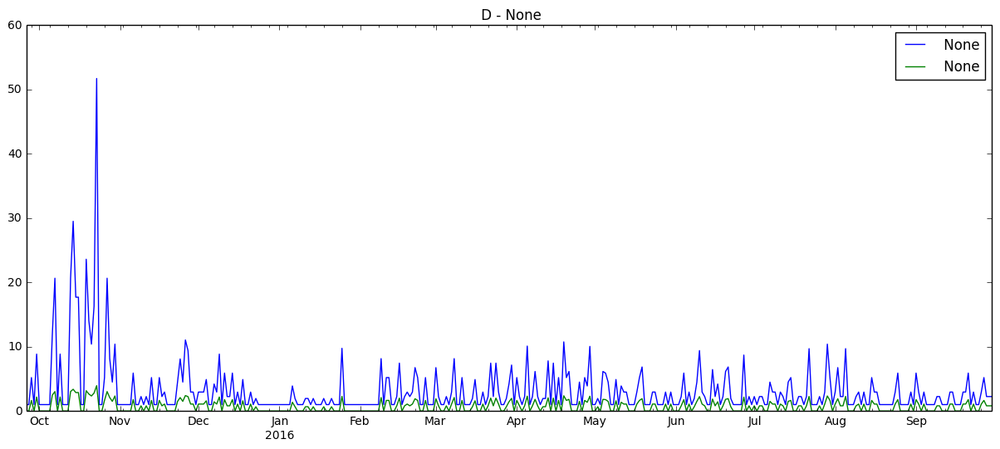

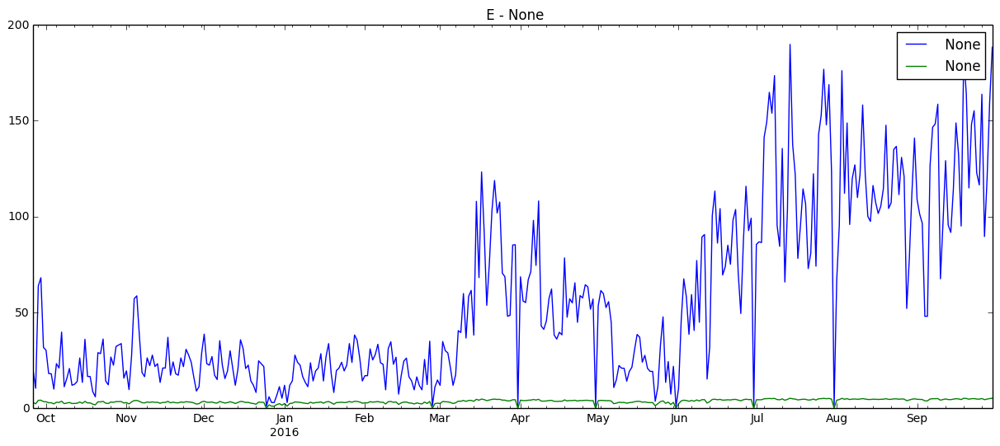

...

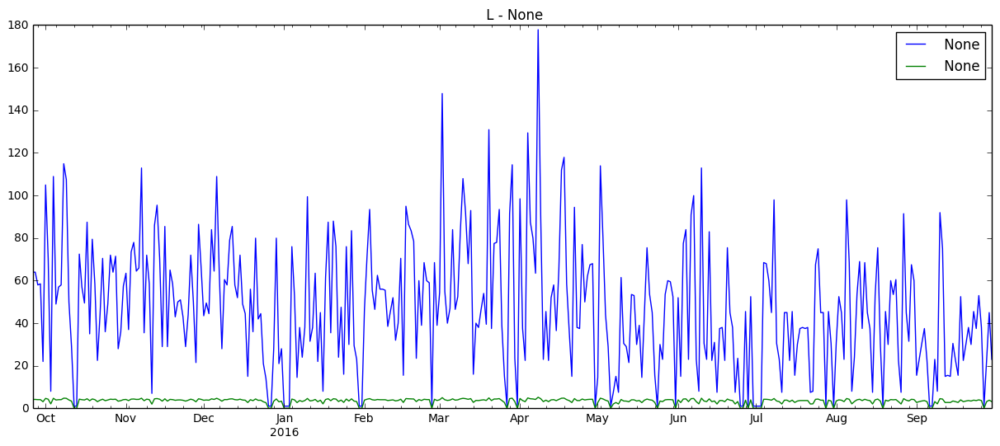

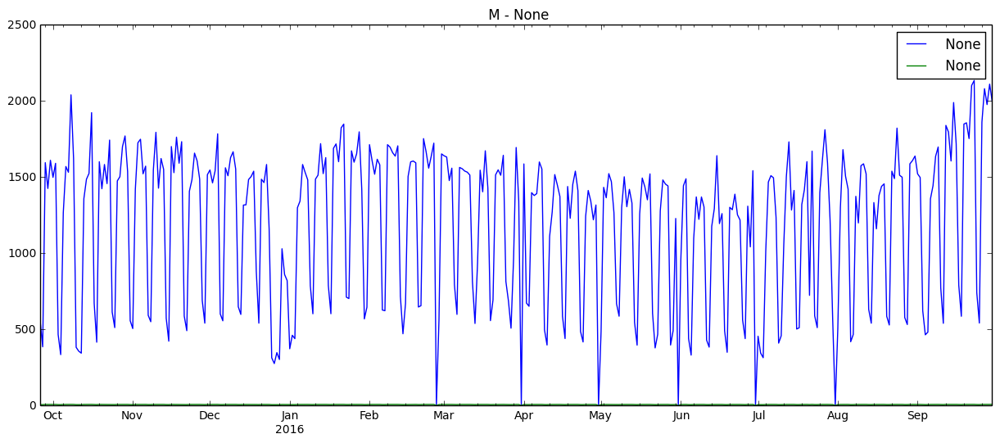

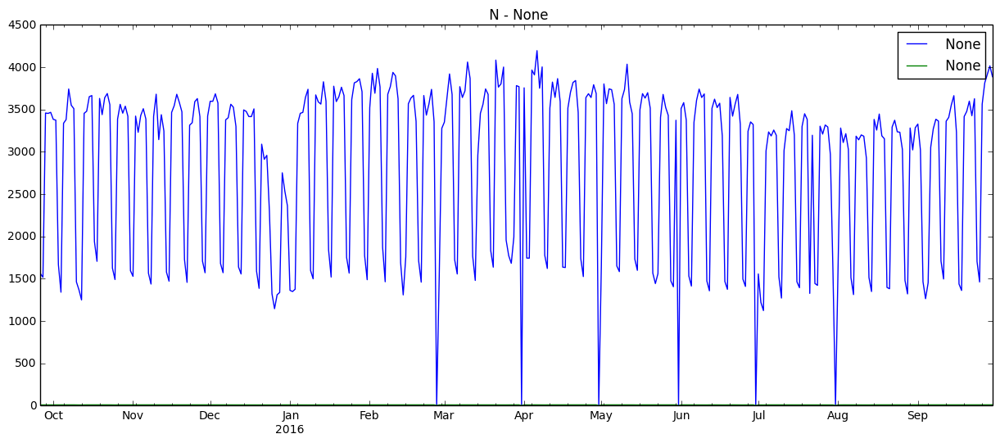

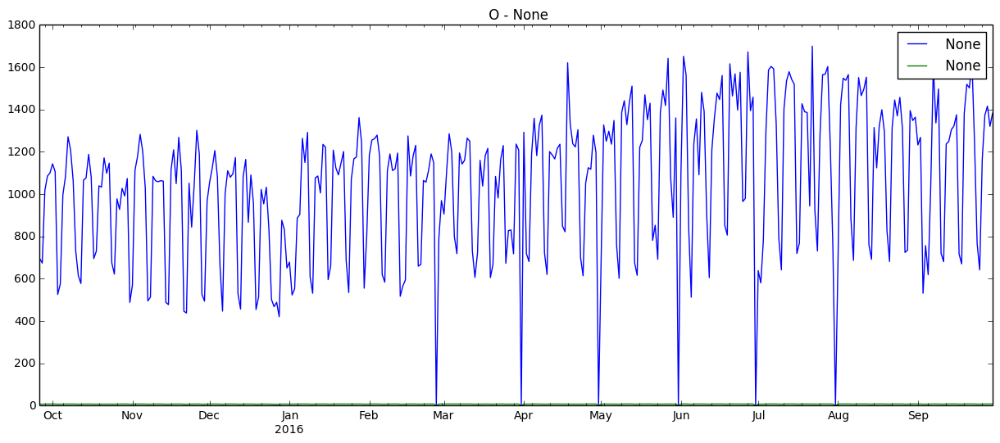

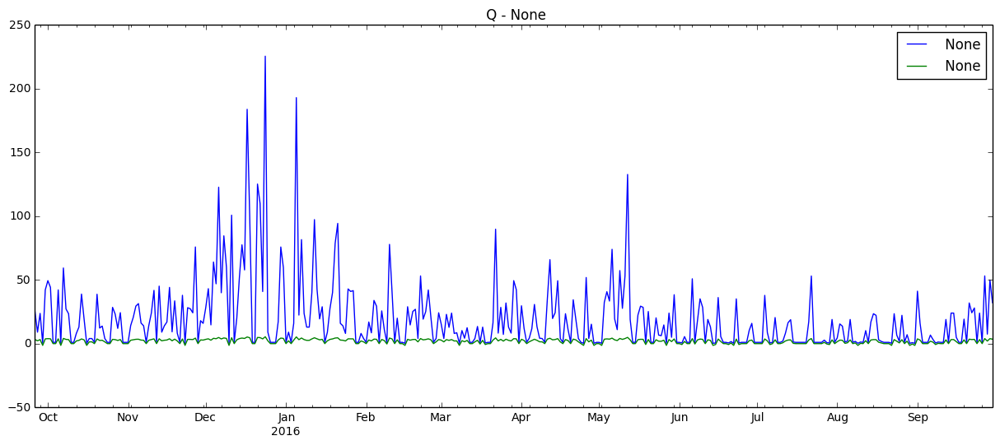

In [178]:
# Plot the log again after we replaced inf, -inf with 0.

_ = map(plot_data, splitted_data, splitted_data_log, temp_list, ['Log'], ['original'], ['logged'])

In [64]:
# Differencing to deal with trend...
# Log first difference

def diff_data(timeseries, item):
    timeseries_diff = timeseries - timeseries.shift()
    return timeseries_diff

splitted_data_log_diff = map(diff_data, splitted_data_log, temp_list)

In [65]:
print splitted_data_log_diff[0].head()

Date_Name
2015-09-26         NaN
2015-09-27    0.013280
2015-09-28    1.067164
2015-09-29   -0.446503
2015-09-30    0.304560
Name: sales, dtype: float64


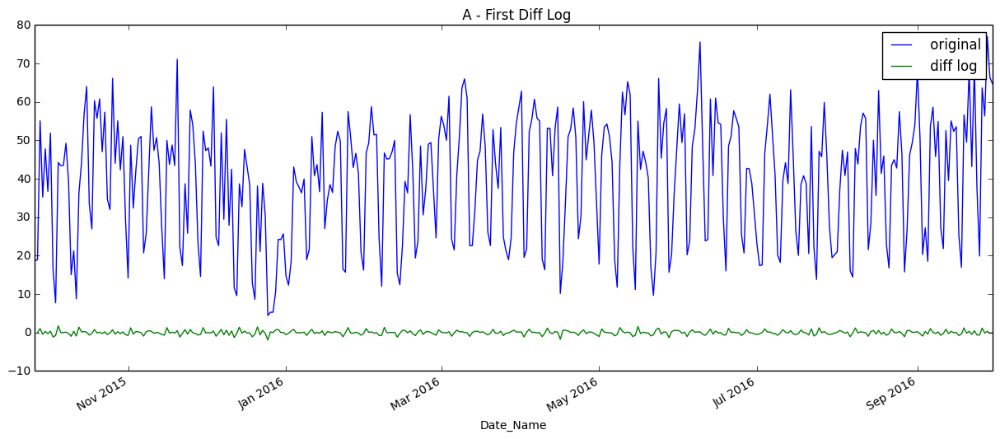

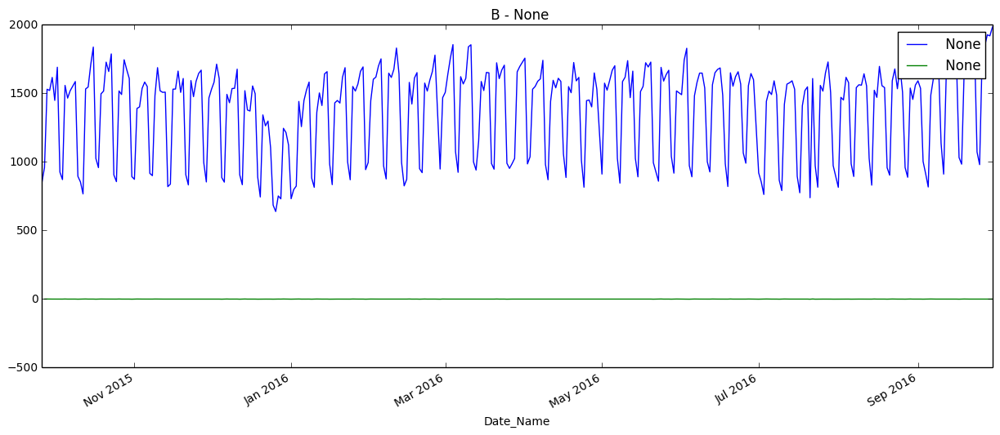

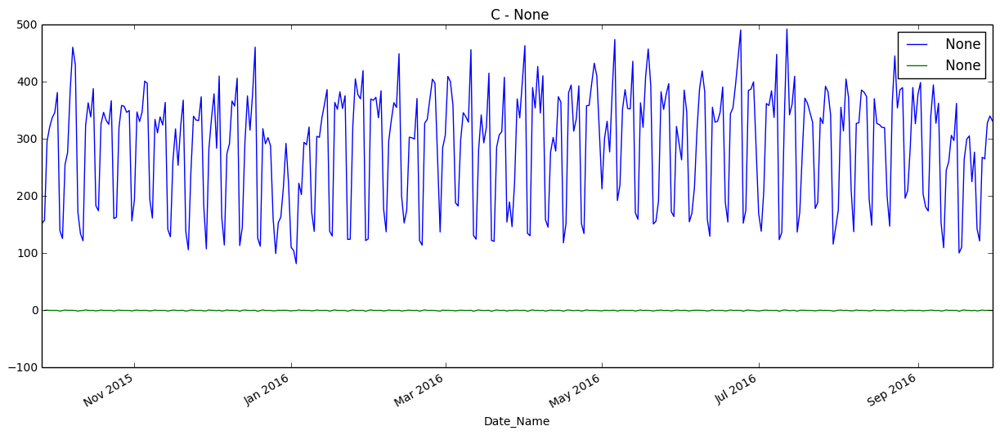

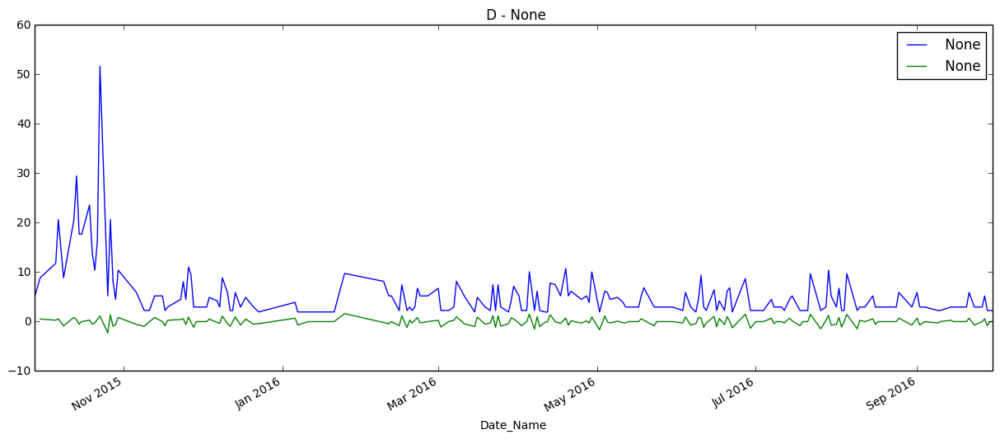

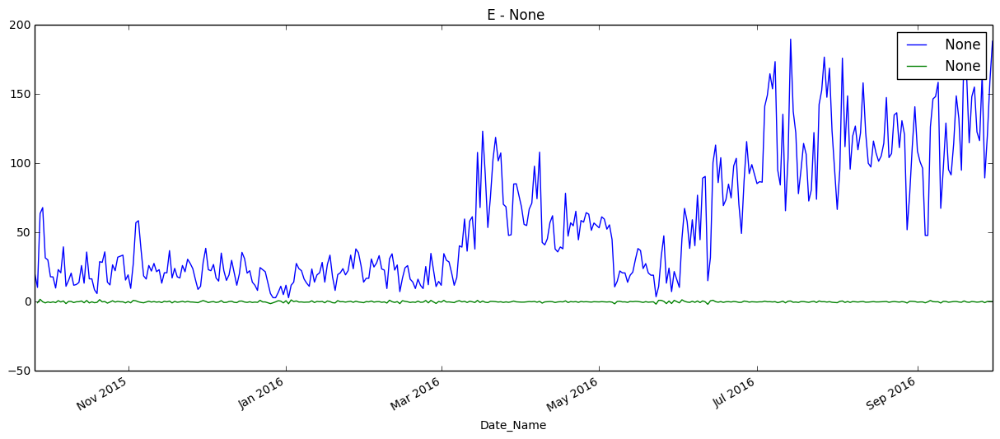

...

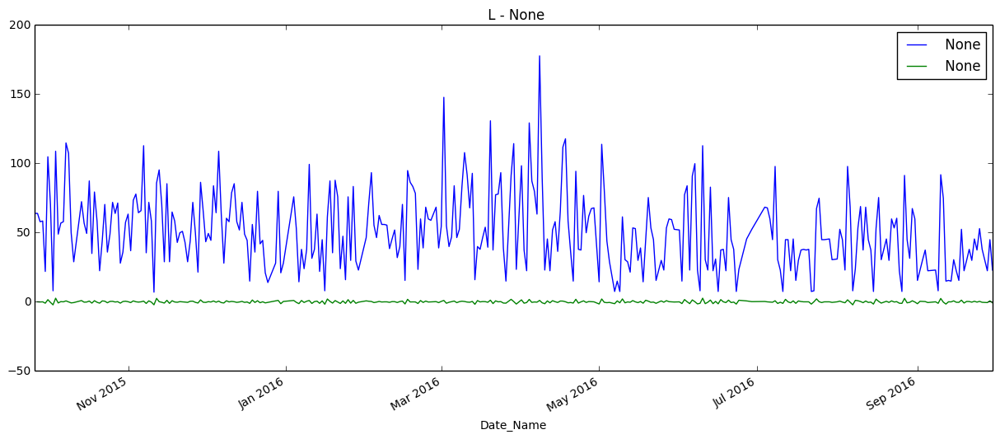

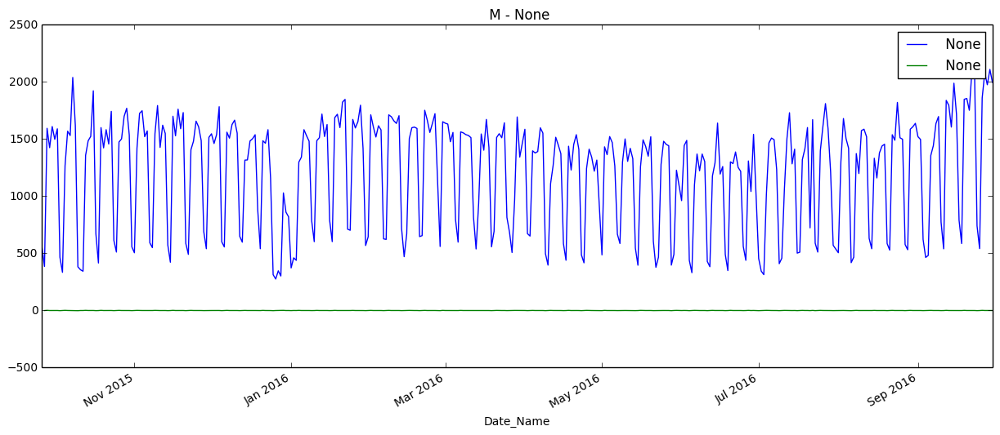

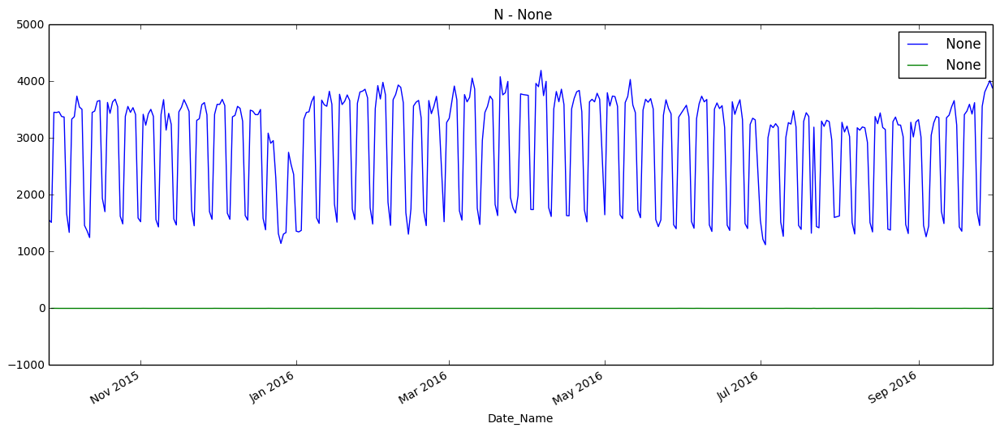

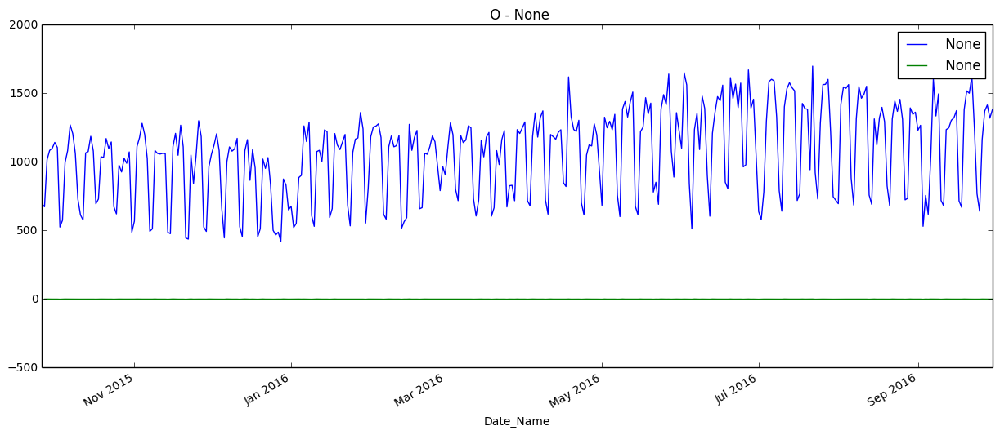

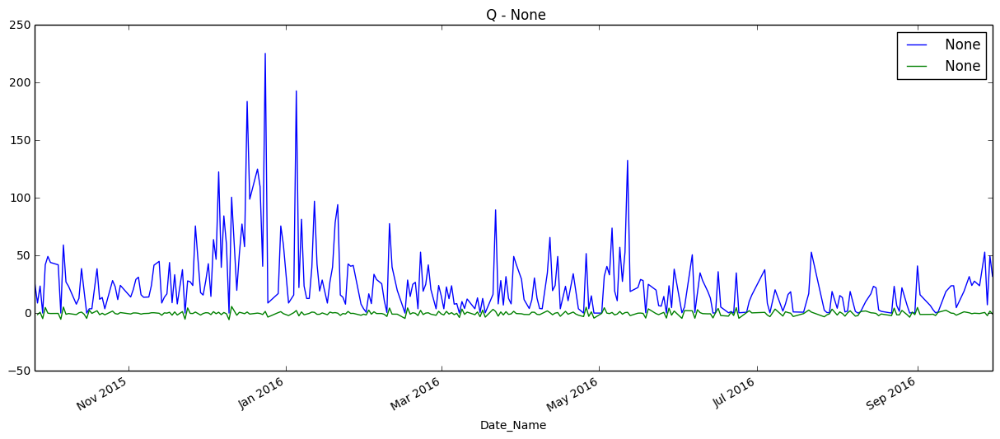

In [66]:
_ = map(plot_data, splitted_data, splitted_data_log_diff, temp_list, ['First Diff Log'], ['original'], ['diff log'])

In [179]:
# Drop the NA values because we took a diff

_ = map(lambda x: x.dropna(inplace=True), splitted_data_log_diff)

/Library/Python/2.7/site-packages/ipykernel/__main__.py:6: FutureWarning: pd.rolling_mean is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=12,center=False).mean()
/Library/Python/2.7/site-packages/ipykernel/__main__.py:7: FutureWarning: pd.rolling_std is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=12,center=False).std()


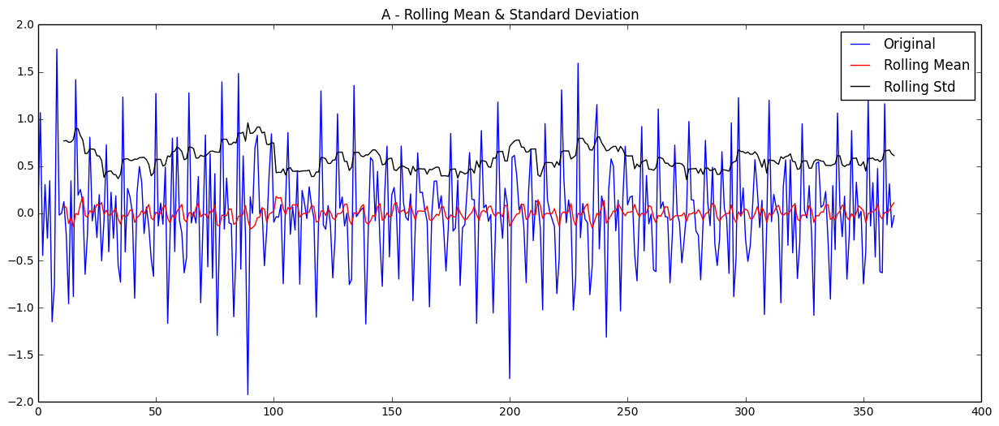

Results of Dickey-Fuller Test:
Test Statistic                -6.863140e+00
p-value                        1.583637e-09
#Lags Used                     1.300000e+01
Number of Observations Used    3.500000e+02
Critical Value (5%)           -2.869833e+00
Critical Value (1%)           -3.449173e+00
Critical Value (10%)          -2.571188e+00
dtype: float64


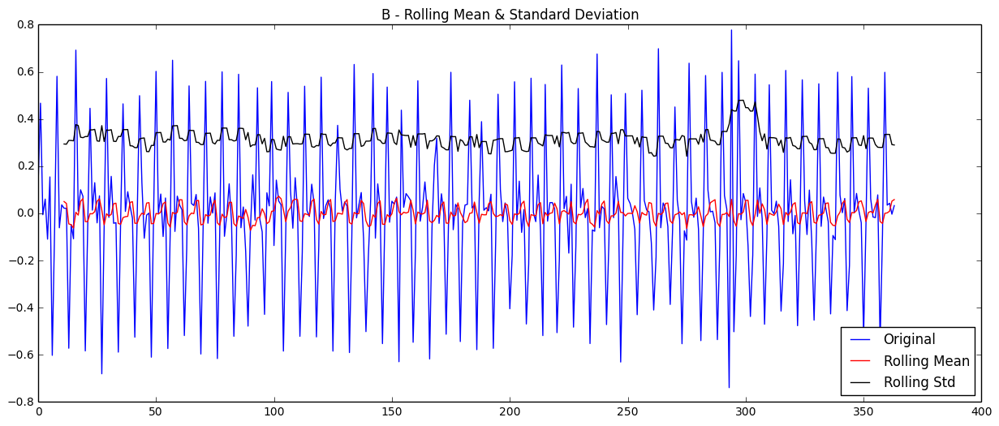

Results of Dickey-Fuller Test:
Test Statistic                -8.537651e+00
p-value                        9.978931e-14
#Lags Used                     1.200000e+01
Number of Observations Used    3.510000e+02
Critical Value (5%)           -2.869810e+00
Critical Value (1%)           -3.449119e+00
Critical Value (10%)          -2.571176e+00
dtype: float64


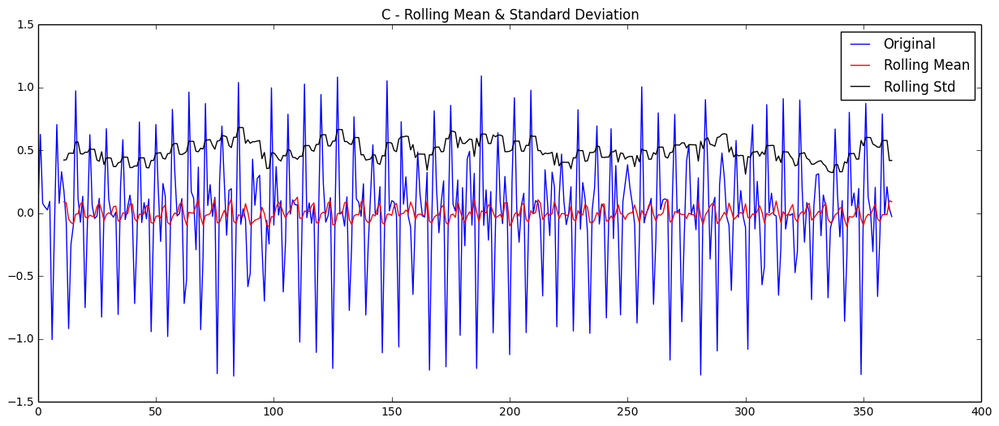

Results of Dickey-Fuller Test:
Test Statistic                -8.162628e+00
p-value                        9.057535e-13
#Lags Used                     1.100000e+01
Number of Observations Used    3.510000e+02
Critical Value (5%)           -2.869810e+00
Critical Value (1%)           -3.449119e+00
Critical Value (10%)          -2.571176e+00
dtype: float64


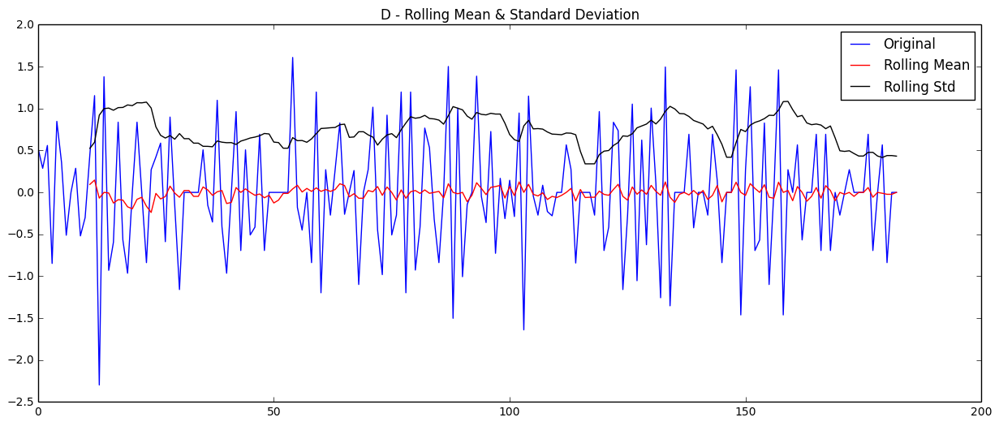

Results of Dickey-Fuller Test:
Test Statistic                -7.444608e+00
p-value                        5.883143e-11
#Lags Used                     8.000000e+00
Number of Observations Used    1.740000e+02
Critical Value (5%)           -2.878298e+00
Critical Value (1%)           -3.468502e+00
Critical Value (10%)          -2.575704e+00
dtype: float64


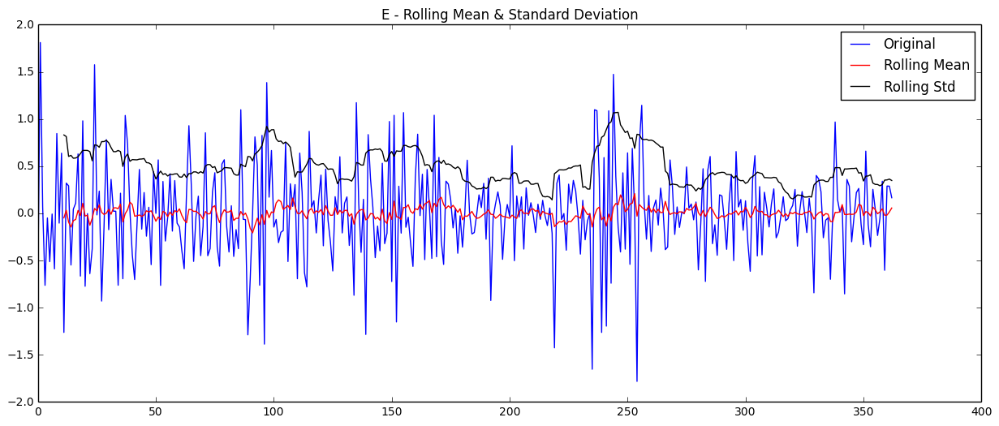

Results of Dickey-Fuller Test:
Test Statistic                -7.696122e+00
p-value                        1.377857e-11
#Lags Used                     9.000000e+00
Number of Observations Used    3.530000e+02
Critical Value (5%)           -2.869763e+00
Critical Value (1%)           -3.449011e+00
Critical Value (10%)          -2.571151e+00
dtype: float64


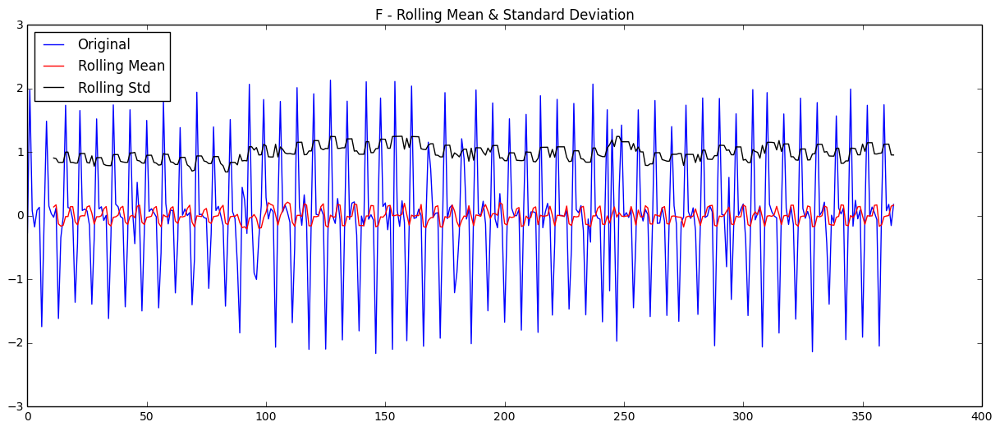

Results of Dickey-Fuller Test:
Test Statistic                -7.695750e+00
p-value                        1.380829e-11
#Lags Used                     1.200000e+01
Number of Observations Used    3.510000e+02
Critical Value (5%)           -2.869810e+00
Critical Value (1%)           -3.449119e+00
Critical Value (10%)          -2.571176e+00
dtype: float64


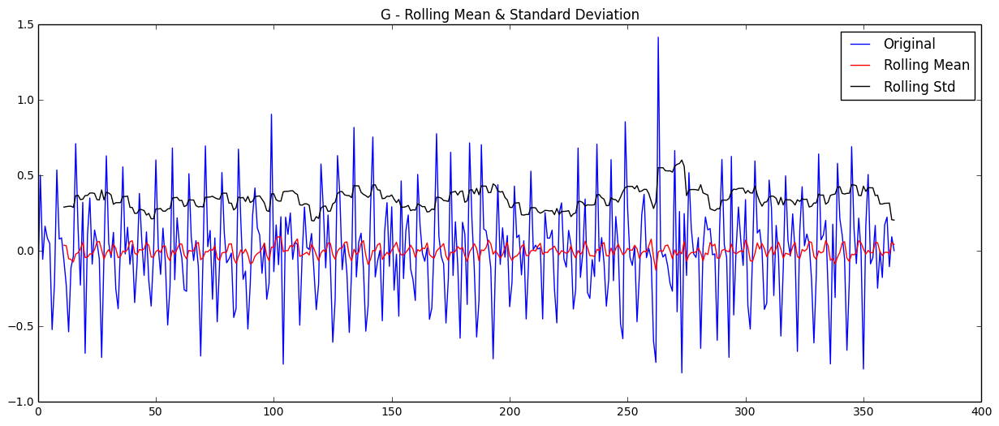

Results of Dickey-Fuller Test:
Test Statistic                -1.013580e+01
p-value                        8.676256e-18
#Lags Used                     1.200000e+01
Number of Observations Used    3.510000e+02
Critical Value (5%)           -2.869810e+00
Critical Value (1%)           -3.449119e+00
Critical Value (10%)          -2.571176e+00
dtype: float64


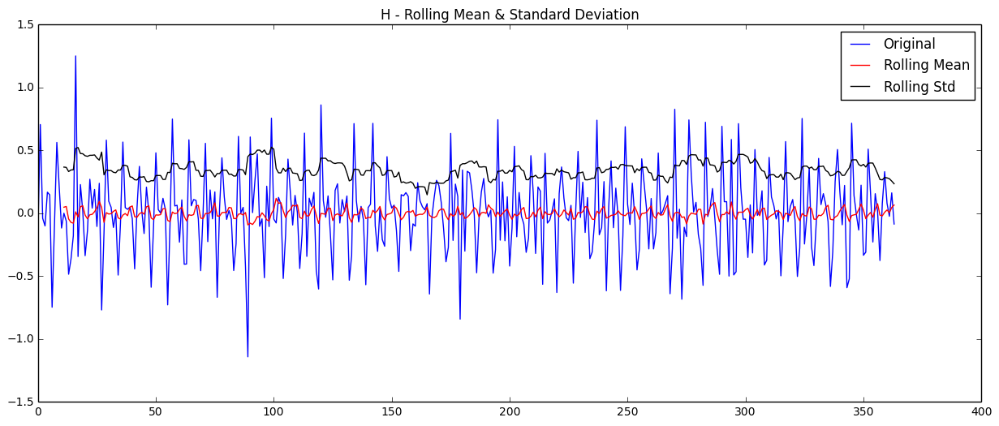

Results of Dickey-Fuller Test:
Test Statistic                -7.425191e+00
p-value                        6.576906e-11
#Lags Used                     1.300000e+01
Number of Observations Used    3.500000e+02
Critical Value (5%)           -2.869833e+00
Critical Value (1%)           -3.449173e+00
Critical Value (10%)          -2.571188e+00
dtype: float64


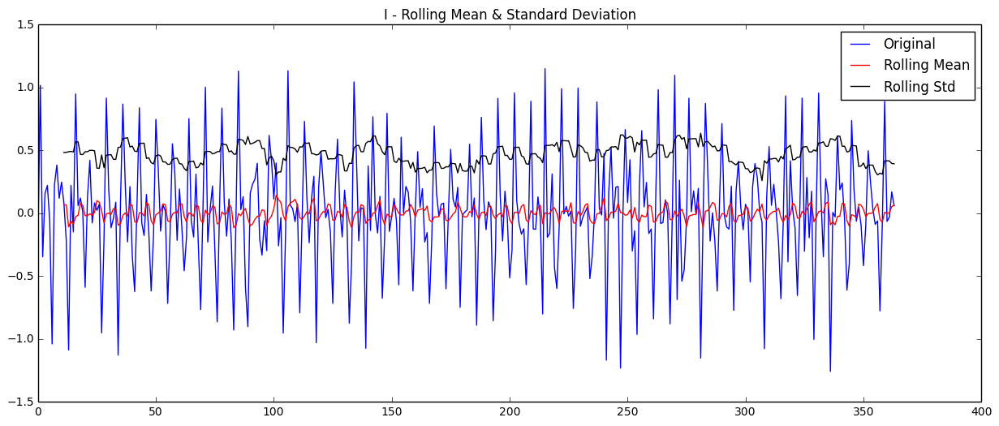

Results of Dickey-Fuller Test:
Test Statistic                -8.726007e+00
p-value                        3.287309e-14
#Lags Used                     1.200000e+01
Number of Observations Used    3.510000e+02
Critical Value (5%)           -2.869810e+00
Critical Value (1%)           -3.449119e+00
Critical Value (10%)          -2.571176e+00
dtype: float64


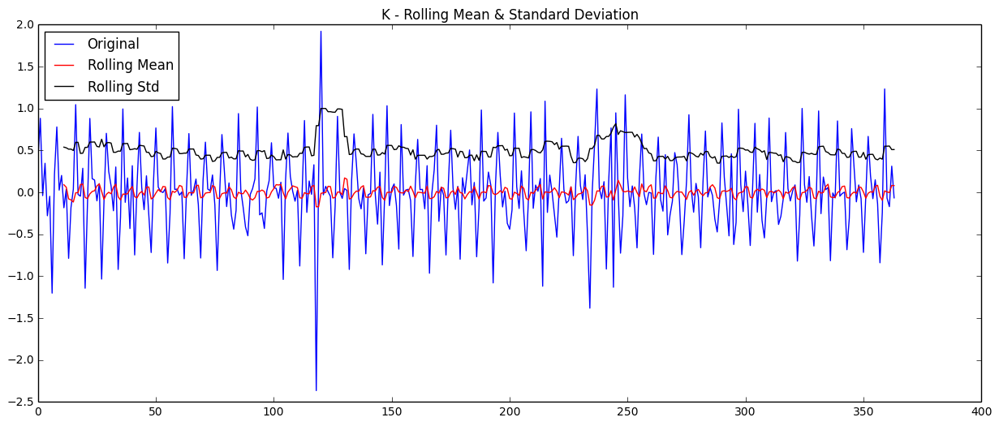

Results of Dickey-Fuller Test:
Test Statistic                -7.787972e+00
p-value                        8.083684e-12
#Lags Used                     1.300000e+01
Number of Observations Used    3.500000e+02
Critical Value (5%)           -2.869833e+00
Critical Value (1%)           -3.449173e+00
Critical Value (10%)          -2.571188e+00
dtype: float64


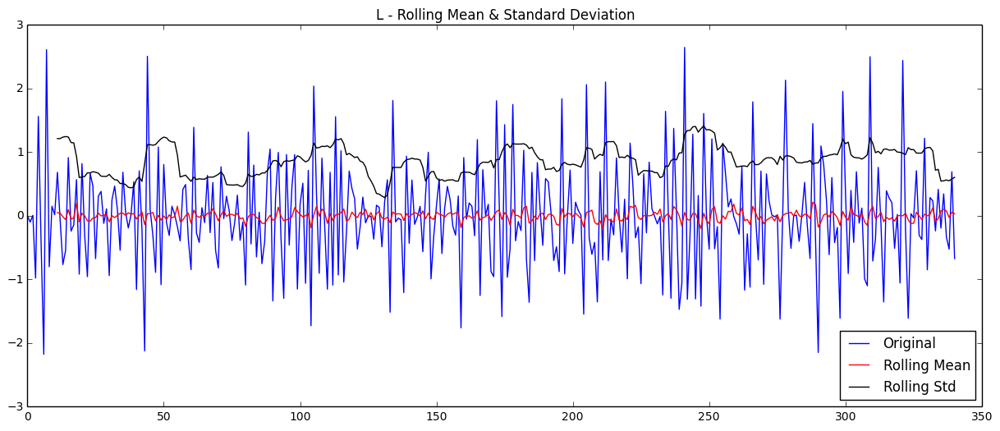

Results of Dickey-Fuller Test:
Test Statistic                -1.053562e+01
p-value                        8.917345e-19
#Lags Used                     9.000000e+00
Number of Observations Used    3.310000e+02
Critical Value (5%)           -2.870312e+00
Critical Value (1%)           -3.450262e+00
Critical Value (10%)          -2.571443e+00
dtype: float64


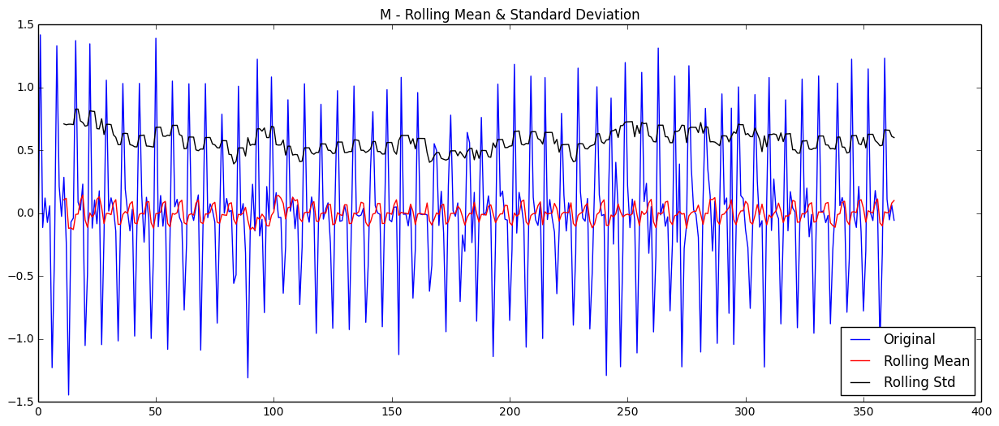

Results of Dickey-Fuller Test:
Test Statistic                -8.336654e+00
p-value                        3.258660e-13
#Lags Used                     1.200000e+01
Number of Observations Used    3.510000e+02
Critical Value (5%)           -2.869810e+00
Critical Value (1%)           -3.449119e+00
Critical Value (10%)          -2.571176e+00
dtype: float64


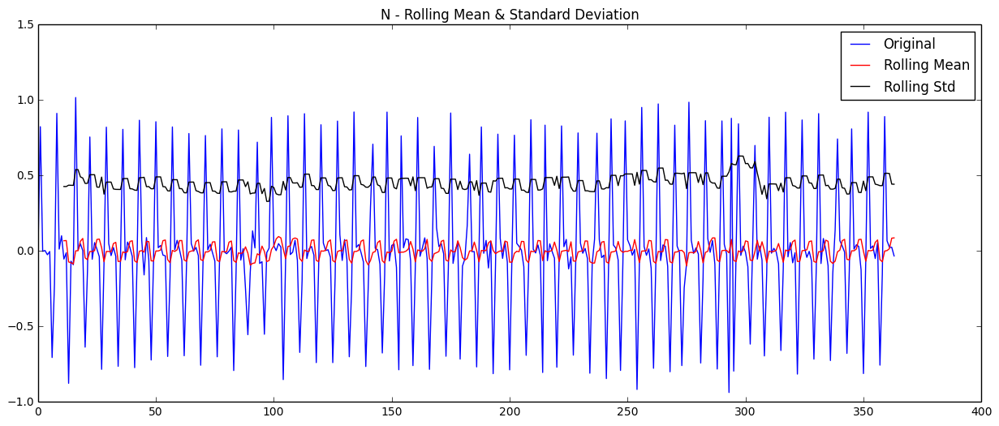

Results of Dickey-Fuller Test:
Test Statistic                -8.739081e+00
p-value                        3.043388e-14
#Lags Used                     1.200000e+01
Number of Observations Used    3.510000e+02
Critical Value (5%)           -2.869810e+00
Critical Value (1%)           -3.449119e+00
Critical Value (10%)          -2.571176e+00
dtype: float64


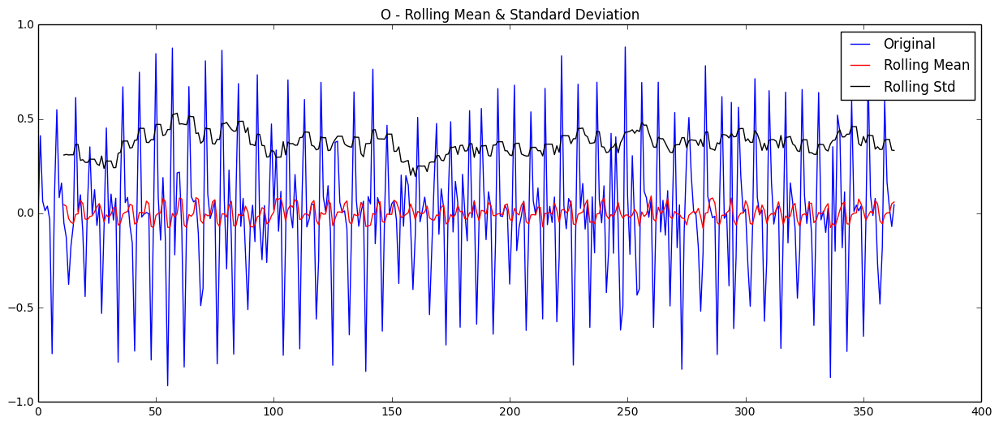

Results of Dickey-Fuller Test:
Test Statistic                -7.515690e+00
p-value                        3.908894e-11
#Lags Used                     1.300000e+01
Number of Observations Used    3.500000e+02
Critical Value (5%)           -2.869833e+00
Critical Value (1%)           -3.449173e+00
Critical Value (10%)          -2.571188e+00
dtype: float64


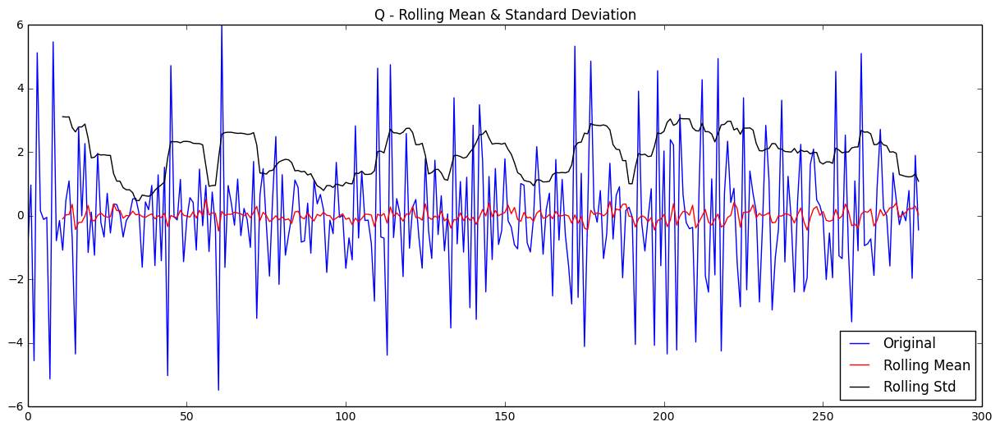

Results of Dickey-Fuller Test:
Test Statistic                -1.096098e+01
p-value                        8.328072e-20
#Lags Used                     6.000000e+00
Number of Observations Used    2.740000e+02
Critical Value (5%)           -2.872147e+00
Critical Value (1%)           -3.454444e+00
Critical Value (10%)          -2.572422e+00
dtype: float64


In [180]:
# Let's see the Dickey-Fuller test after taking the diff(1)...
_ = map(test_stationarity, splitted_data_log_diff, temp_list)

### - Looks good! Mostly becomes stationary...
### - Now let's deal with seasonality

In [181]:
# Differencing to deal with seasonality...
# Log seasonal difference

splitted_data_log_diff_season = map(lambda x: x - x.shift(7), splitted_data_log_diff)
_ = map(lambda x: x.dropna(inplace=True), splitted_data_log_diff_season) # Drop NA as usual

/Library/Python/2.7/site-packages/ipykernel/__main__.py:6: FutureWarning: pd.rolling_mean is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=12,center=False).mean()
/Library/Python/2.7/site-packages/ipykernel/__main__.py:7: FutureWarning: pd.rolling_std is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=12,center=False).std()


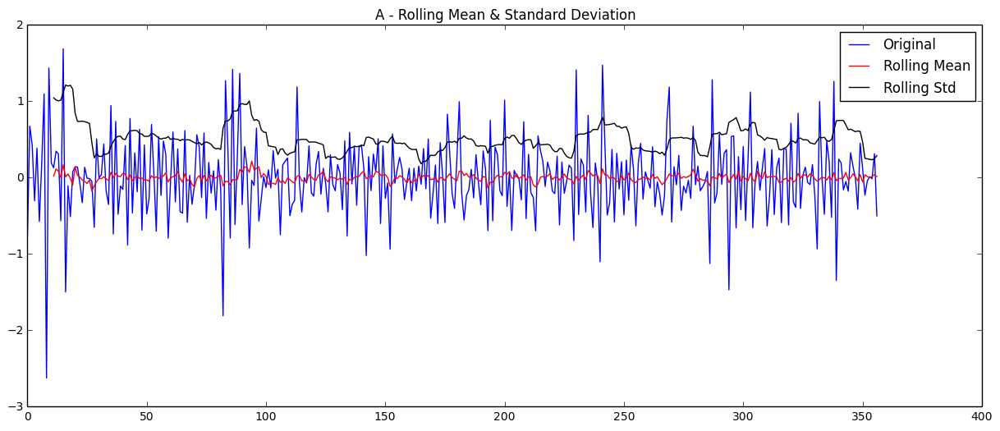

Results of Dickey-Fuller Test:
Test Statistic                -8.858322e+00
p-value                        1.506619e-14
#Lags Used                     1.500000e+01
Number of Observations Used    3.410000e+02
Critical Value (5%)           -2.870053e+00
Critical Value (1%)           -3.449673e+00
Critical Value (10%)          -2.571306e+00
dtype: float64


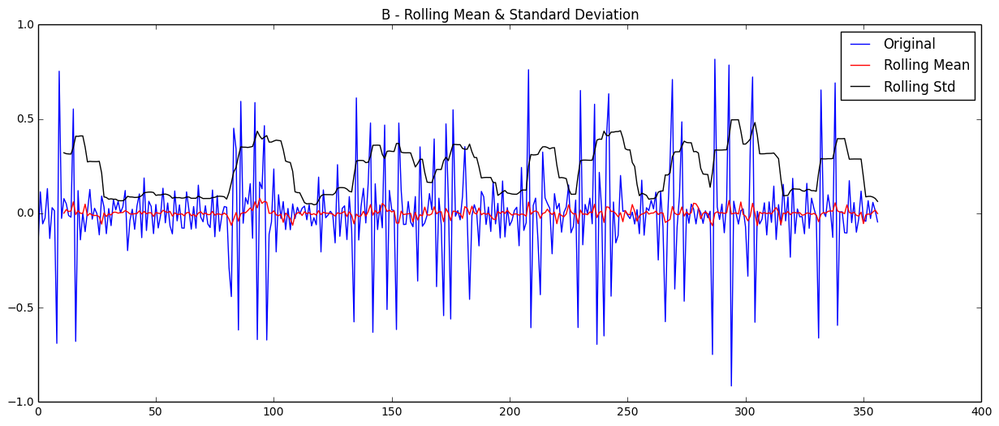

Results of Dickey-Fuller Test:
Test Statistic                -8.554687e+00
p-value                        9.025752e-14
#Lags Used                     1.300000e+01
Number of Observations Used    3.430000e+02
Critical Value (5%)           -2.870004e+00
Critical Value (1%)           -3.449560e+00
Critical Value (10%)          -2.571279e+00
dtype: float64


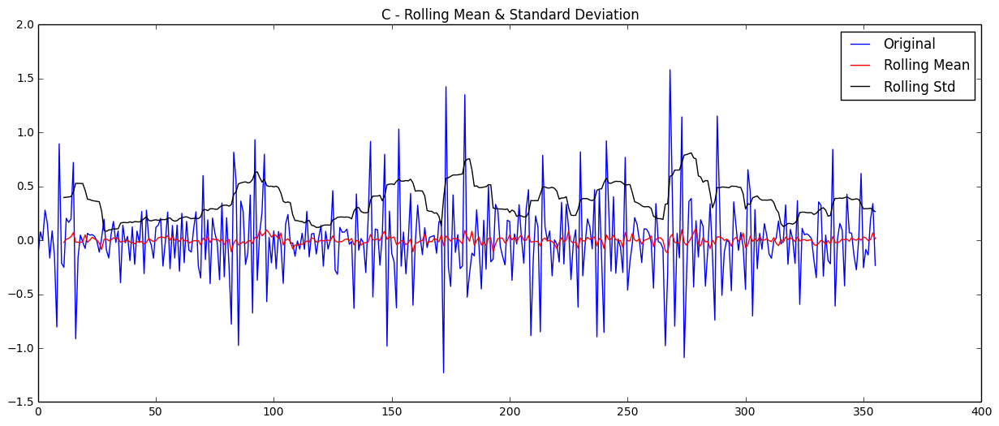

Results of Dickey-Fuller Test:
Test Statistic                -7.373256e+00
p-value                        8.857501e-11
#Lags Used                     1.200000e+01
Number of Observations Used    3.430000e+02
Critical Value (5%)           -2.870004e+00
Critical Value (1%)           -3.449560e+00
Critical Value (10%)          -2.571279e+00
dtype: float64


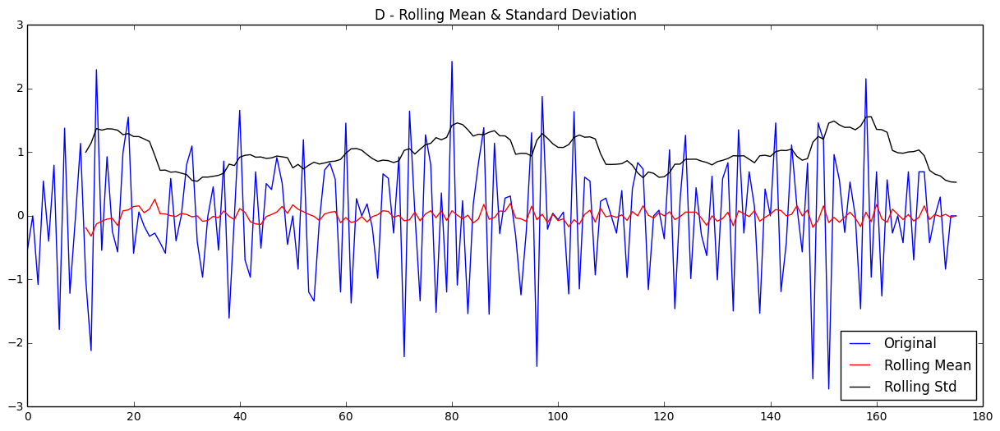

Results of Dickey-Fuller Test:
Test Statistic                -6.307661e+00
p-value                        3.293114e-08
#Lags Used                     1.400000e+01
Number of Observations Used    1.610000e+02
Critical Value (5%)           -2.879665e+00
Critical Value (1%)           -3.471633e+00
Critical Value (10%)          -2.576434e+00
dtype: float64


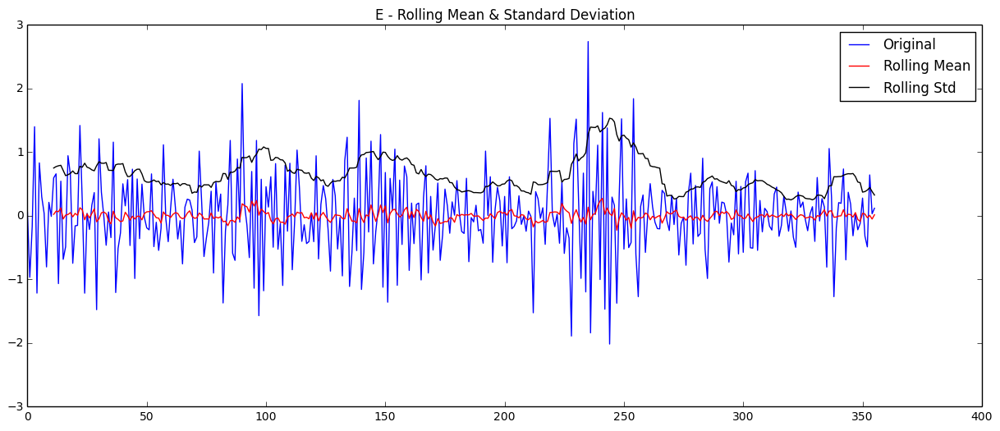

Results of Dickey-Fuller Test:
Test Statistic                -8.357946e+00
p-value                        2.875032e-13
#Lags Used                     1.700000e+01
Number of Observations Used    3.380000e+02
Critical Value (5%)           -2.870129e+00
Critical Value (1%)           -3.449846e+00
Critical Value (10%)          -2.571346e+00
dtype: float64


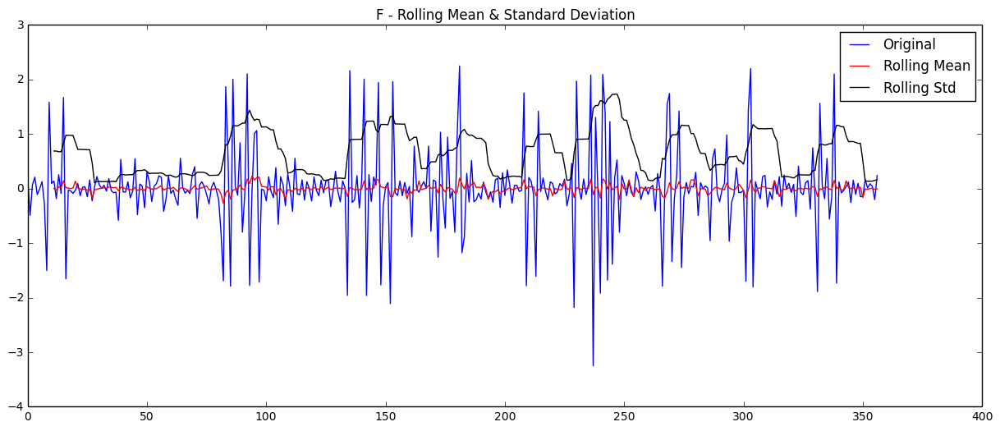

Results of Dickey-Fuller Test:
Test Statistic                -8.231005e+00
p-value                        6.063309e-13
#Lags Used                     1.600000e+01
Number of Observations Used    3.400000e+02
Critical Value (5%)           -2.870079e+00
Critical Value (1%)           -3.449730e+00
Critical Value (10%)          -2.571319e+00
dtype: float64


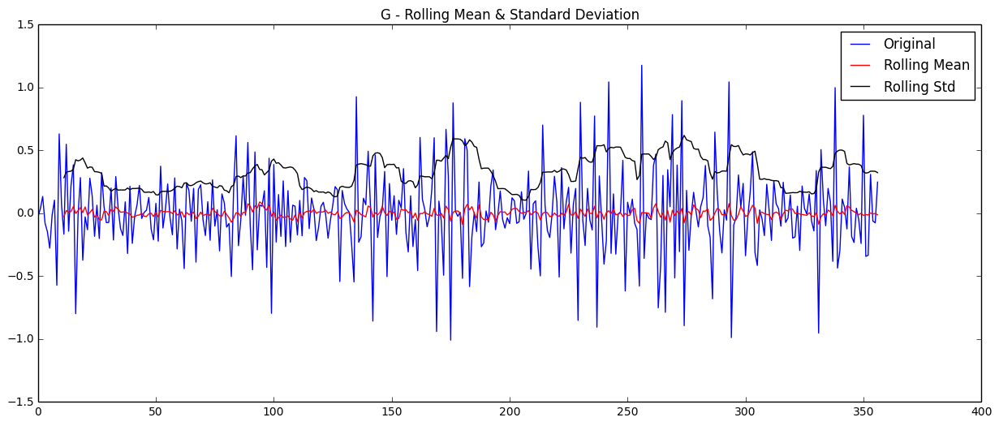

Results of Dickey-Fuller Test:
Test Statistic                -7.952150e+00
p-value                        3.105286e-12
#Lags Used                     1.600000e+01
Number of Observations Used    3.400000e+02
Critical Value (5%)           -2.870079e+00
Critical Value (1%)           -3.449730e+00
Critical Value (10%)          -2.571319e+00
dtype: float64


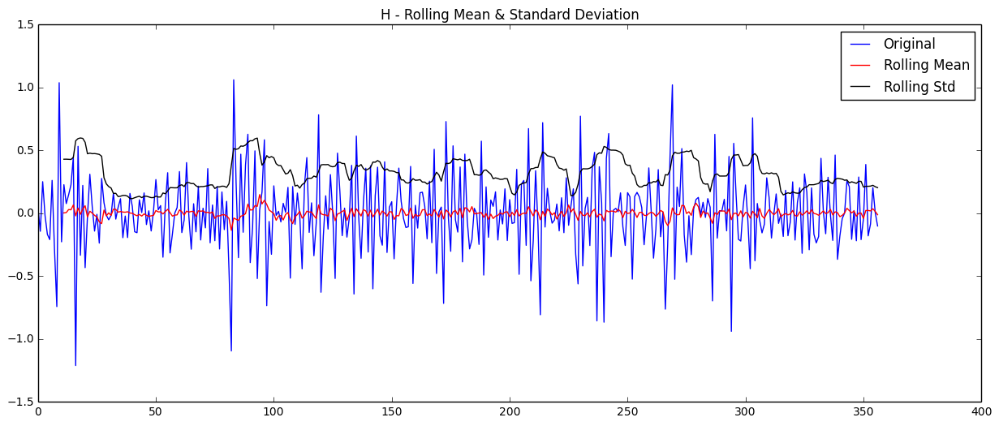

Results of Dickey-Fuller Test:
Test Statistic                -8.024348e+00
p-value                        2.036239e-12
#Lags Used                     1.500000e+01
Number of Observations Used    3.410000e+02
Critical Value (5%)           -2.870053e+00
Critical Value (1%)           -3.449673e+00
Critical Value (10%)          -2.571306e+00
dtype: float64


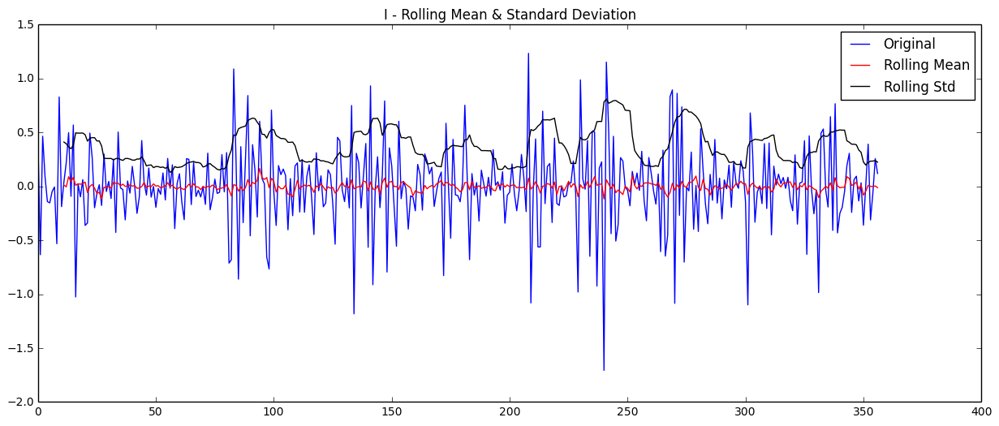

Results of Dickey-Fuller Test:
Test Statistic                -8.794587e+00
p-value                        2.193876e-14
#Lags Used                     1.500000e+01
Number of Observations Used    3.410000e+02
Critical Value (5%)           -2.870053e+00
Critical Value (1%)           -3.449673e+00
Critical Value (10%)          -2.571306e+00
dtype: float64


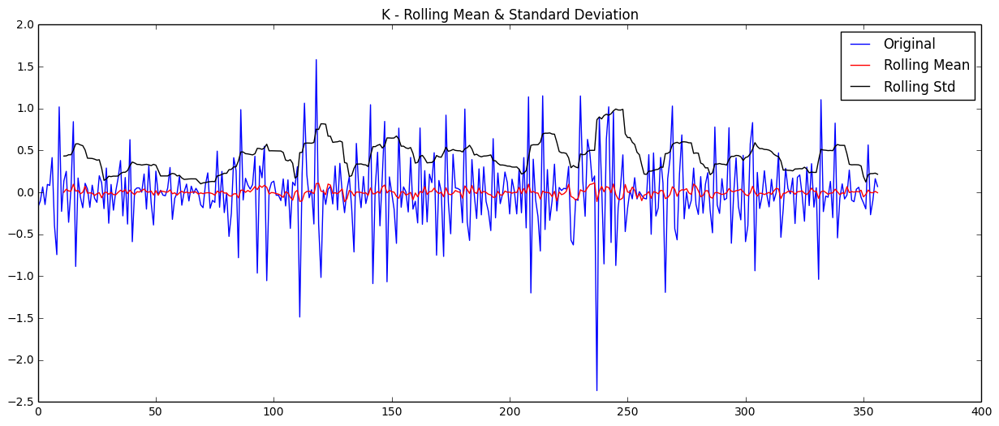

Results of Dickey-Fuller Test:
Test Statistic                -7.824251e+00
p-value                        6.545693e-12
#Lags Used                     1.500000e+01
Number of Observations Used    3.410000e+02
Critical Value (5%)           -2.870053e+00
Critical Value (1%)           -3.449673e+00
Critical Value (10%)          -2.571306e+00
dtype: float64


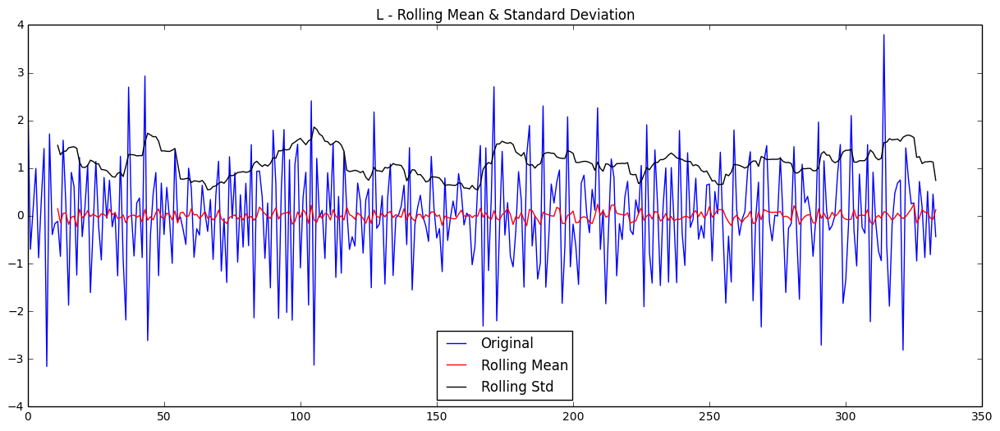

Results of Dickey-Fuller Test:
Test Statistic                -8.584118e+00
p-value                        7.588369e-14
#Lags Used                     1.500000e+01
Number of Observations Used    3.180000e+02
Critical Value (5%)           -2.870672e+00
Critical Value (1%)           -3.451082e+00
Critical Value (10%)          -2.571636e+00
dtype: float64


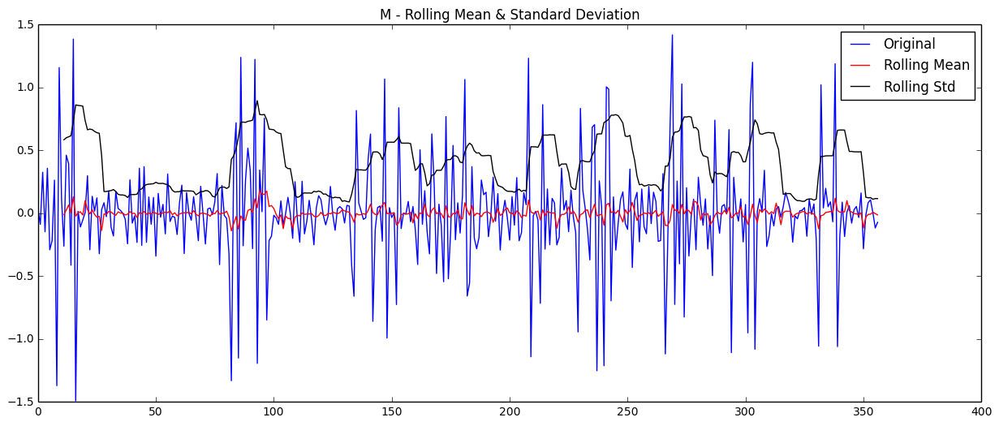

Results of Dickey-Fuller Test:
Test Statistic                -8.317753e+00
p-value                        3.641767e-13
#Lags Used                     1.600000e+01
Number of Observations Used    3.400000e+02
Critical Value (5%)           -2.870079e+00
Critical Value (1%)           -3.449730e+00
Critical Value (10%)          -2.571319e+00
dtype: float64


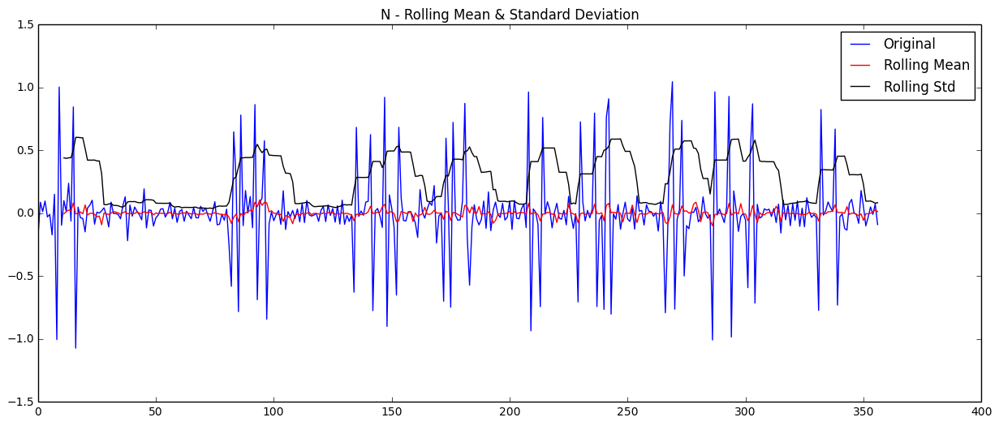

Results of Dickey-Fuller Test:
Test Statistic                -7.911275e+00
p-value                        3.942033e-12
#Lags Used                     1.700000e+01
Number of Observations Used    3.390000e+02
Critical Value (5%)           -2.870104e+00
Critical Value (1%)           -3.449788e+00
Critical Value (10%)          -2.571332e+00
dtype: float64


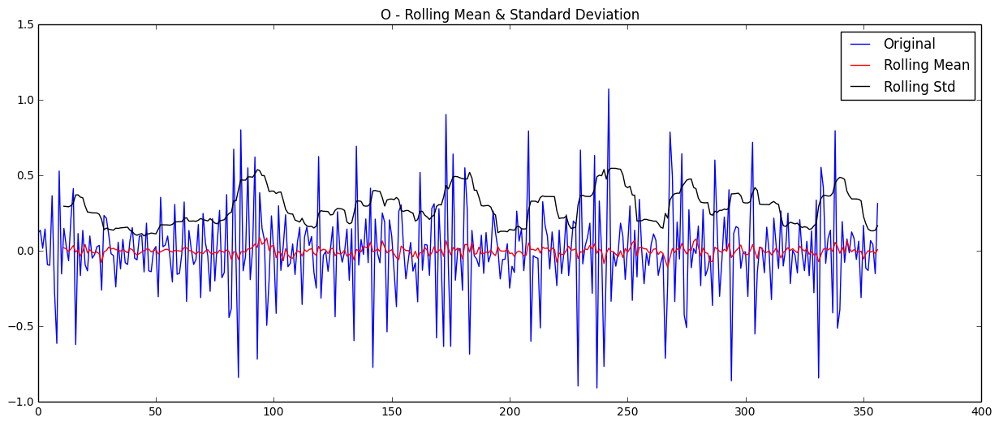

Results of Dickey-Fuller Test:
Test Statistic                -8.627328e+00
p-value                        5.882027e-14
#Lags Used                     1.400000e+01
Number of Observations Used    3.420000e+02
Critical Value (5%)           -2.870028e+00
Critical Value (1%)           -3.449616e+00
Critical Value (10%)          -2.571292e+00
dtype: float64


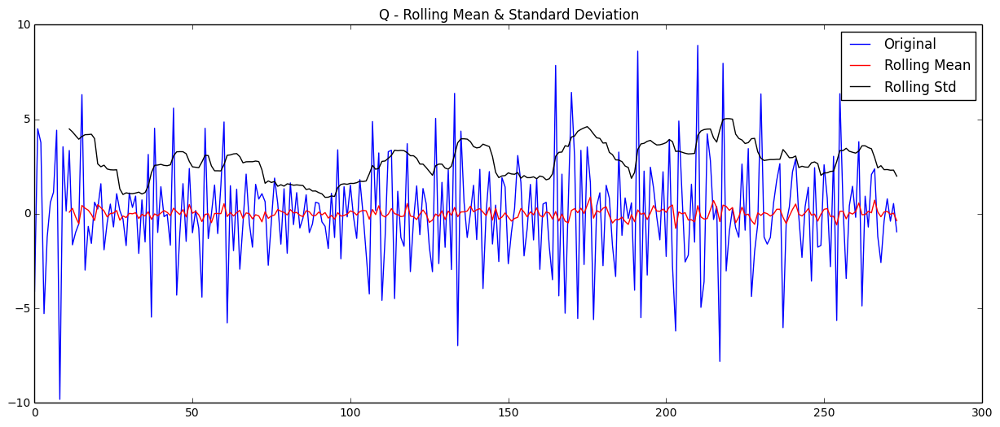

Results of Dickey-Fuller Test:
Test Statistic                -8.088439e+00
p-value                        1.399220e-12
#Lags Used                     1.500000e+01
Number of Observations Used    2.580000e+02
Critical Value (5%)           -2.872809e+00
Critical Value (1%)           -3.455953e+00
Critical Value (10%)          -2.572775e+00
dtype: float64


In [182]:
# Let's see the Dickey-Fuller test after taking the log, diff, & season diff...
_ = map(test_stationarity, splitted_data_log_diff_season, temp_list)

In [183]:
def acf_pacf_plot(timeseries, title, item, lags=30):
    fig = plt.figure(figsize=(12,8))
    ax1 = fig.add_subplot(211)
    fig = sm.graphics.tsa.plot_acf(timeseries, lags=lags, ax=ax1)
    ax2 = fig.add_subplot(212)
    fig = sm.graphics.tsa.plot_pacf(timeseries, lags=lags, ax=ax2)
    fig.suptitle('Category {} - {} ACF/PACF Plot'.format(item, title), fontsize=20)

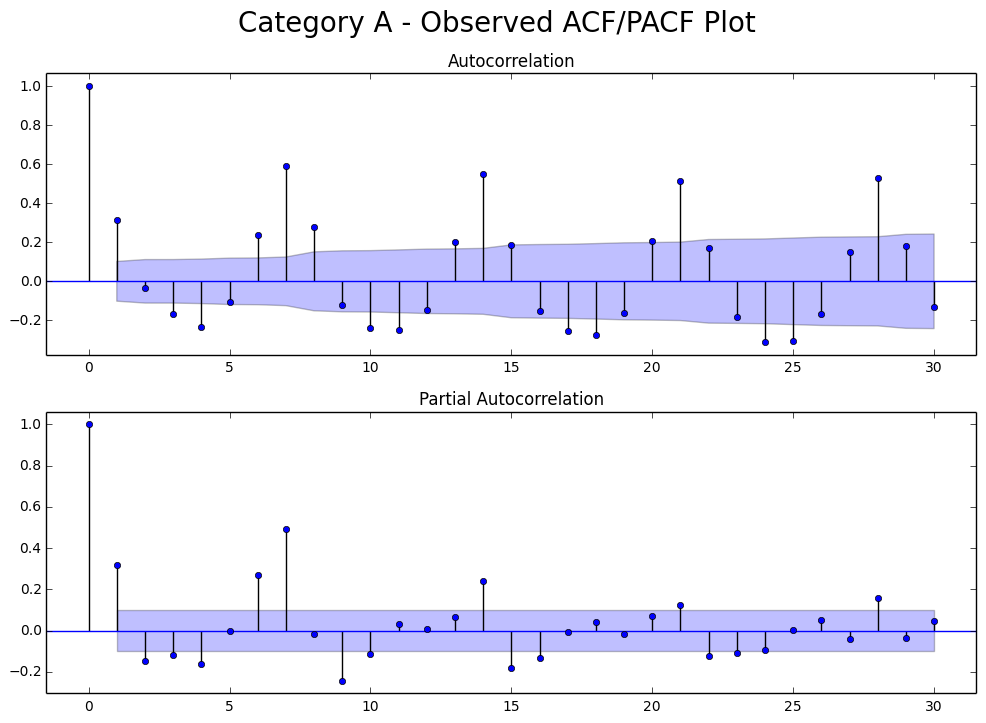

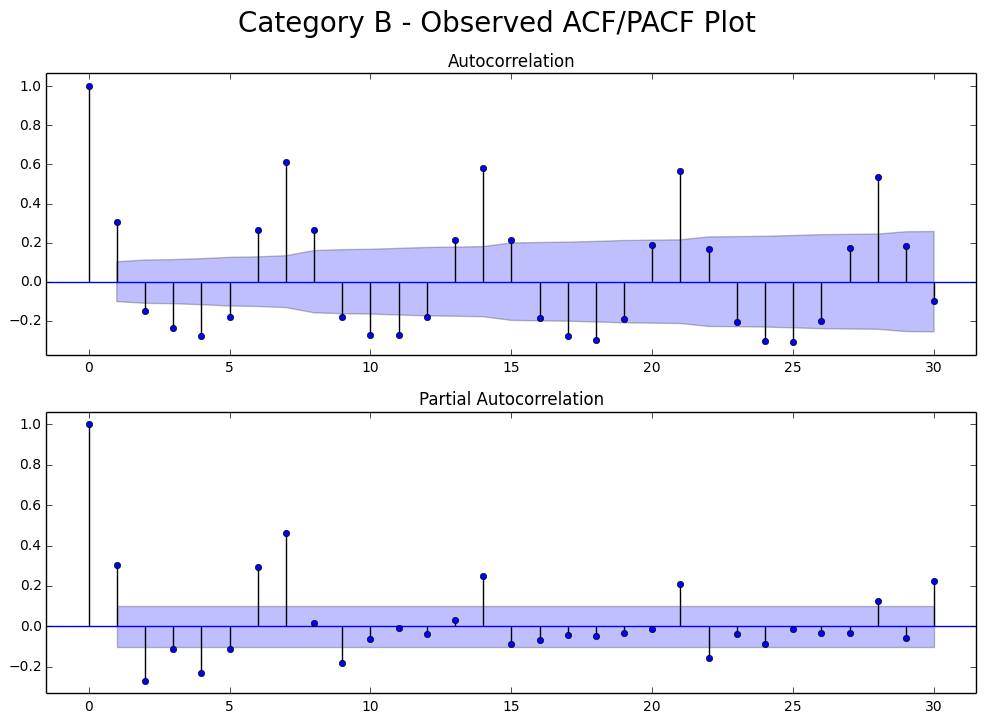

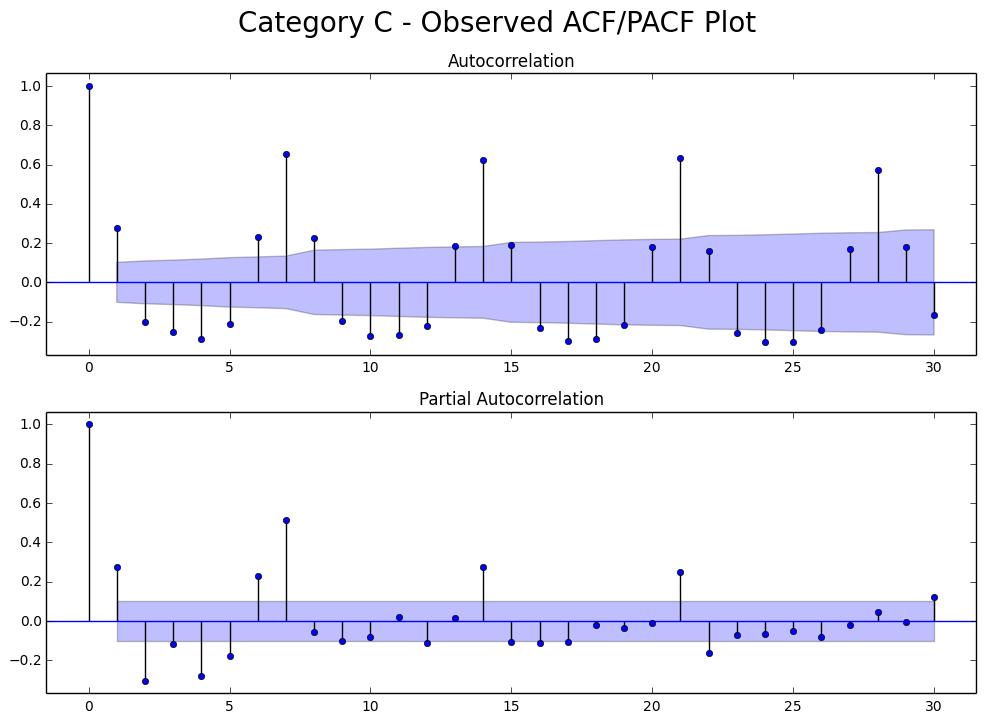

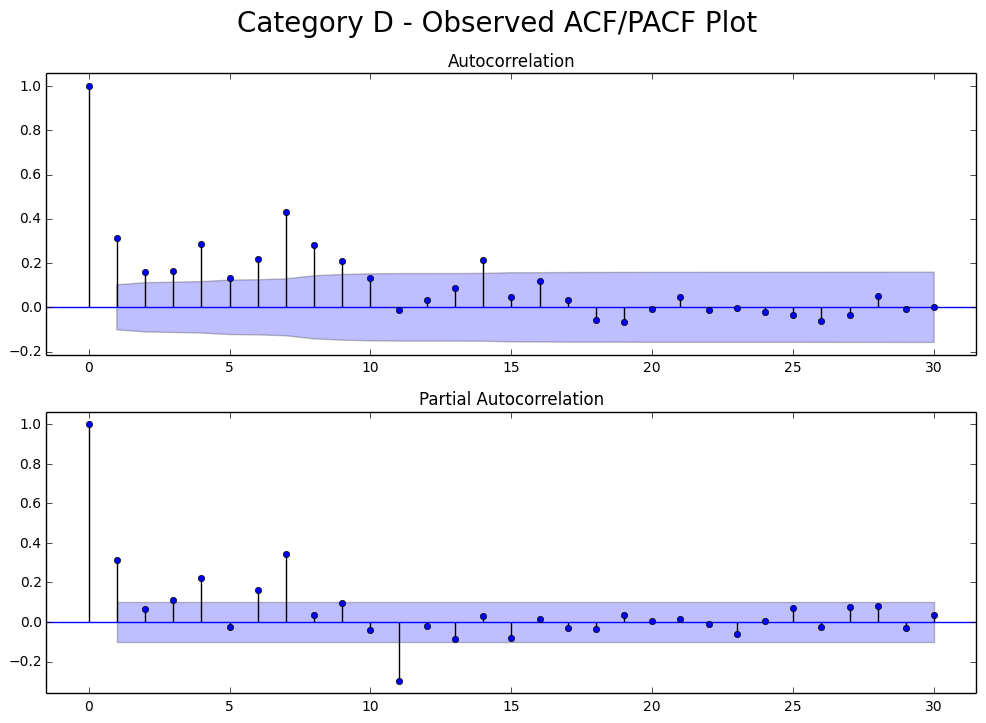

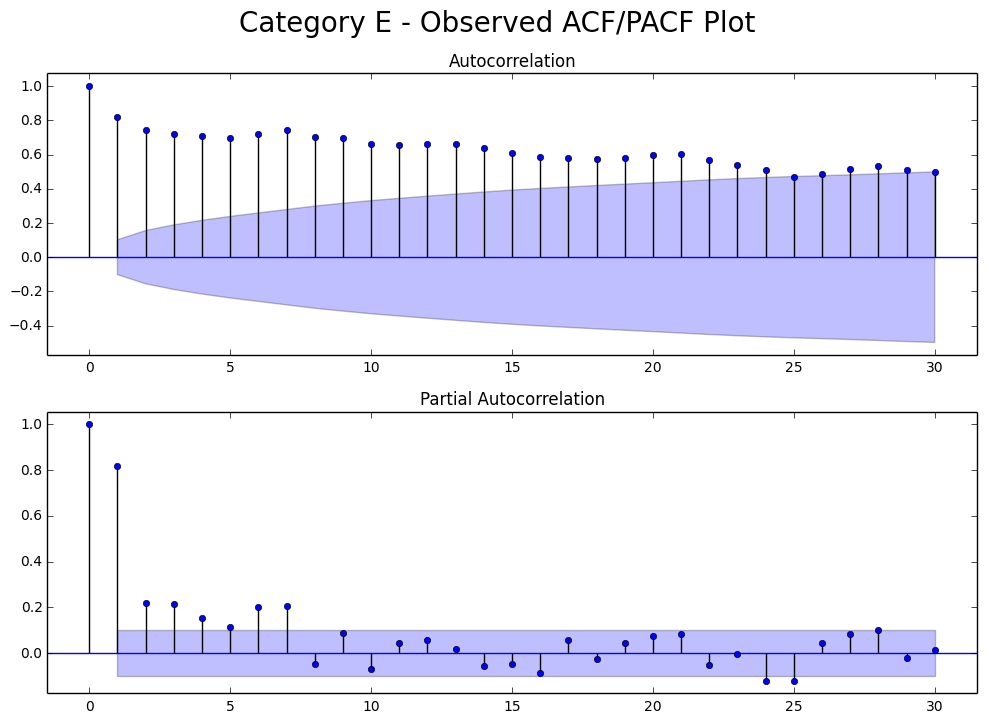

...

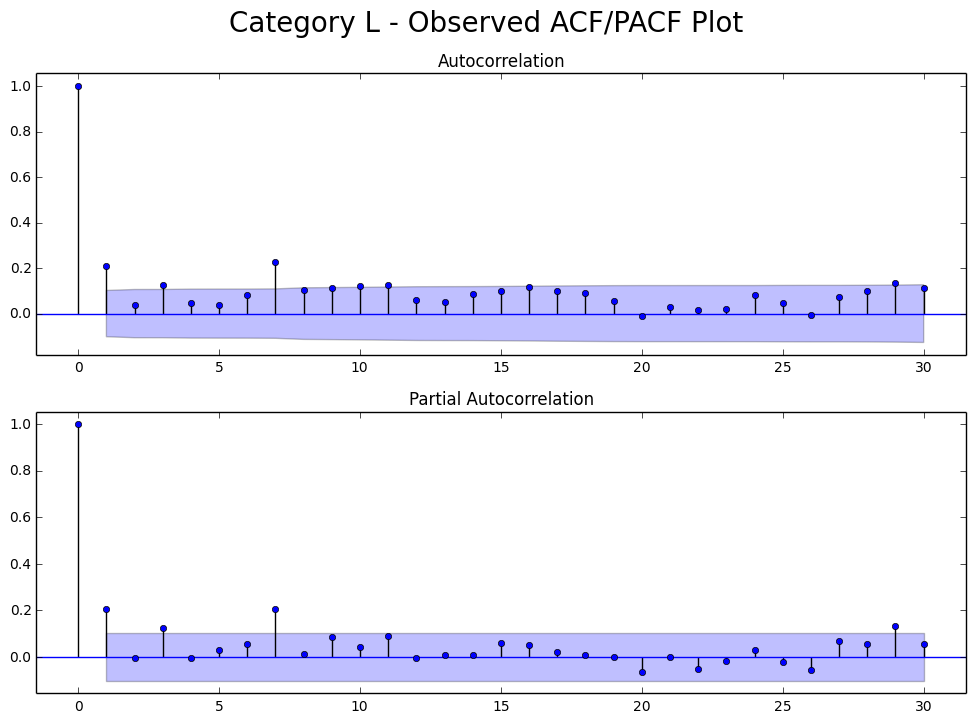

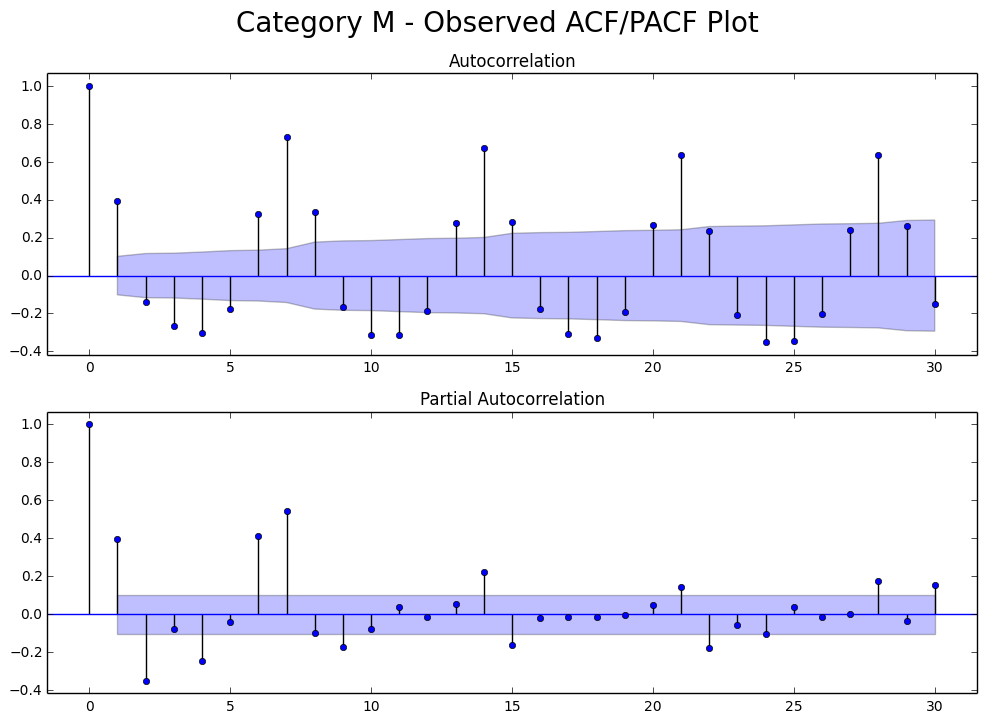

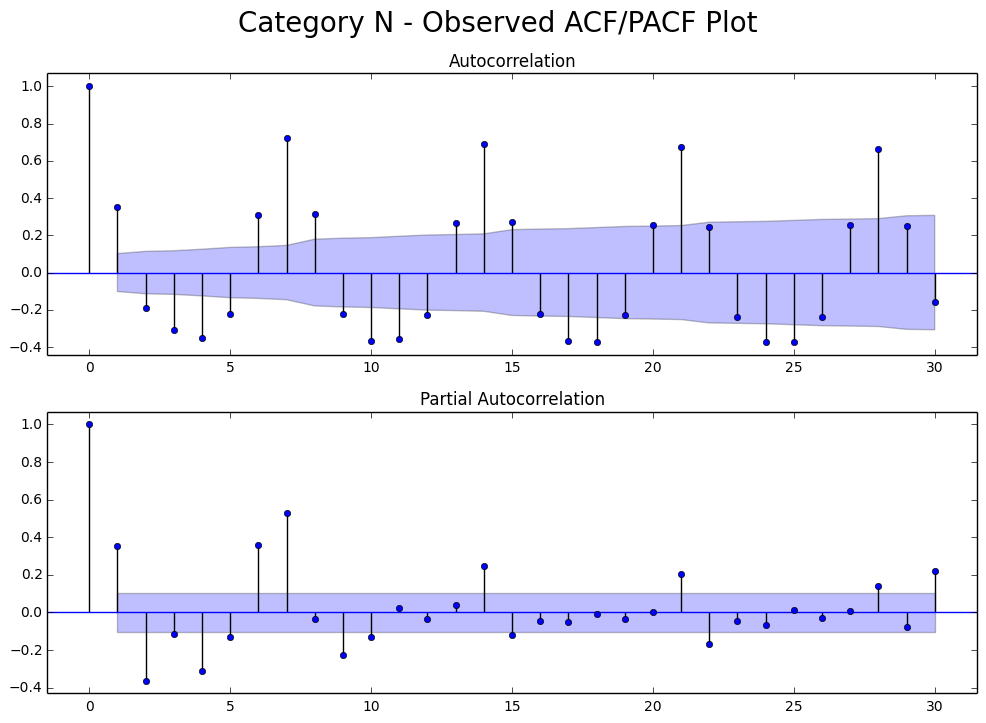

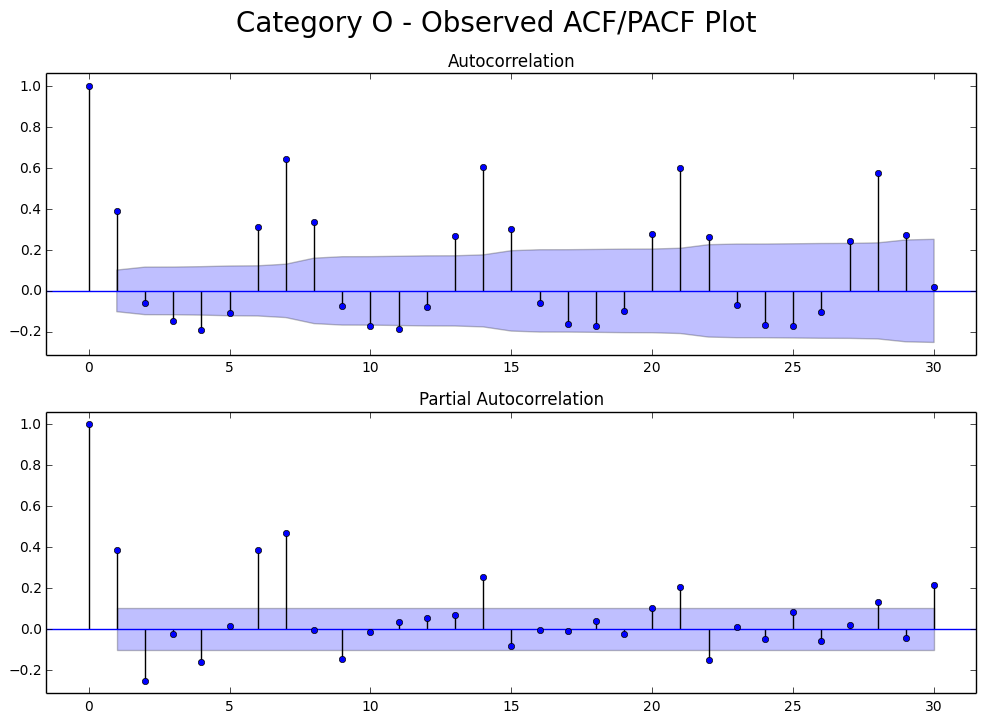

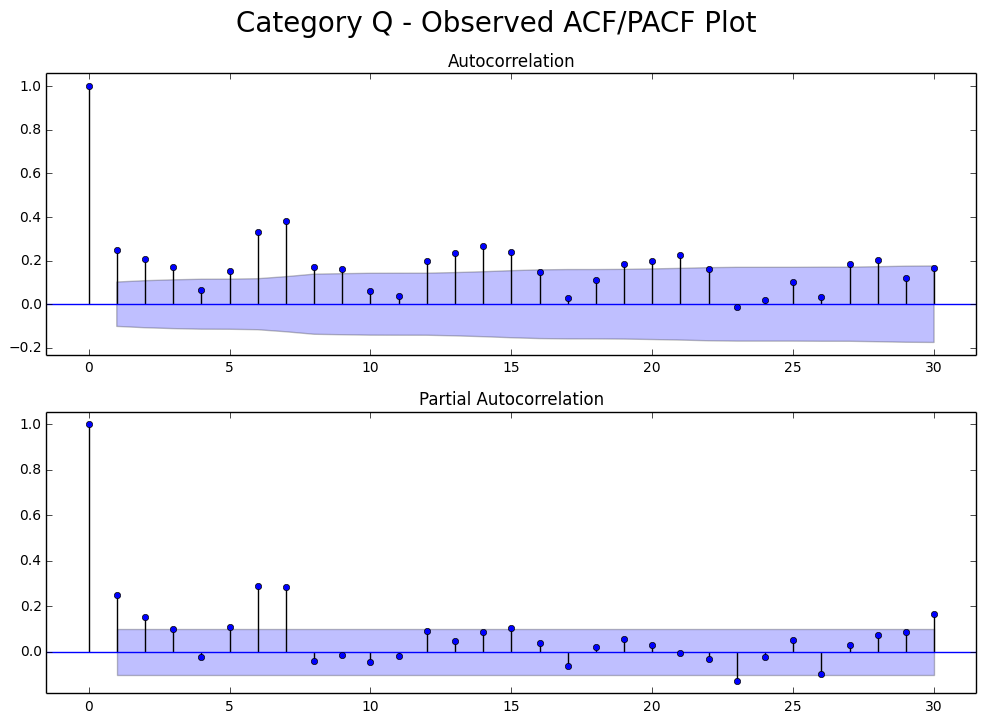

In [184]:
# Observed ACF/PACF plot.

_ = map(acf_pacf_plot, splitted_data, ['Observed']*len(temp_list), temp_list)

### A) Both tails off
### B), C), D), E), F), G), H), I), K), L), M), N), O), P) Both tails off
### Q) PACF cuts off at 1, probably AR(1) model...

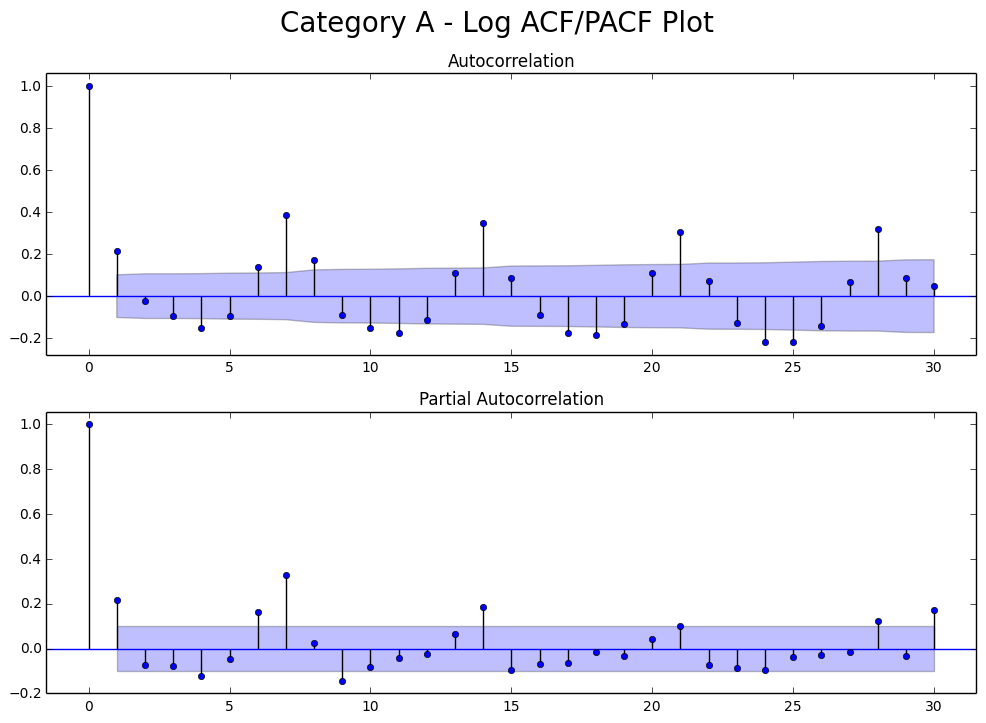

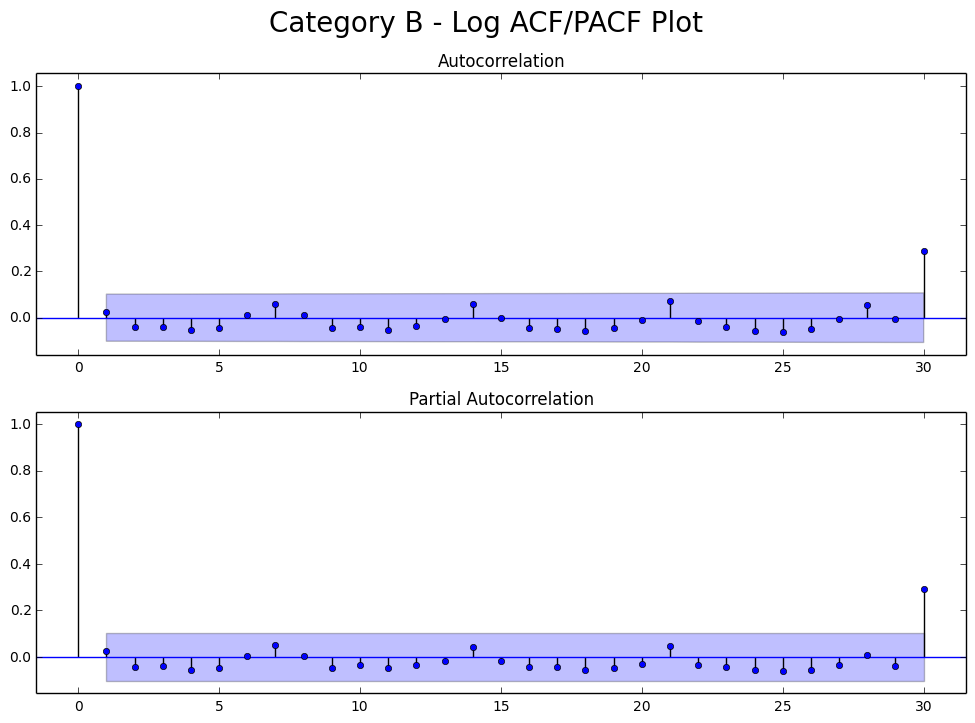

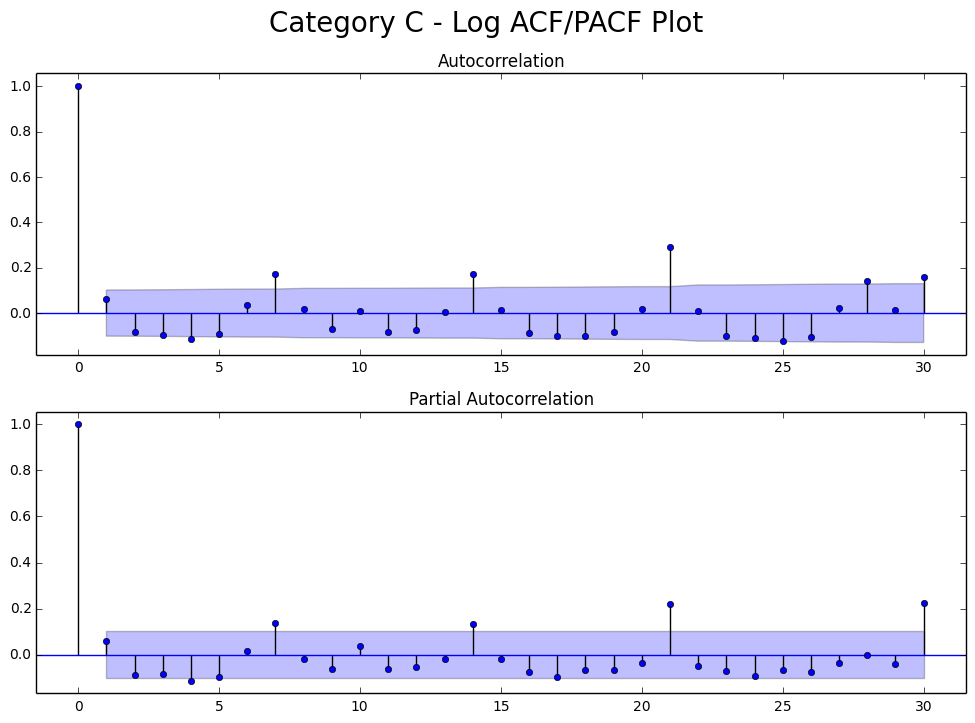

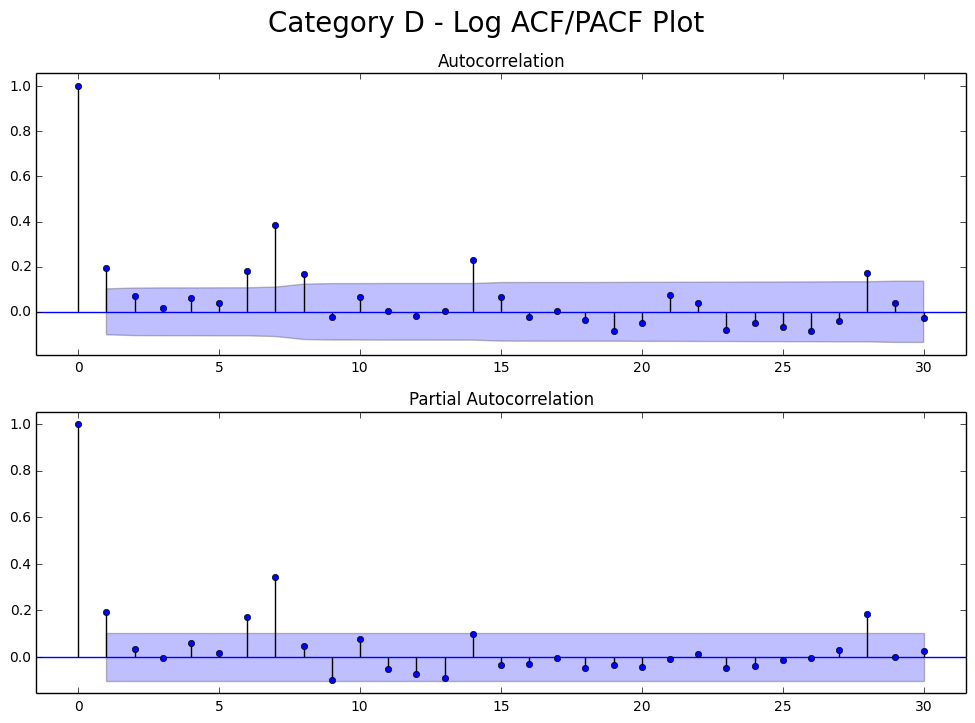

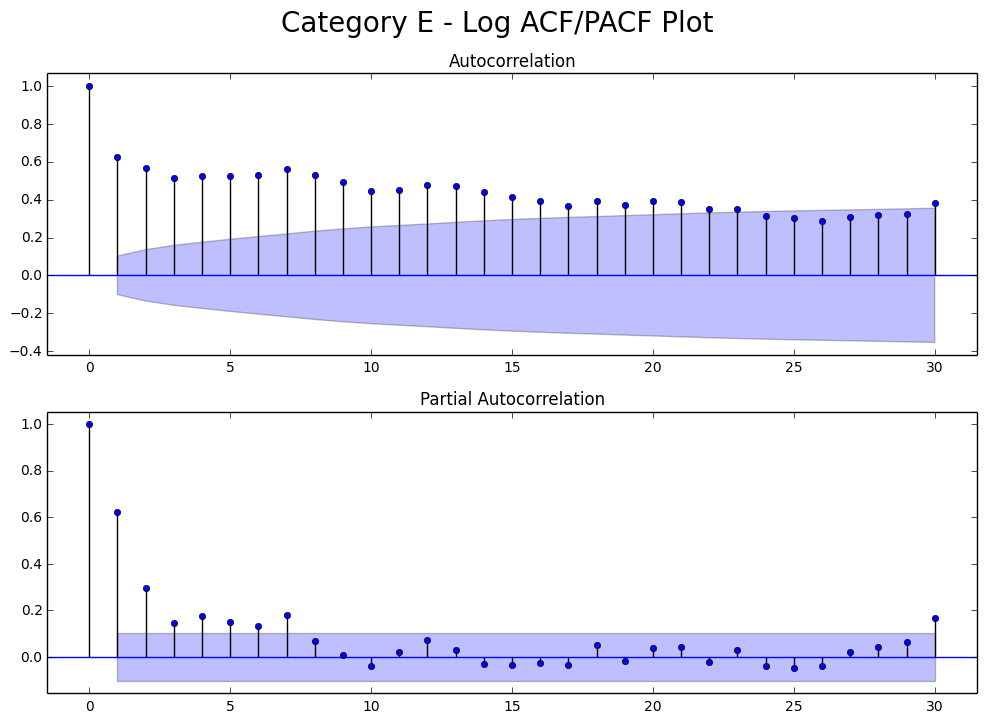

...

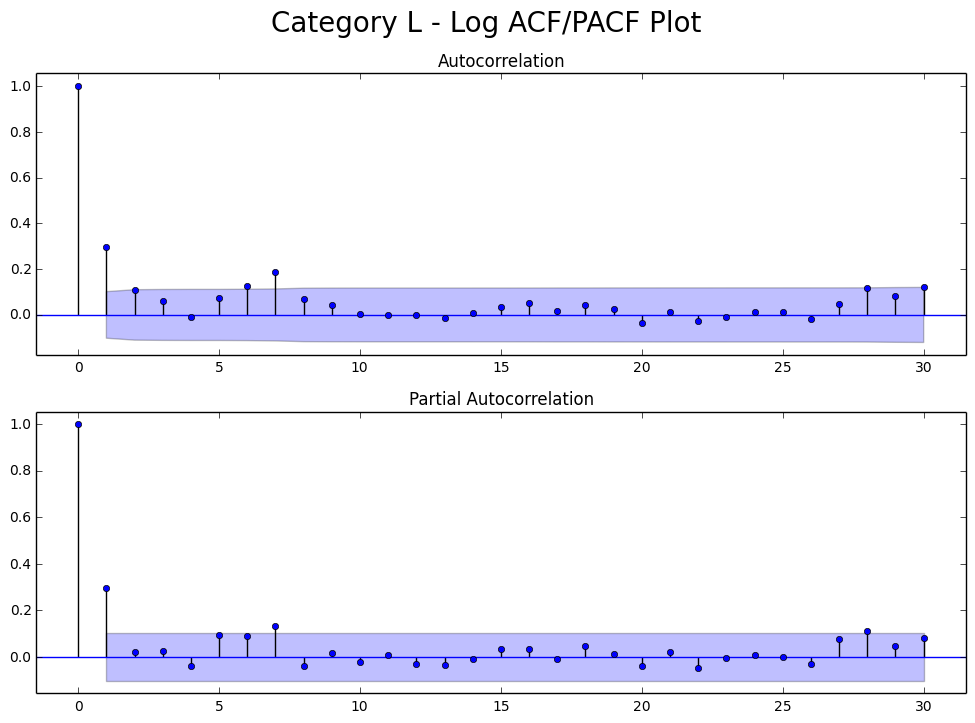

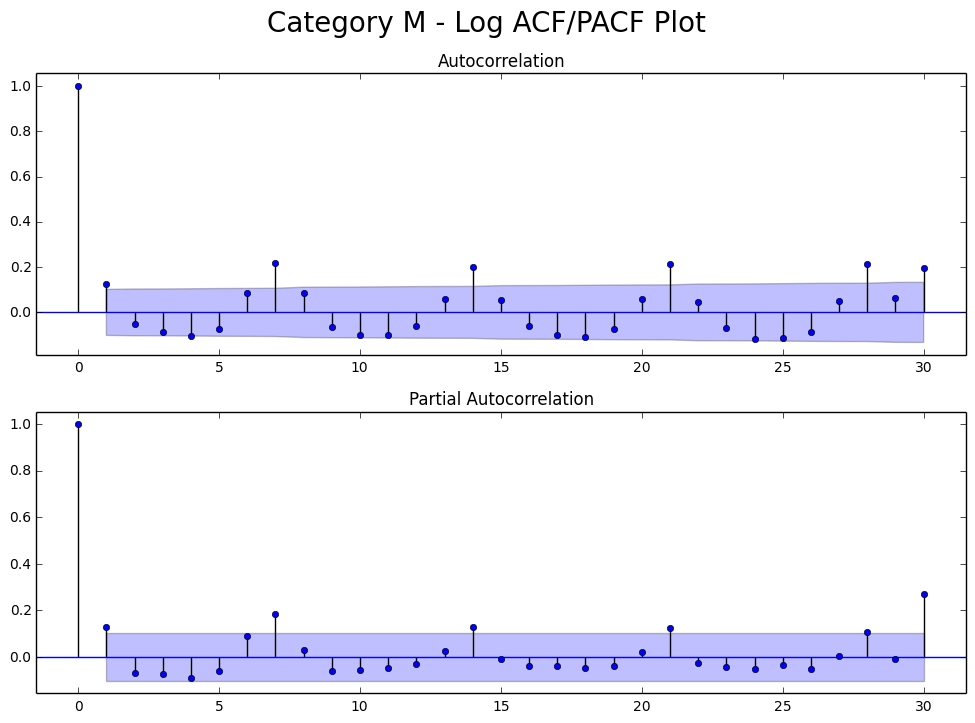

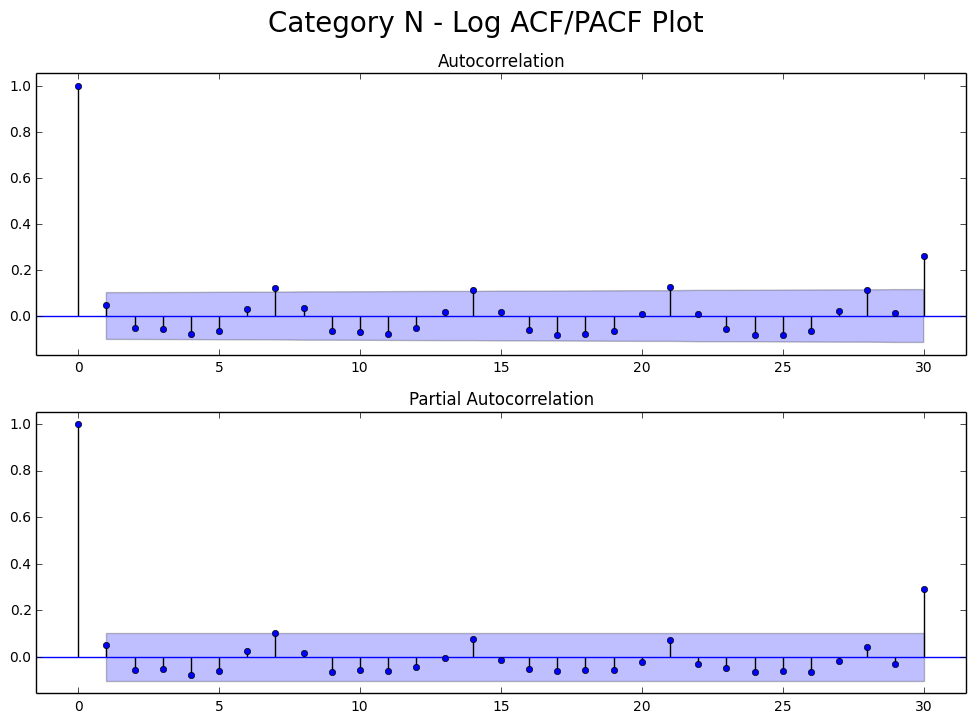

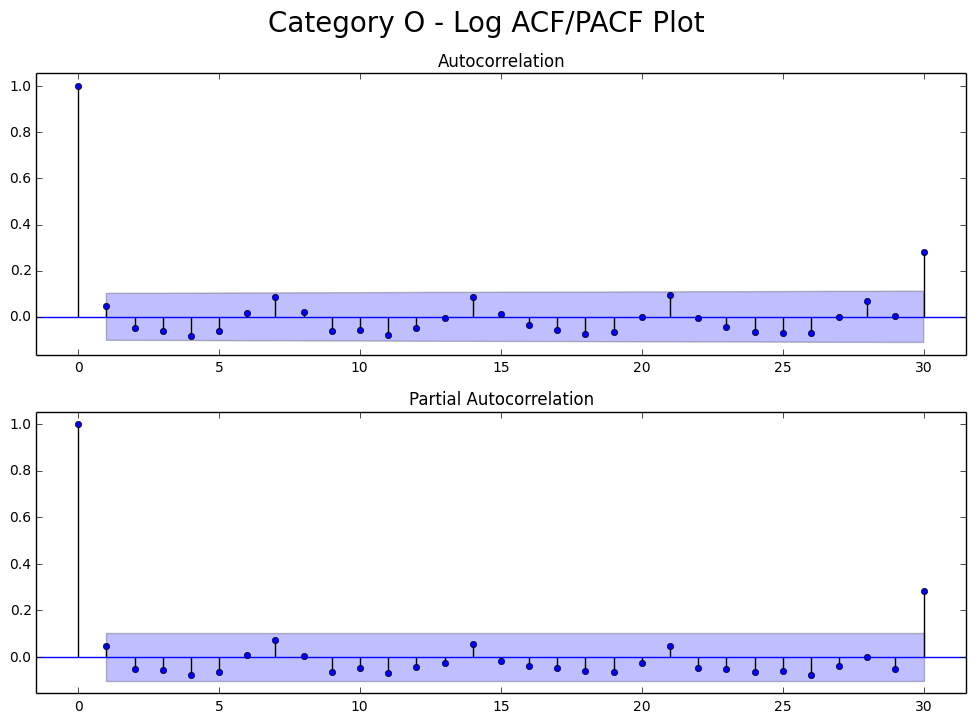

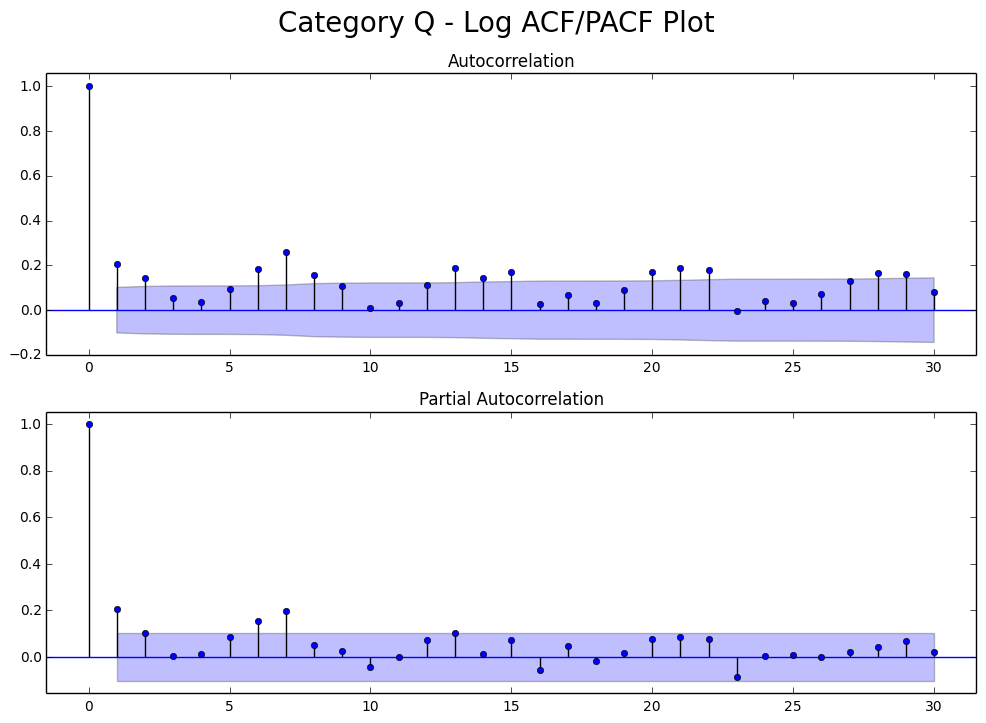

In [185]:
# Log ACF/PACF plot.

_ = map(acf_pacf_plot, splitted_data_log, ['Log']*len(temp_list), temp_list)

### A), D), E), F), G), H), I), L), P) both tail
### B), C), K), M), N), O), Q) PACF cut 1
### Some cut offs are not clear...possibly AR(1)?

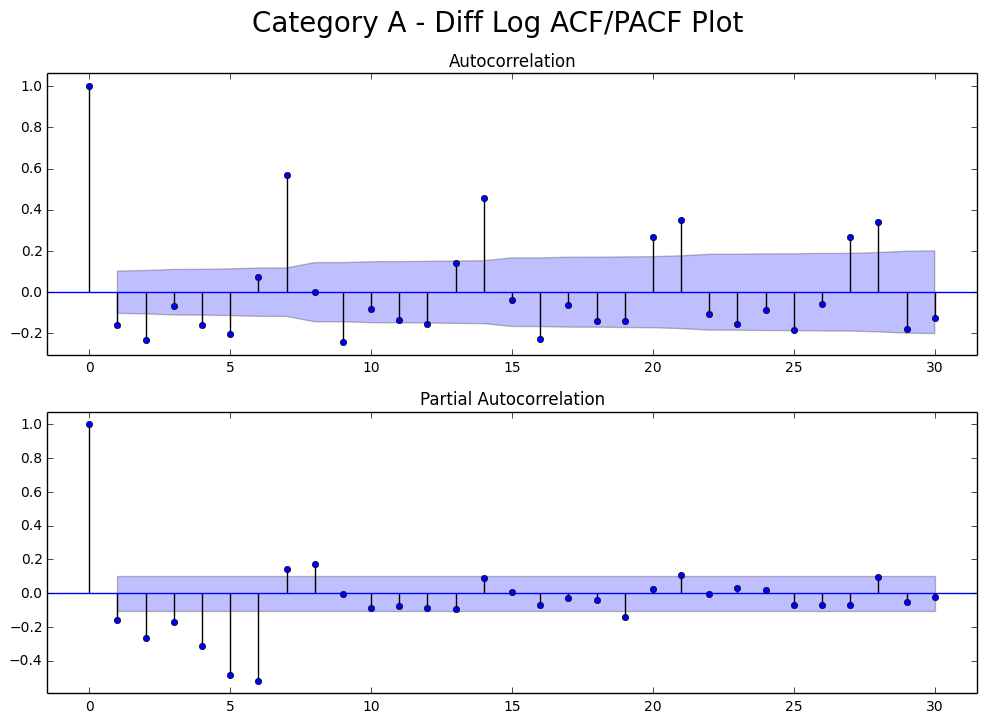

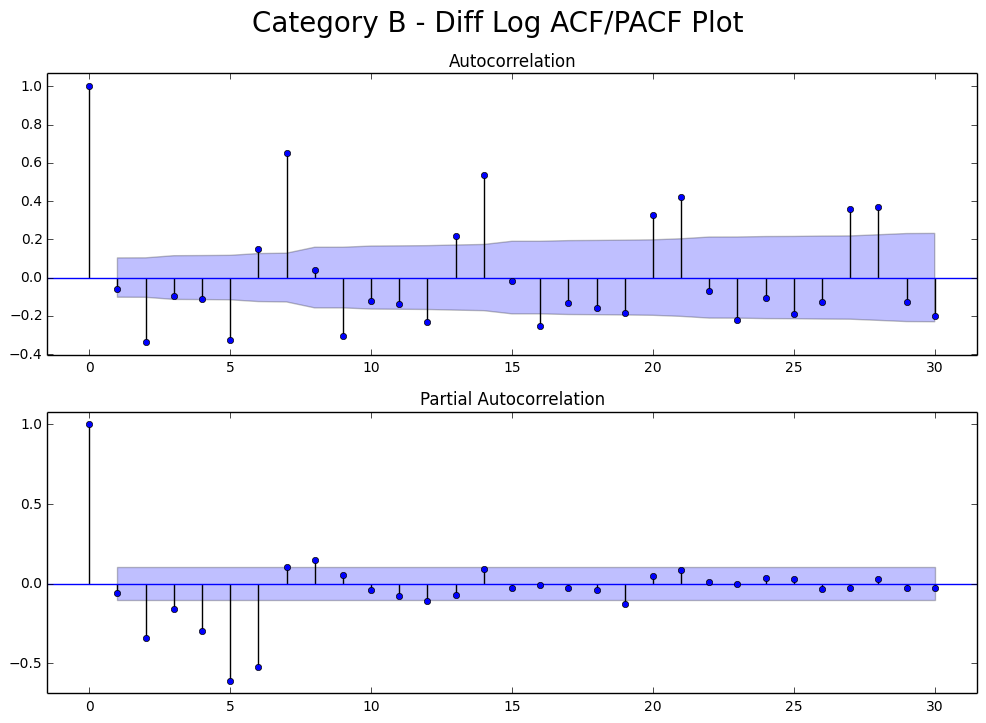

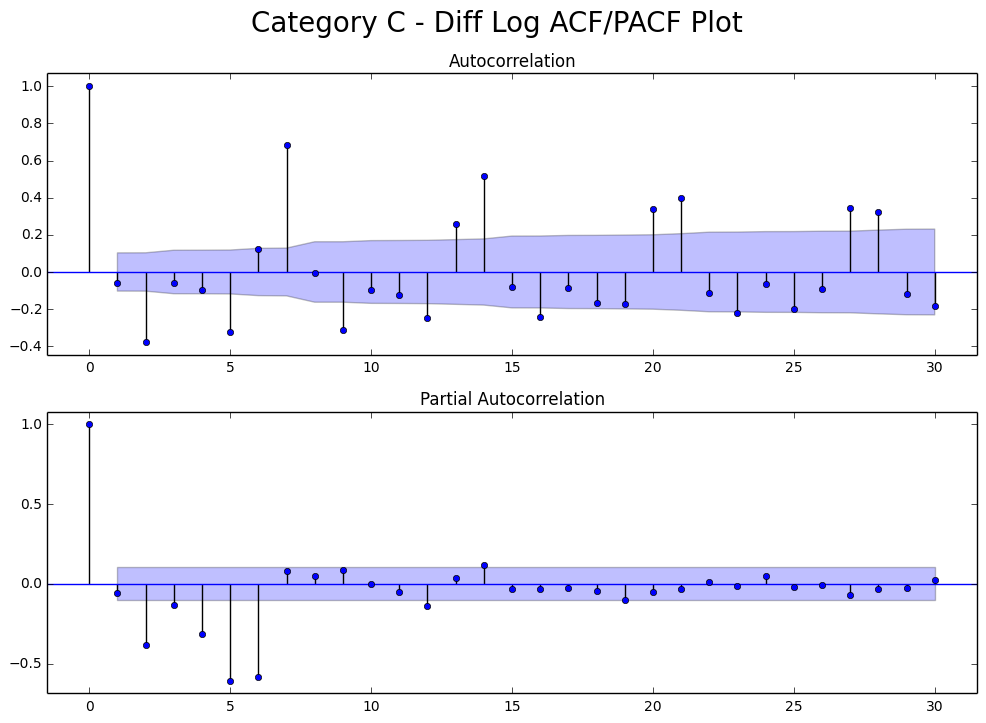

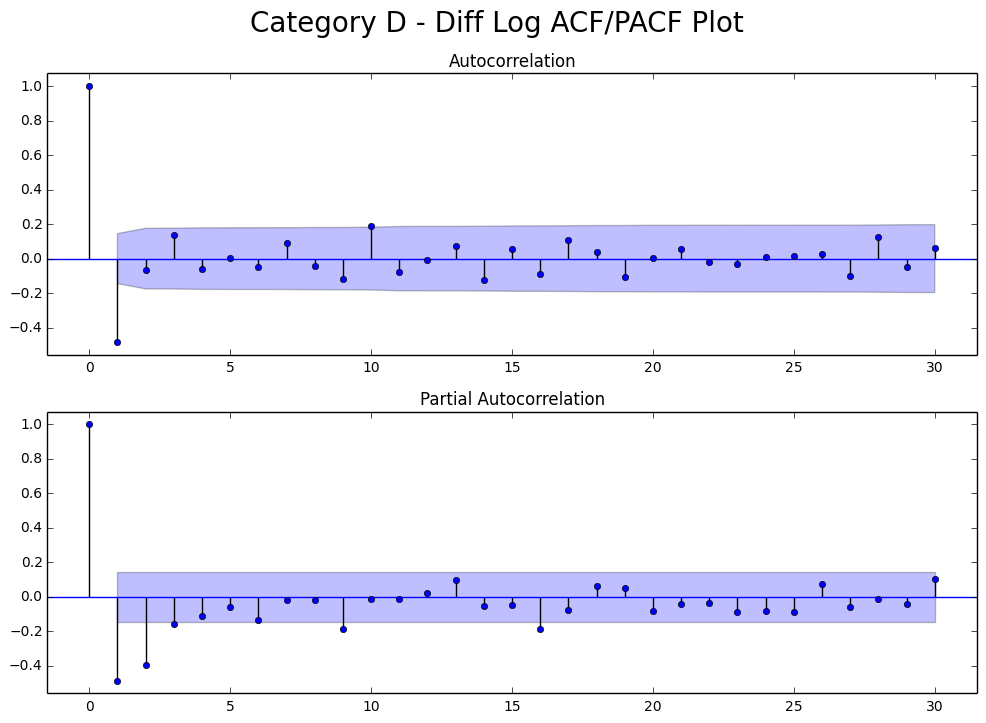

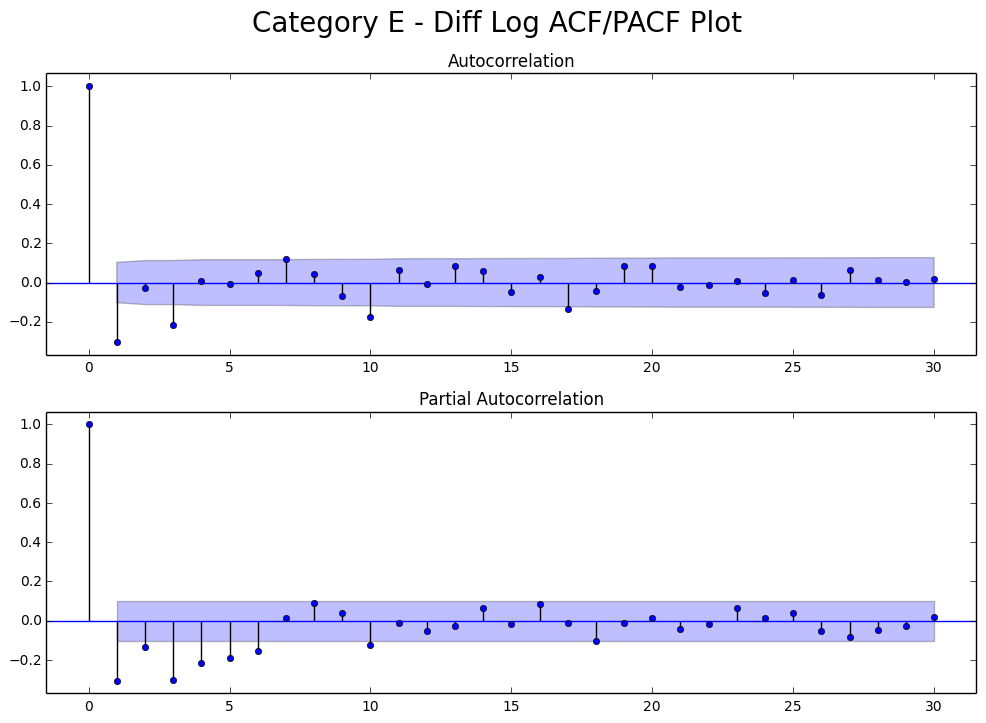

...

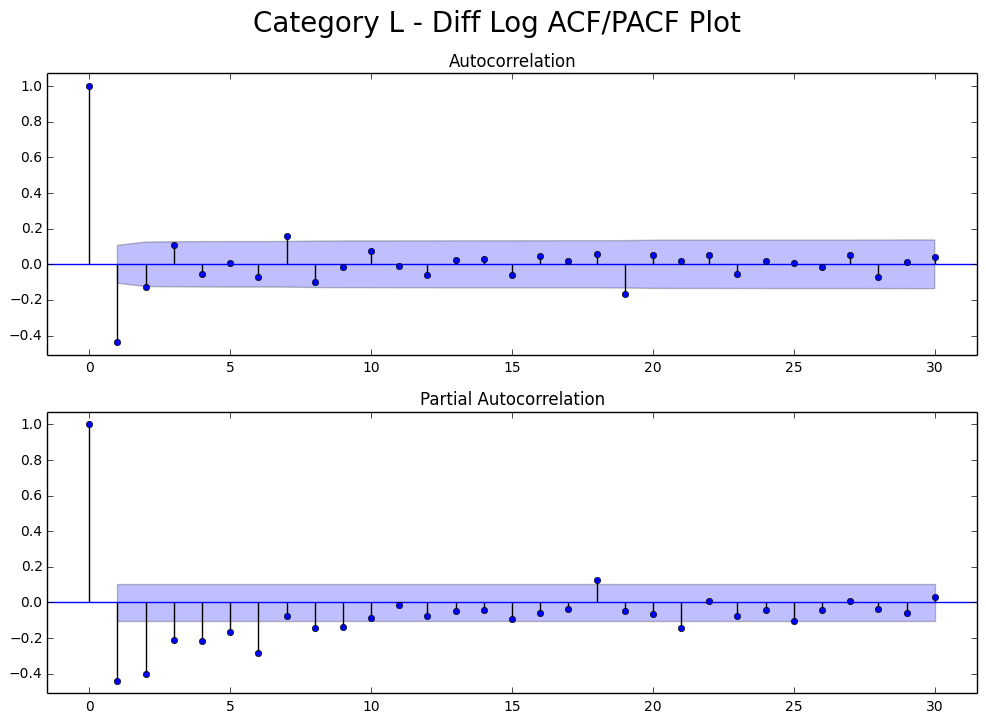

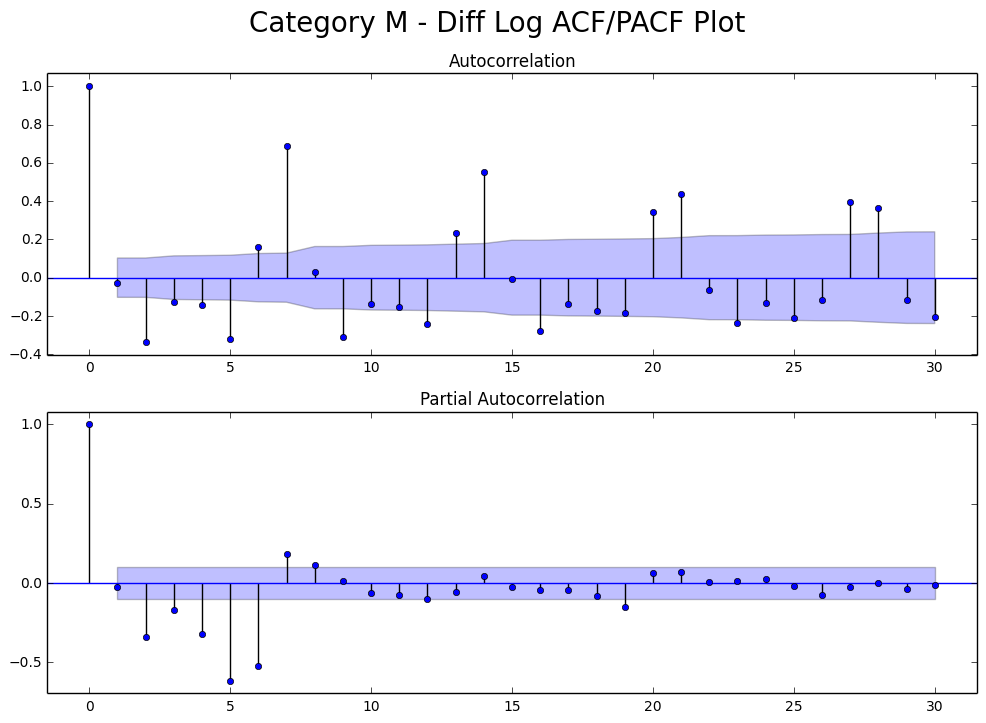

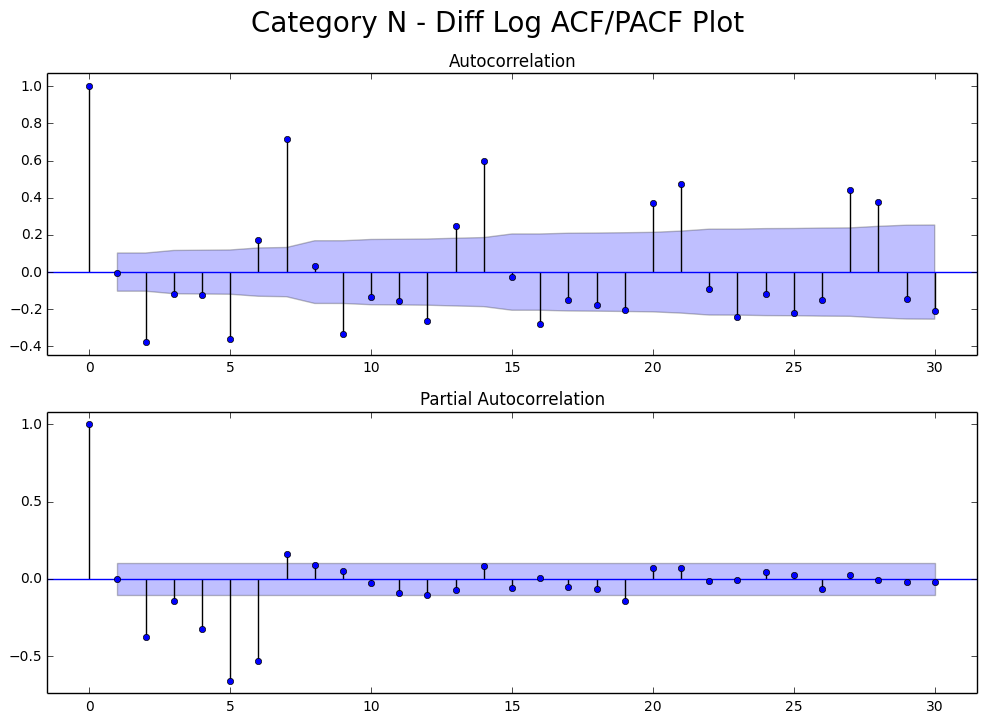

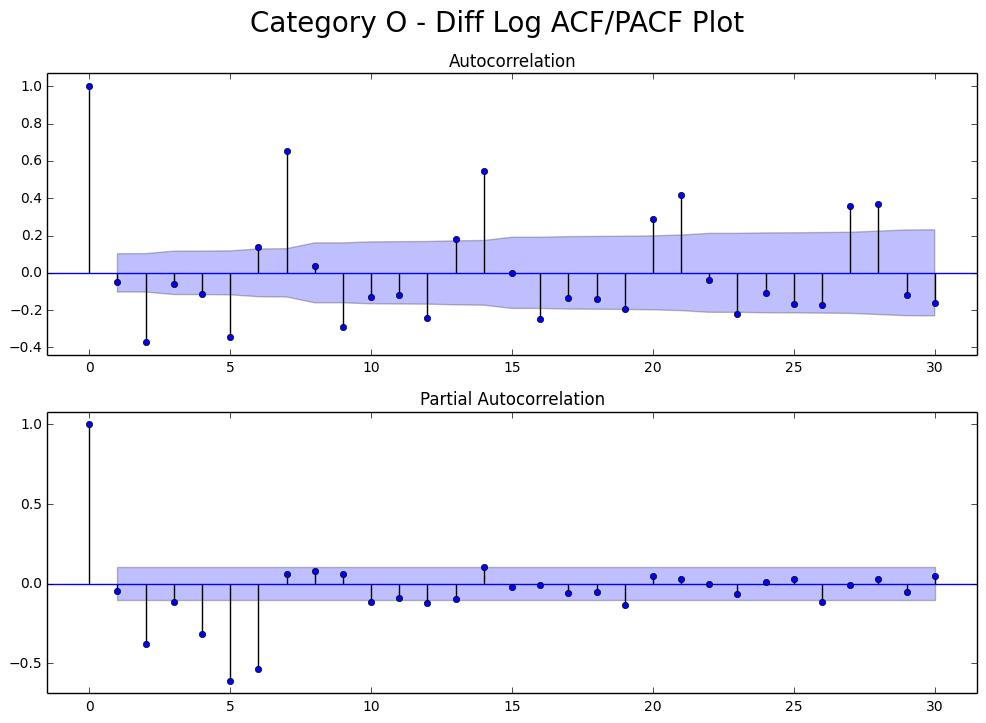

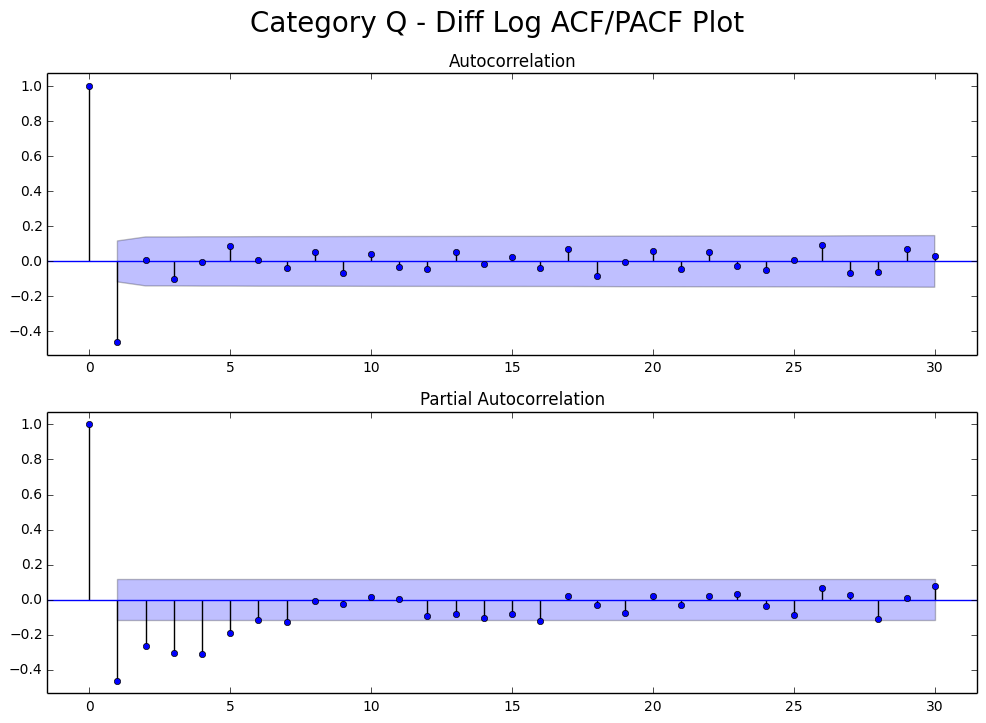

In [186]:
# Diff log ACF/PACF plot.

_ = map(acf_pacf_plot, splitted_data_log_diff, ['Diff Log']*len(temp_list), temp_list)

### - Log diff has both tails off, thus, ARMA behavior.
### - So...the observed data may be ARIMA...

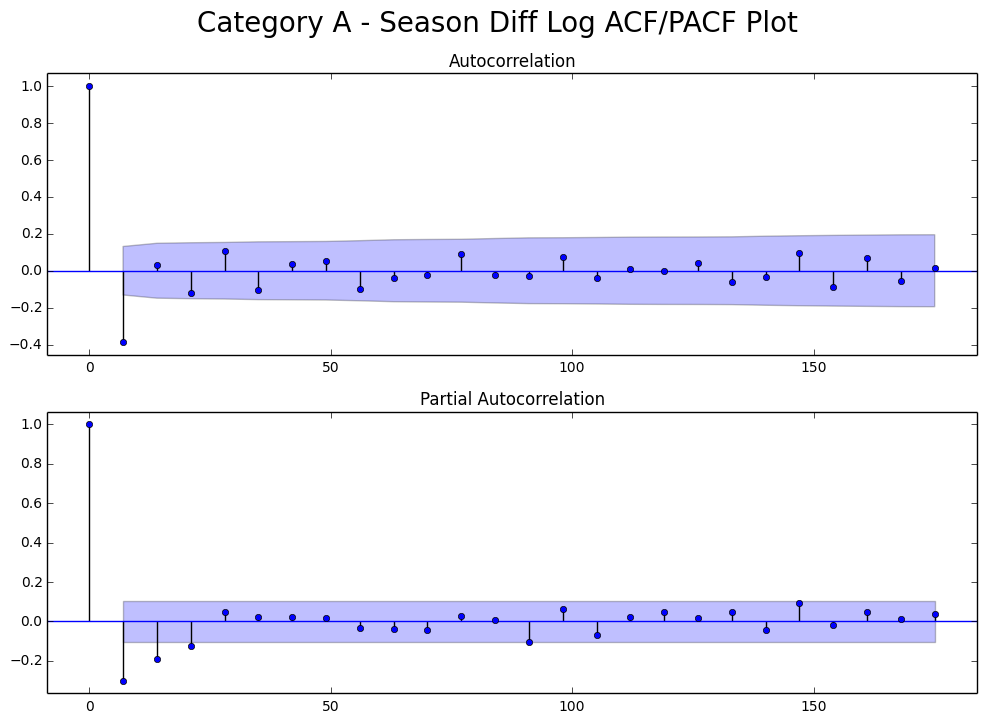

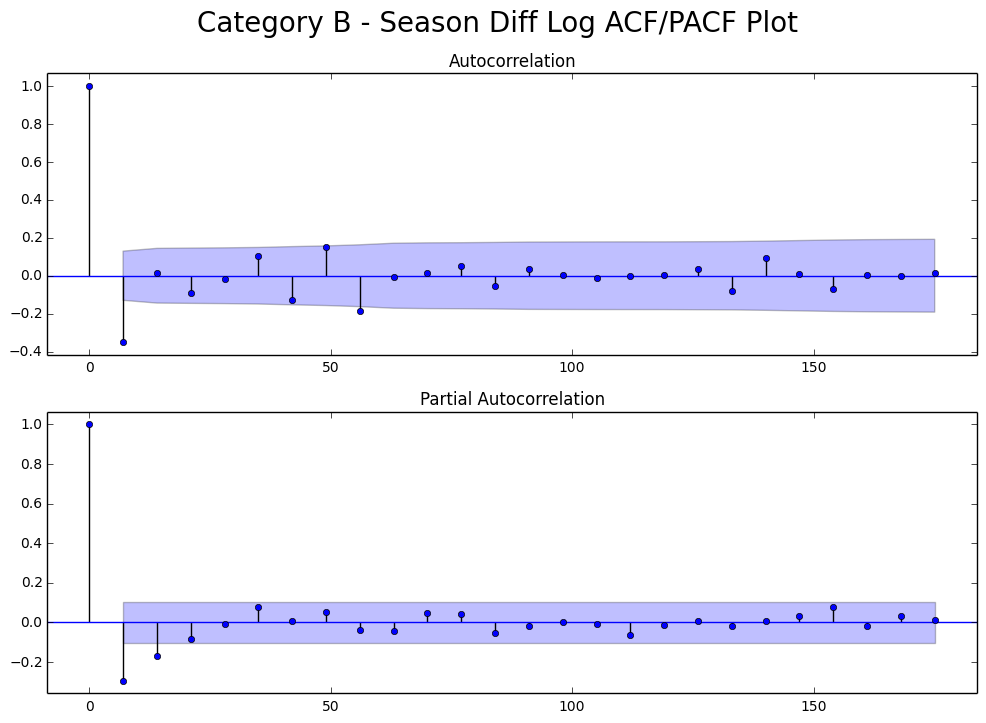

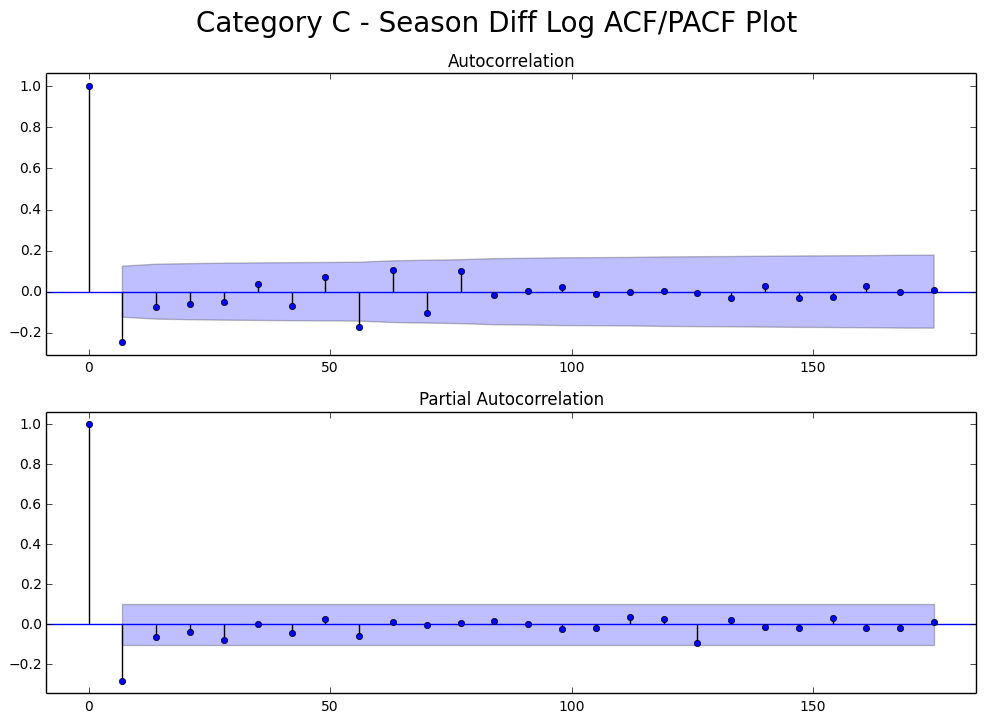

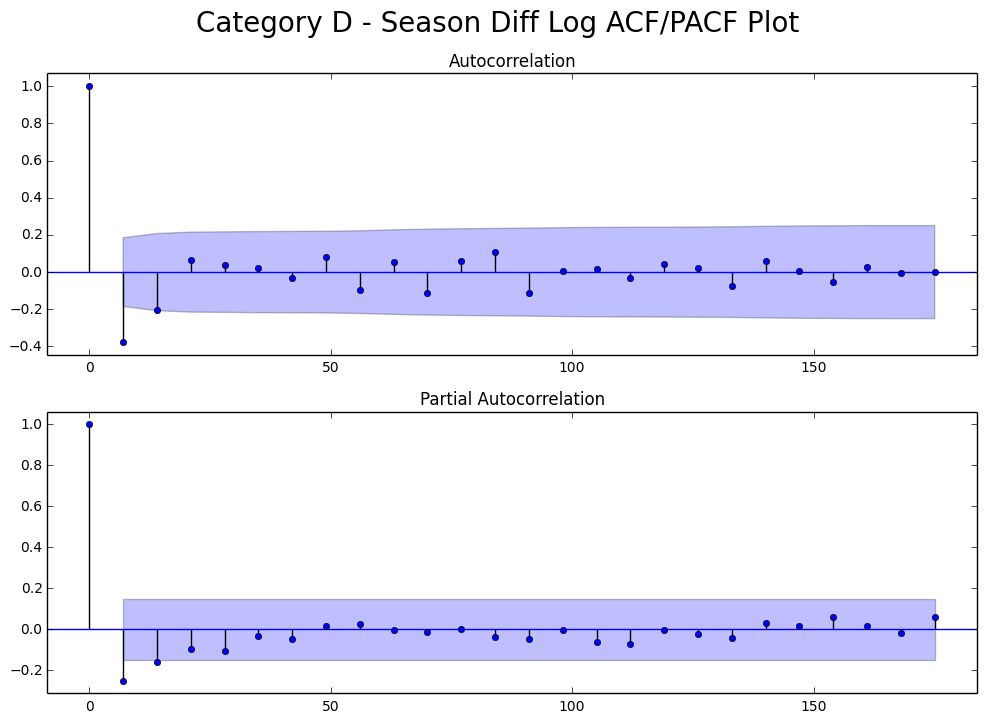

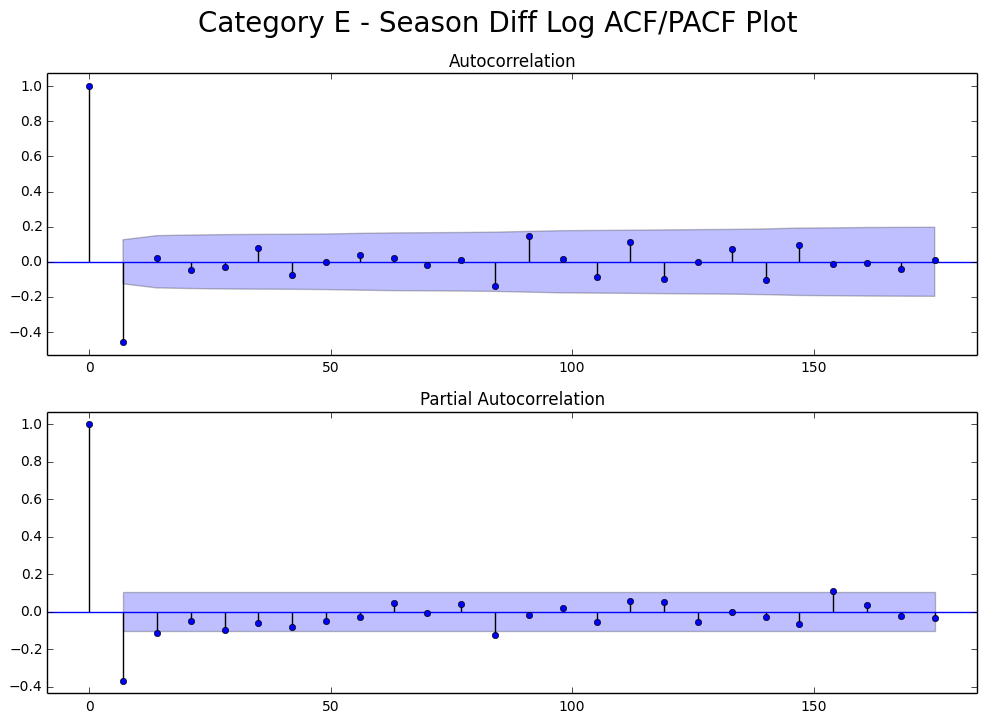

...

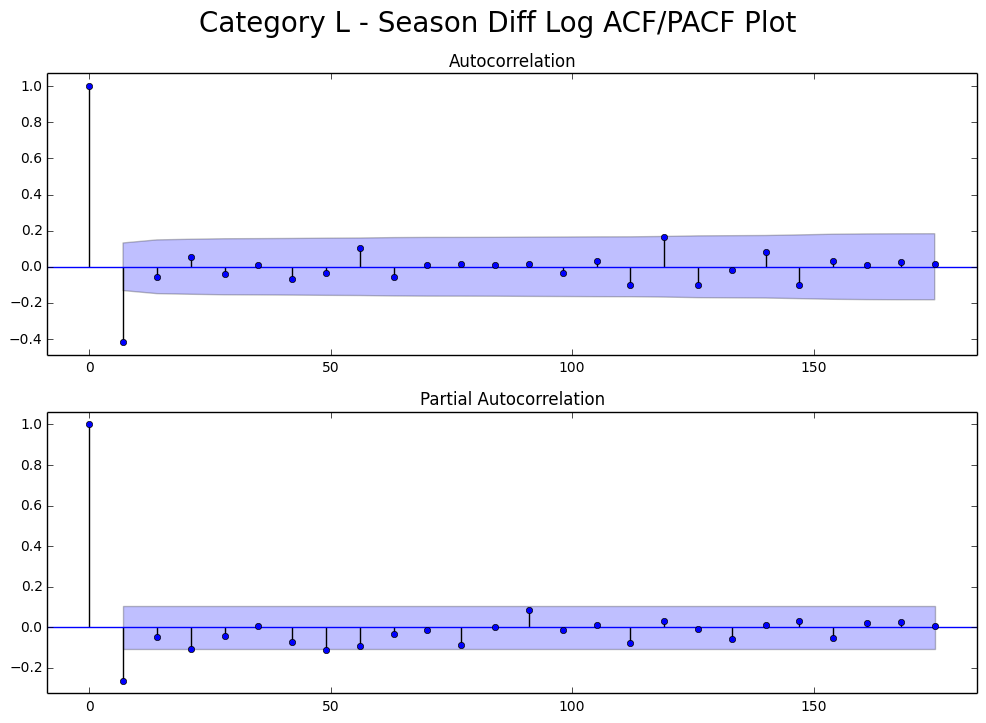

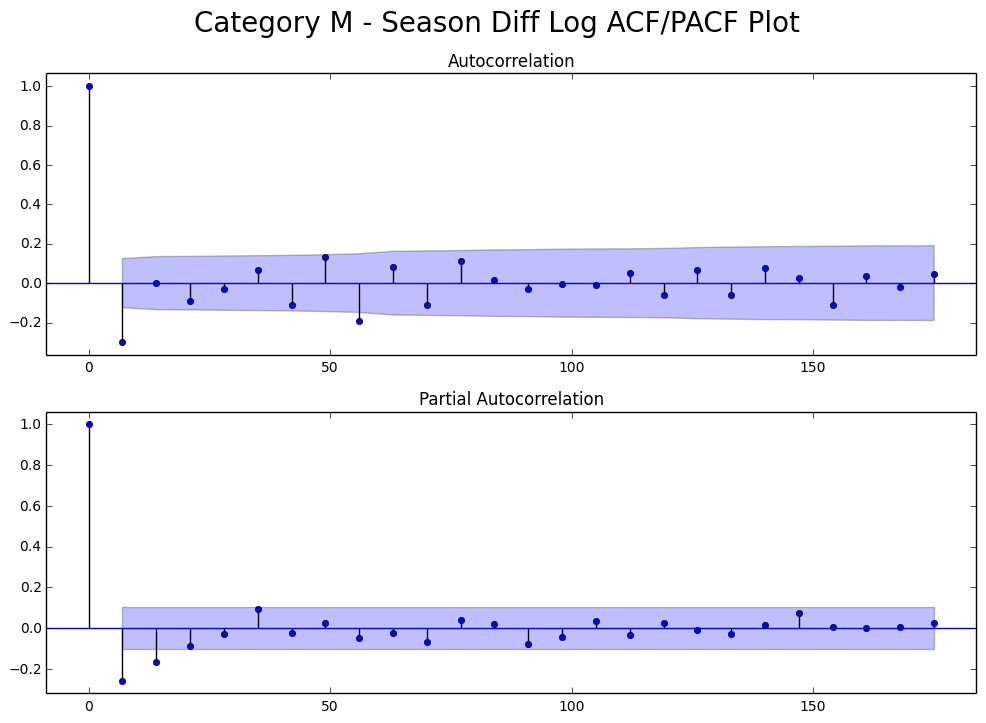

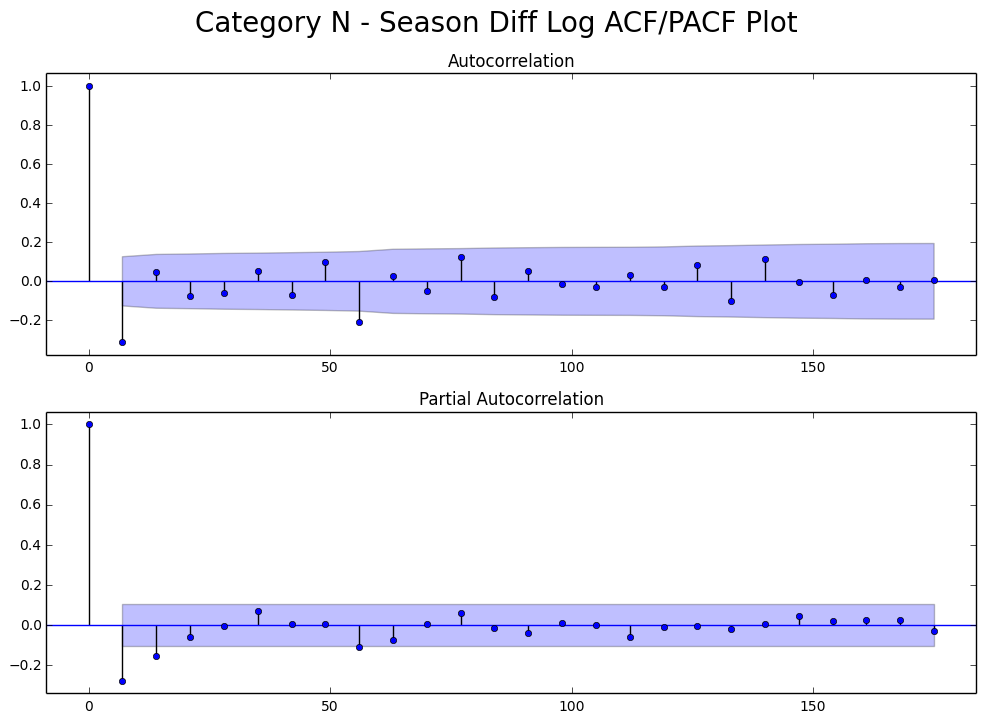

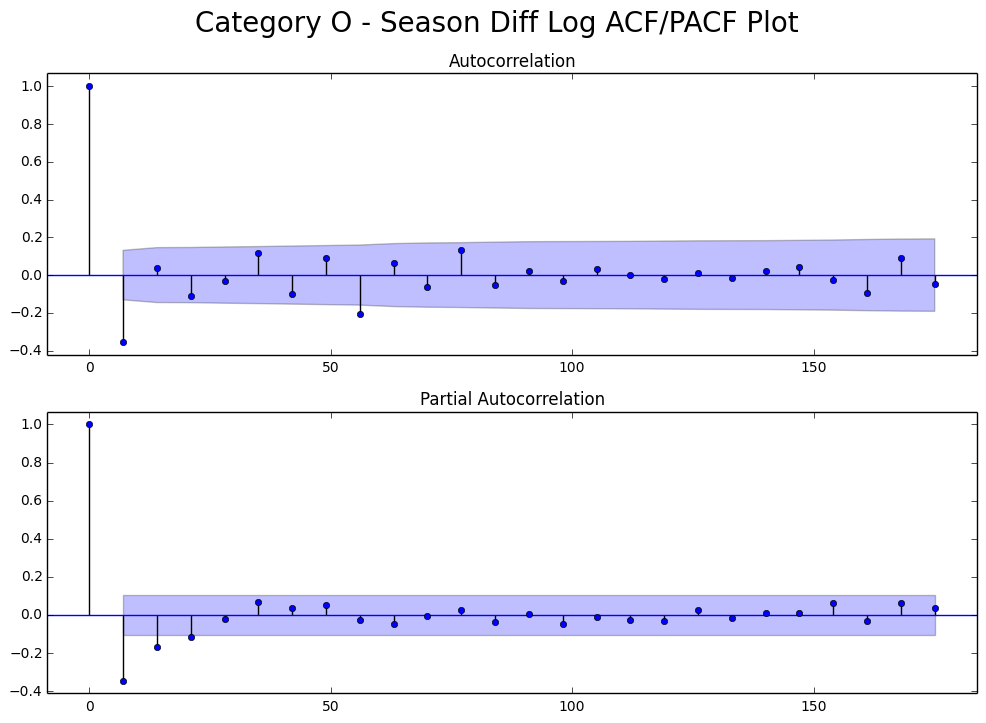

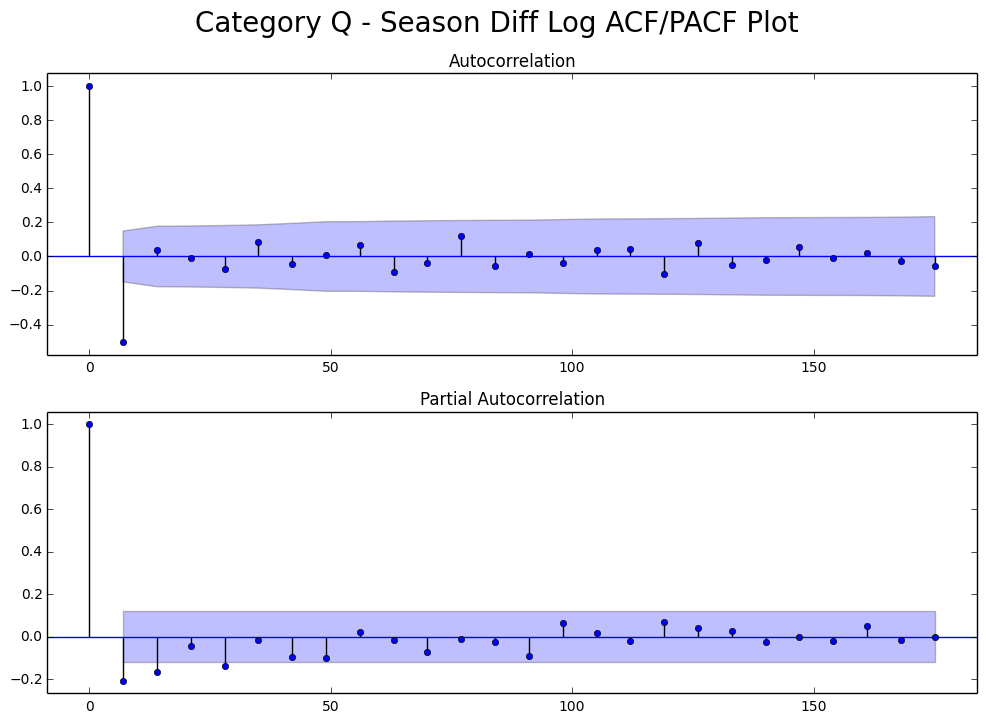

In [187]:
# Seasonal Diff Log ACF/PACF plot.

_ = map(acf_pacf_plot, splitted_data_log_diff_season, ['Season Diff Log']*len(temp_list), temp_list, [range(0, 182, 7)]*len(temp_list))

### All - ACF cut 1...SMA(1)? -> SARIMA(0, 1, 1)?

In [ ]:
def evaluate_arima_model(X, arima_order):
    # prepare training dataset
    X = X.astype('float32')
    train_size = int(len(X) * 0.50)
    train, test = X[0:train_size], X[train_size:]
    history = [x for x in train]
    # make predictions
    predictions = list()
    for t in range(len(test)):
        model = ARIMA(history, order=arima_order)
        model_fit = model.fit(disp=0)
        yhat = model_fit.forecast()[0]
        predictions.append(yhat)
        history.append(test[t])
    # calculate out of sample error
    mse = mean_squared_error(test, predictions)
    rmse = sqrt(mse)
    return rmse

def evaluate_models(dataset, p_values, q_values):
    dataset = dataset.astype('float32')
    best_score, best_cfg = float("inf"), None
    for p in p_values:
        for q in q_values:
            order = (p,d,q)
            try:
                mse = evaluate_arima_model(dataset, order)
                if mse < best_score:
                    best_score, best_cfg = mse, order
                print('ARIMA%s MSE=%.3f' % (order,mse))
            except:
                continue
    print('Best ARIMA%s MSE=%.3f' % (best_cfg, best_score))

In [188]:
def model_building(timeseries, item, p, q, P, Q):
    mod = sm.tsa.statespace.SARIMAX(timeseries, trend='n', order=(p,1,q), seasonal_order=(P,1,Q,7))
    results_1 = mod.fit()
    print 'Category {}: '.format(item), results_1.summary()
    return results_1

In [211]:
results_1 = map(model_building, splitted_data, temp_list, [0]*len(temp_list), [1]*len(temp_list), [1]*len(temp_list), [1]*len(temp_list))

Category A:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(0, 1, 1)x(1, 1, 1, 7)   Log Likelihood               -1372.831
Date:                           Fri, 17 Feb 2017   AIC                           2753.662
Time:                                   00:38:21   BIC                           2769.327
Sample:                               09-26-2015   HQIC                          2759.884
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1         -0.7845      0.032    -24.787      0.000      -0.847      -0.722
ar.S.L7       -0.0920      0.0

In [212]:
# This seems to generate better AIC/BIC...
# mod = sm.tsa.statespace.SARIMAX(temp_A_log, trend='n', order=(1,1,1), seasonal_order=(1,1,1,7))

results_2 = map(model_building, splitted_data, temp_list, [1]*len(temp_list), [1]*len(temp_list), [1]*len(temp_list), [1]*len(temp_list))

Category A:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 7)   Log Likelihood               -1372.779
Date:                           Fri, 17 Feb 2017   AIC                           2755.557
Time:                                   00:38:41   BIC                           2775.138
Sample:                               09-26-2015   HQIC                          2763.334
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.0242      0.068      0.356      0.722      -0.109       0.158
ma.L1         -0.7971      0.0

ValueError: non-invertible starting MA parameters found with `enforce_invertibility` set to True.

In [210]:
# This seems to generate better AIC/BIC...
# mod = sm.tsa.statespace.SARIMAX(temp_A_log, trend='n', order=(0,1,1), seasonal_order=(0,1,1,7))

results_3 = map(model_building, splitted_data, temp_list, [0]*len(temp_list), [1]*len(temp_list), [0]*len(temp_list), [1]*len(temp_list))

Category A:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(0, 1, 1)x(0, 1, 1, 7)   Log Likelihood               -1374.278
Date:                           Fri, 17 Feb 2017   AIC                           2754.556
Time:                                   00:38:07   BIC                           2766.305
Sample:                               09-26-2015   HQIC                          2759.222
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1         -0.7924      0.030    -26.619      0.000      -0.851      -0.734
ma.S.L7       -0.9990      0.8

In [195]:
def get_residuals(timeseries_results):
    residuals = pd.DataFrame(timeseries_results.resid)
    print residuals.head()
    print residuals.describe()
    
    return residuals

In [196]:
residuals = map(get_residuals, results_2)

                   0
2015-09-26  2.928524
2015-09-27  0.013281
2015-09-28  1.067164
2015-09-29 -0.446502
2015-09-30  0.304560
                0
count  371.000000
mean     0.015442
std      0.592329
min     -3.887805
25%     -0.096275
50%      0.110642
75%      0.256907
max      2.928524
                   0
2015-09-26  6.746788
2015-09-27  0.119296
2015-09-28  0.467193
2015-09-29 -0.005674
2015-09-30  0.060453
                0
count  371.000000
mean     0.046086
std      1.006105
min     -7.318096
25%      0.035488
50%      0.152689
75%      0.263199
max      6.746788
                   0
2015-09-26  5.025524
2015-09-27  0.038023
2015-09-28  0.627829
2015-09-29  0.079353
2015-09-30  0.050545
                0
count  371.000000
mean     0.033273
std      0.846067
min     -5.756905
25%     -0.006477
50%      0.136307
75%      0.282074
max      5.025524
                   0
2015-09-26  0.000000
2015-09-27  0.000000
2015-09-28  1.648659
2015-09-29 -1.648657
2015-09-30  2.180416
          

In [197]:
def residual_analysis(residuals, item):
    fig = plt.figure(figsize=(12,12))

    ax1 = fig.add_subplot(411)
    ax1 = sm.graphics.tsa.plot_acf(residuals, lags=30, ax=ax1, title='Category {} - ACF of Residual'.format(item))

    ax2 = fig.add_subplot(412)
    ax2.title.set_text('Q-Q Plot of Std Residuals')
    ax2 = qqplot(residuals, line='r', ax=plt.gca())

    # Plot residual errors.
    ax3 = fig.add_subplot(413)
    ax3.title.set_text('Standardized Residuals')
    ax3 = plt.plot(residuals)
    # residuals.plot(kind='kde')

    temp_q_stat = sm.stats.diagnostic.acorr_ljungbox(residuals, lags=30)
    ax4 = fig.add_subplot(414)
    ax4.title.set_text('P value for Ljung-Box Statistics')
    ax4 = plt.plot(temp_q_stat[1], 'o')
    # print temp_q_stat[0]

    plt.tight_layout()

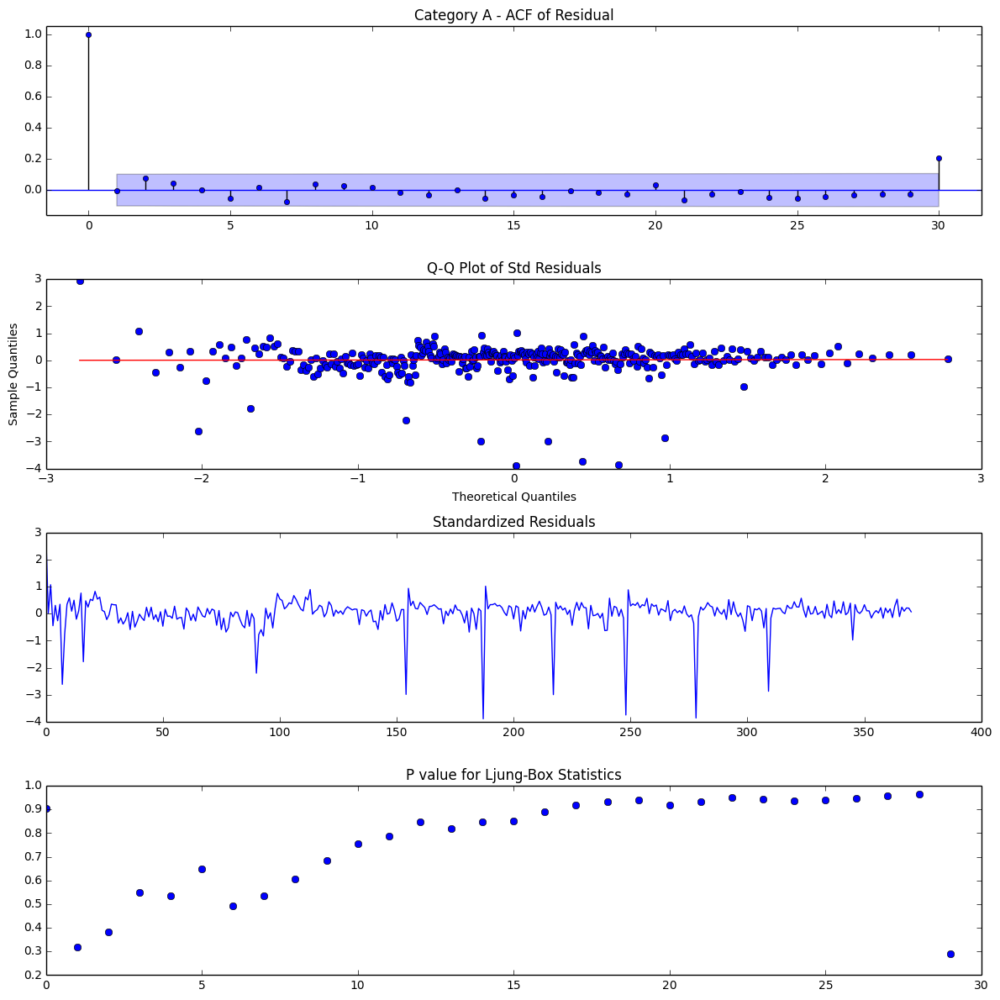

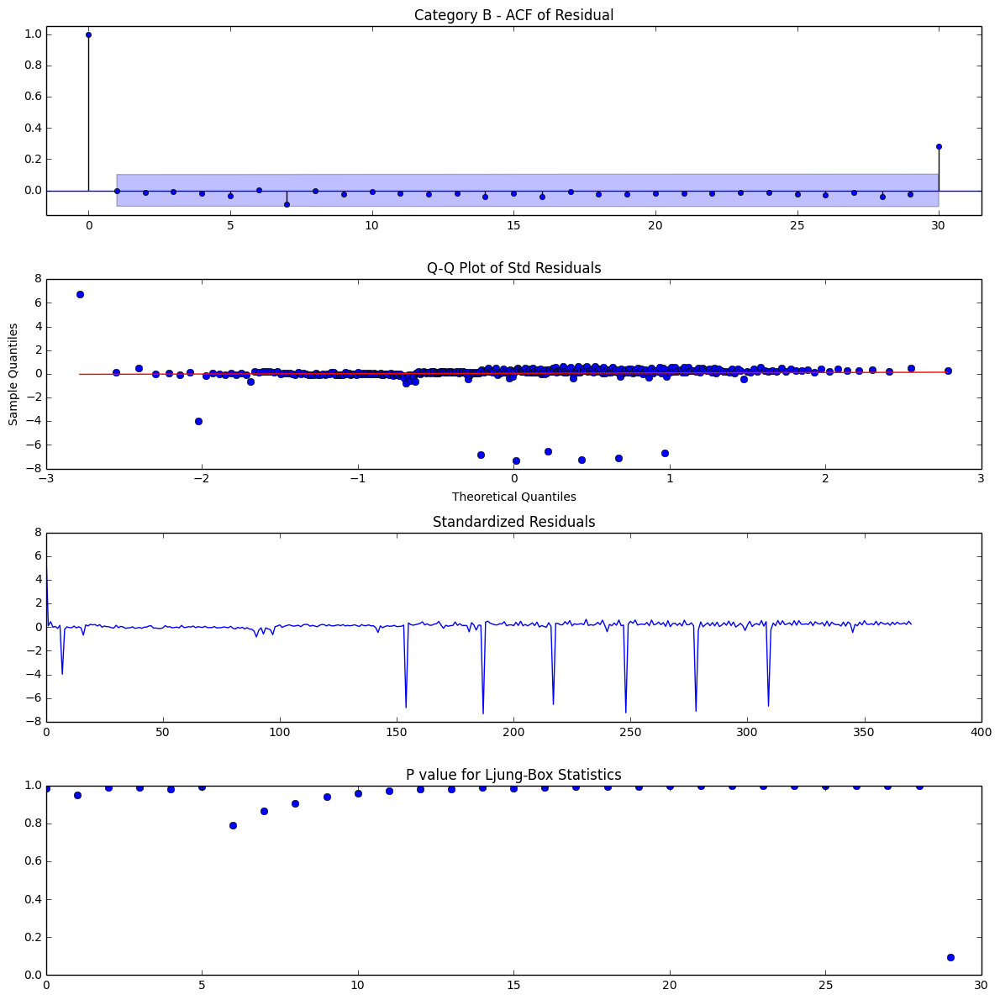

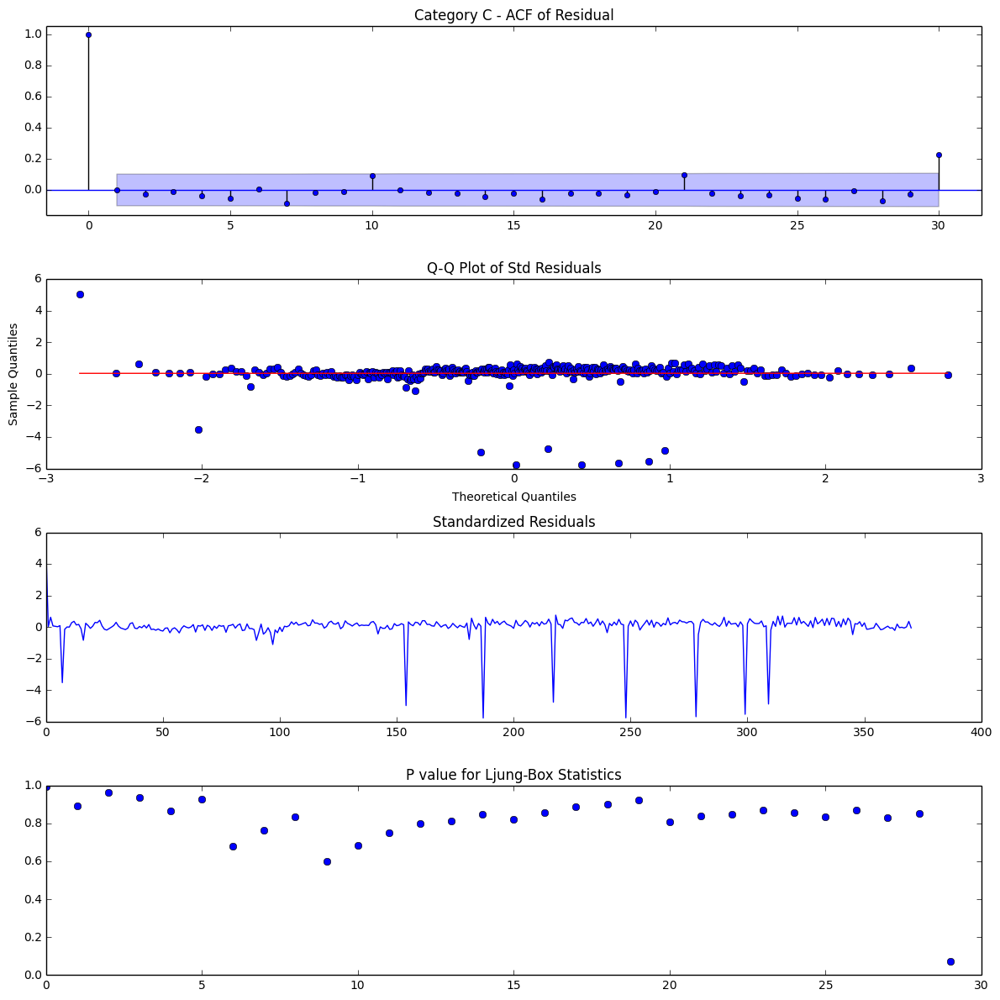

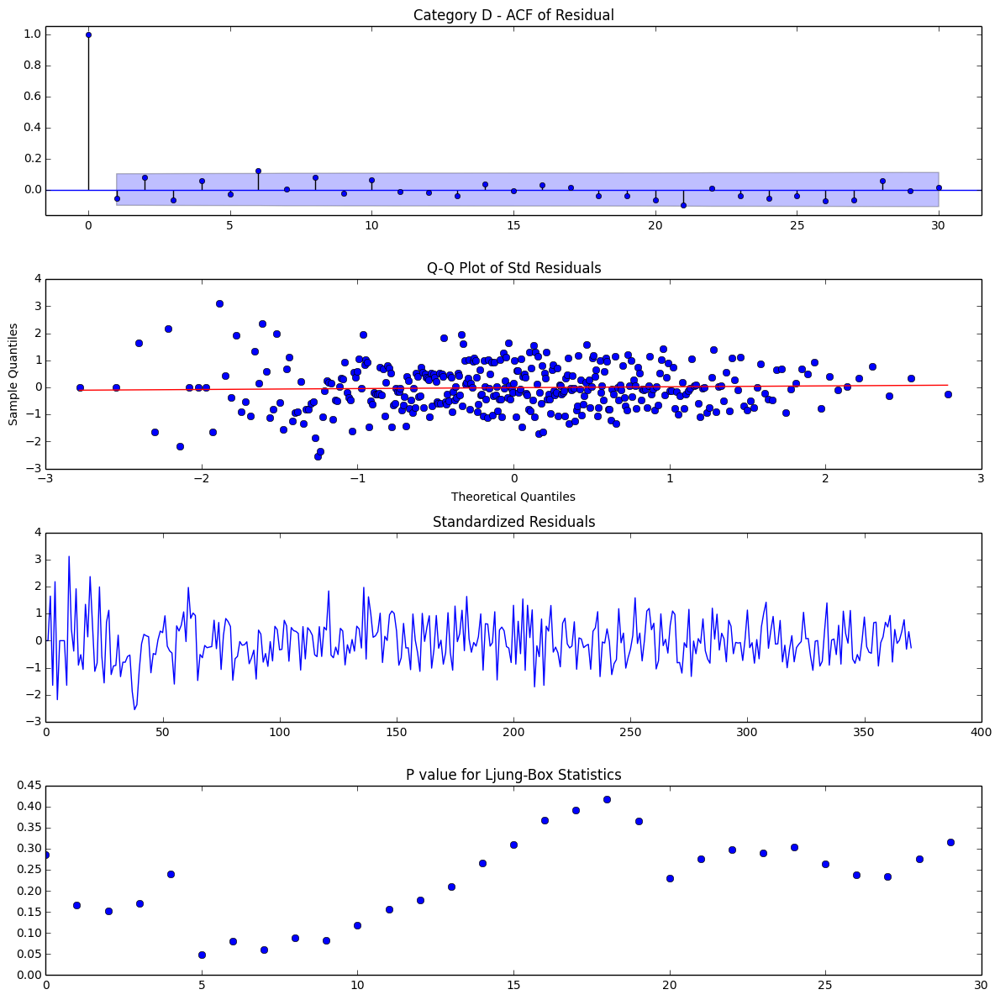

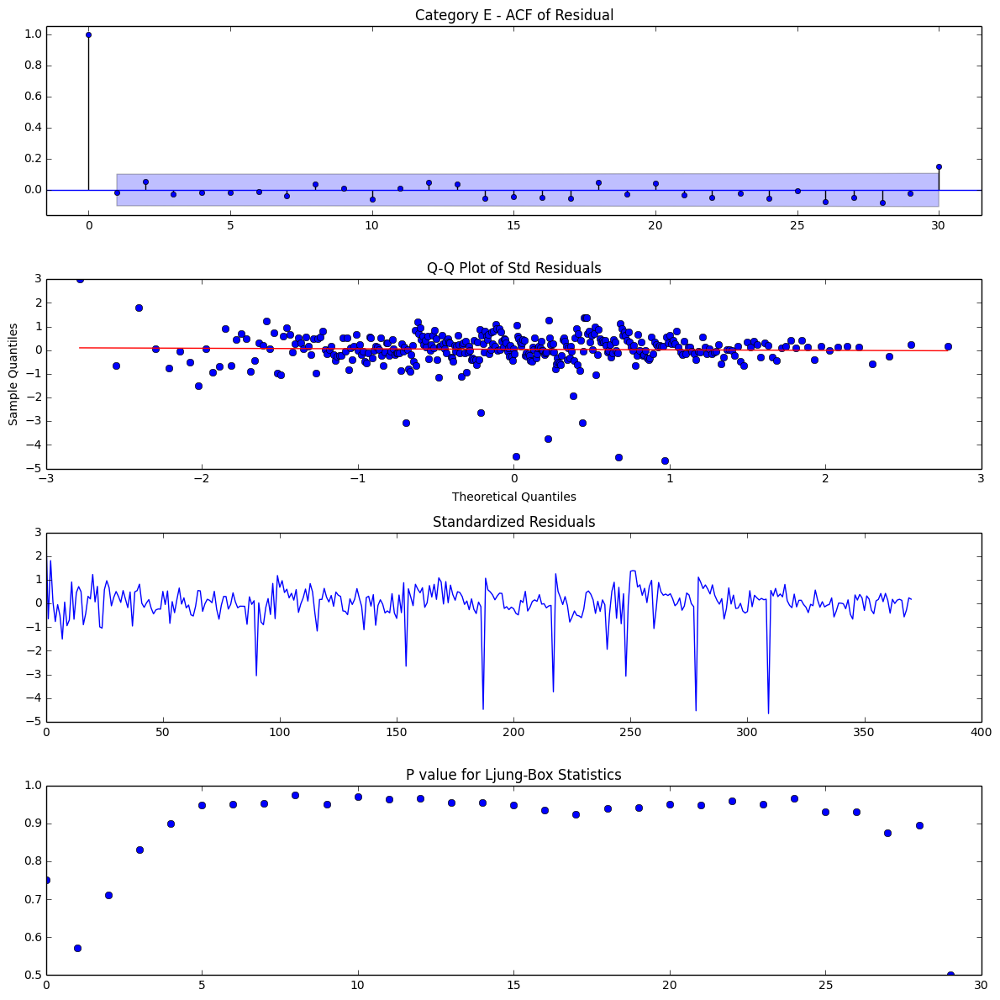

...

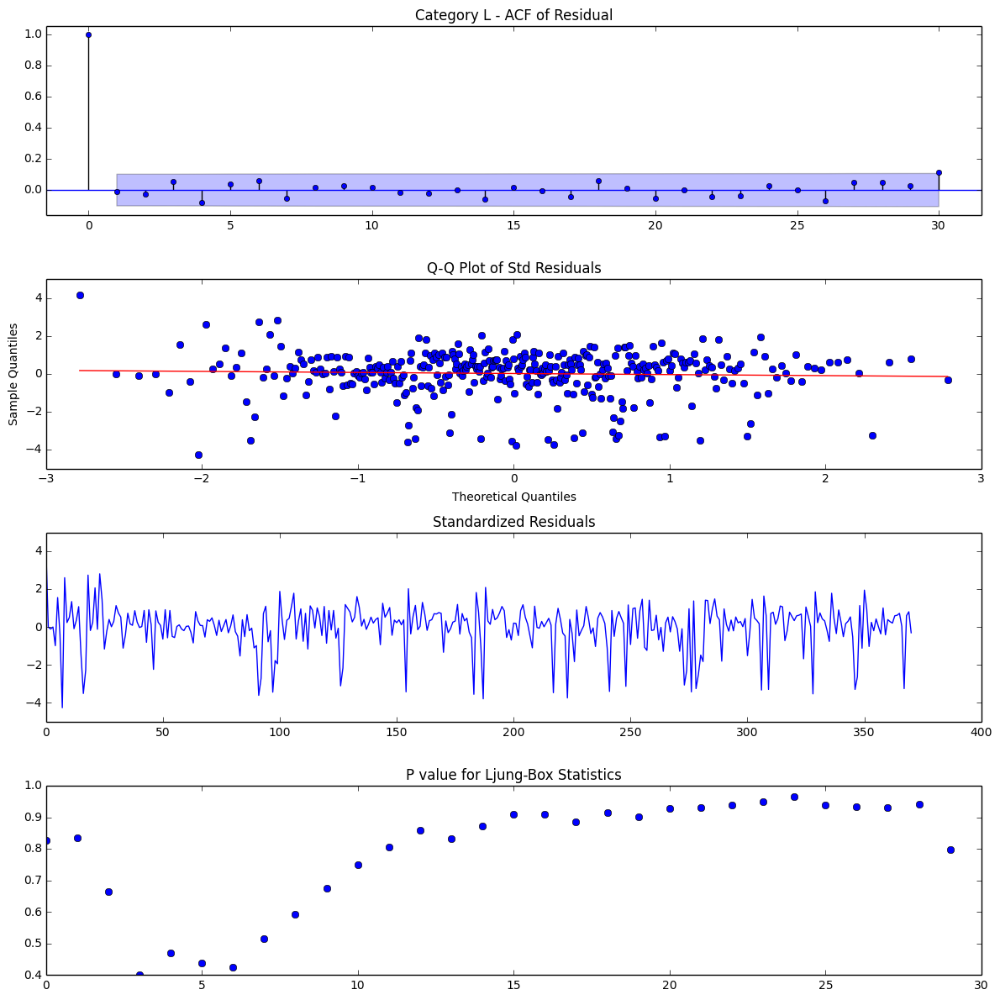

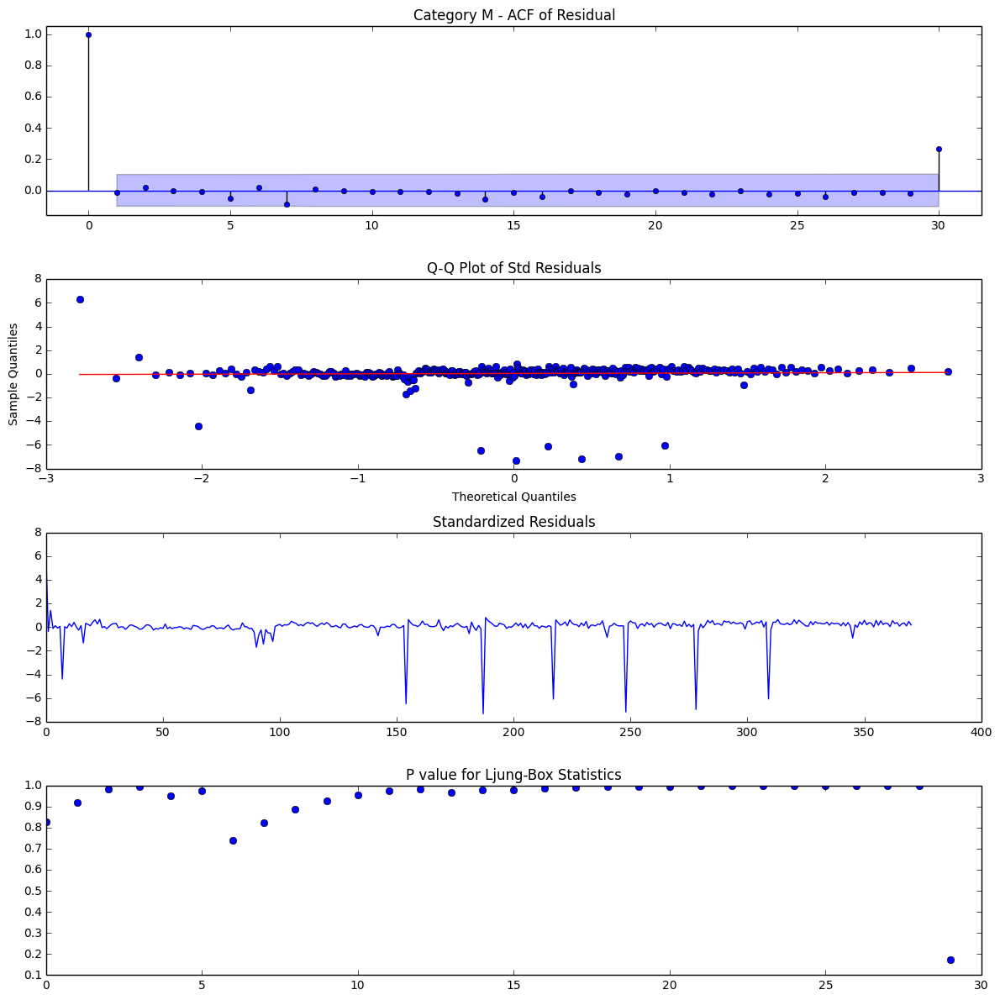

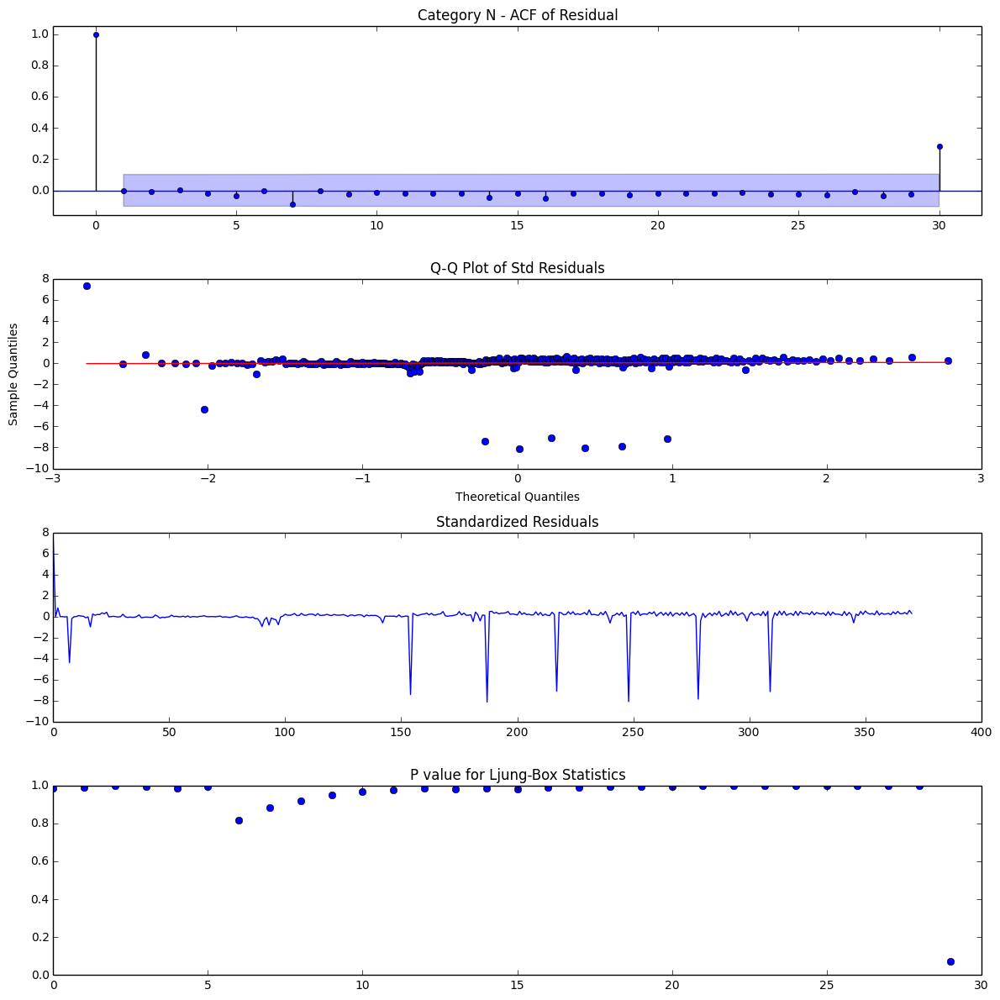

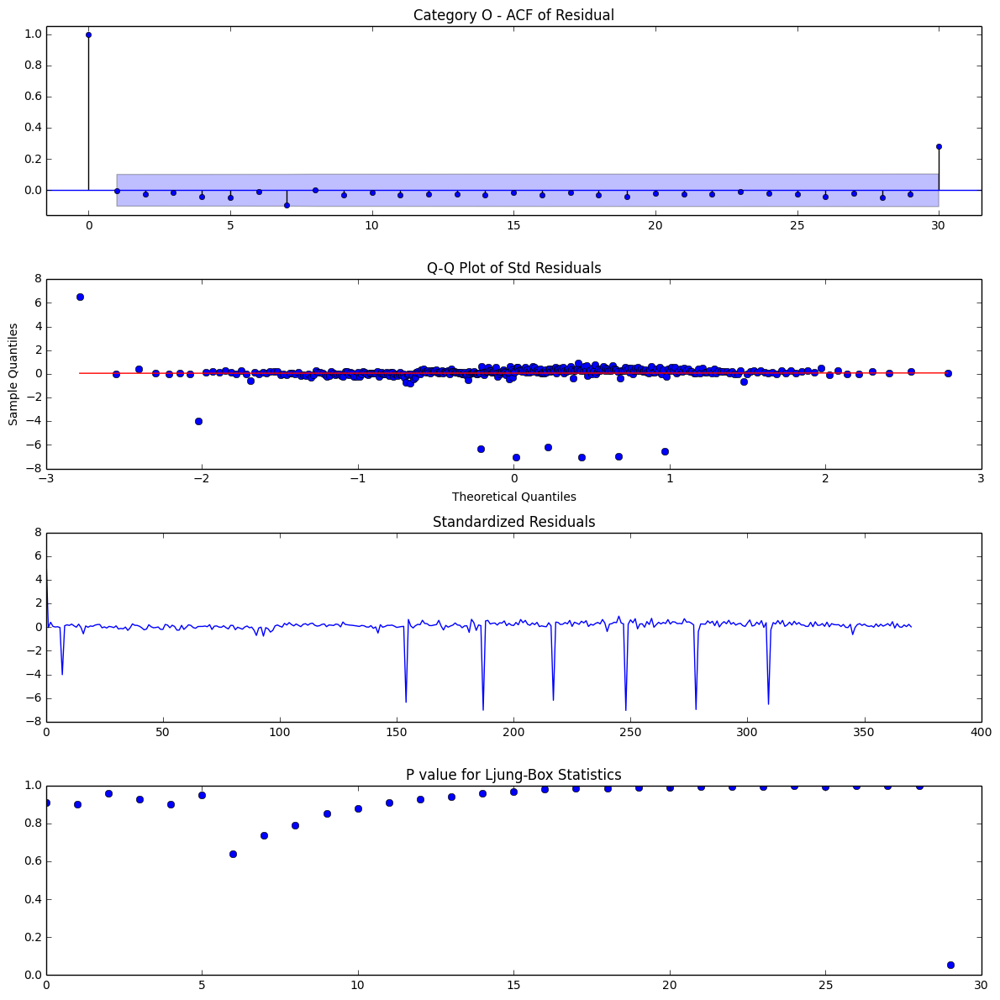

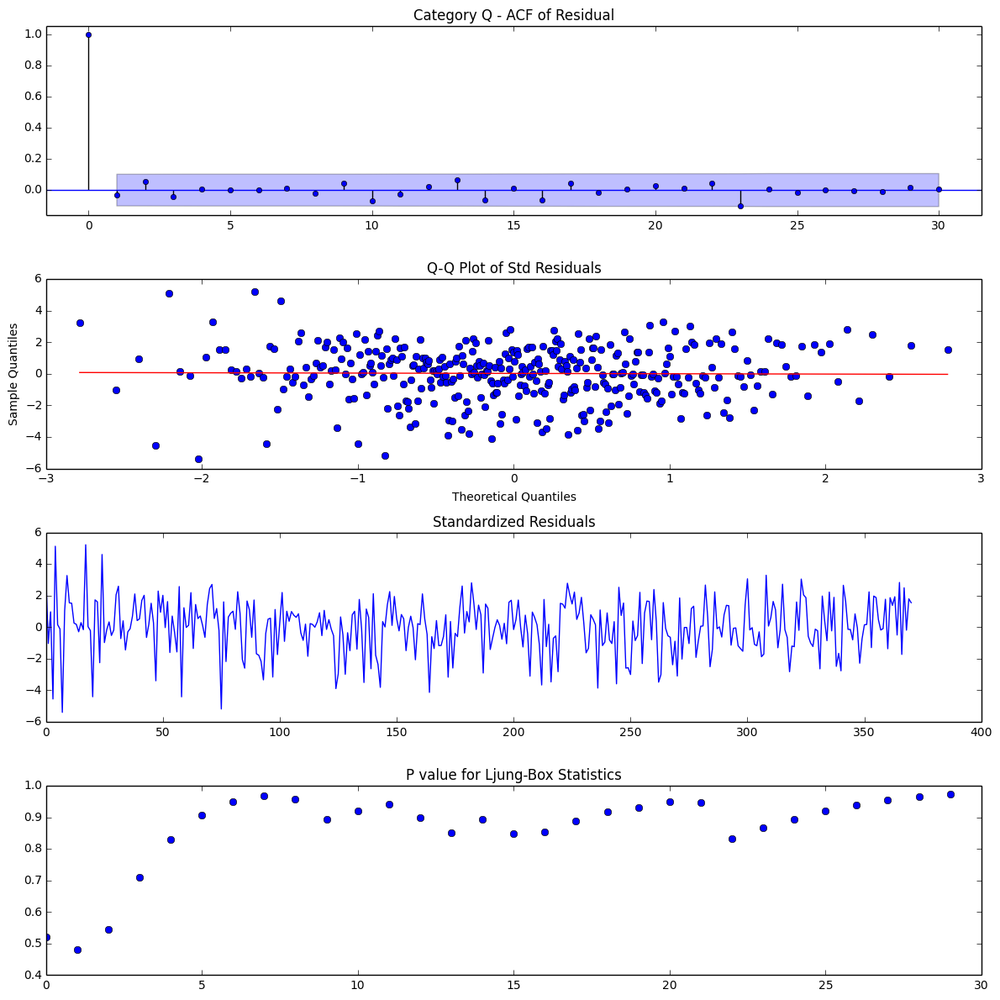

In [198]:
_ = map(residual_analysis, residuals, temp_list)

### Category L has problem...

# Prediction In Sample, and 90 Days Ahead

In [203]:
def plot_forecast(results, timeseries, item):
    pred = np.exp(results.predict())
#     forecast_90 = np.exp(results.predict(start=len(timeseries)-1, end=len(timeseries)+90))
    forecast_90 = np.exp(results.forecast(steps=90))

    plt.plot(pred.index, pred, label='predict')
    plt.plot(forecast_90.index, forecast_90, label='forecast')
    plt.plot(timeseries.index, timeseries, label='original')
    plt.title(' Category {} Forecast '.format(item))
    plt.legend()
    plt.show(block=False)
    
    return pred

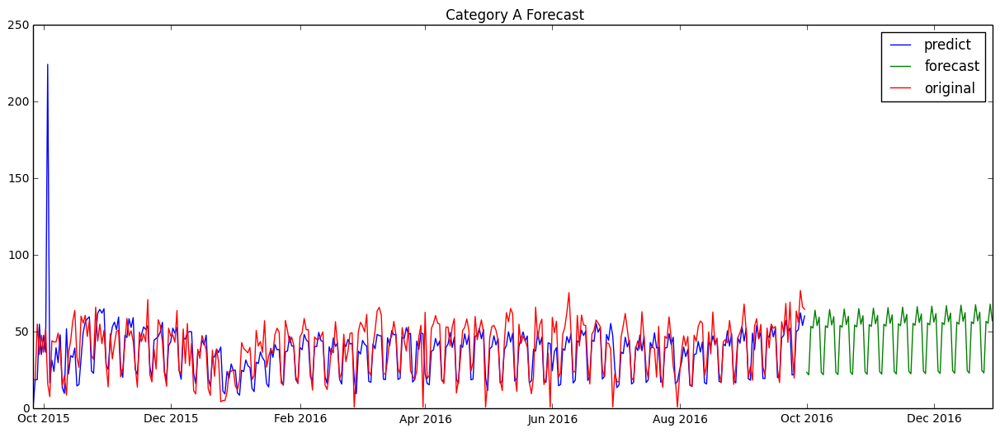

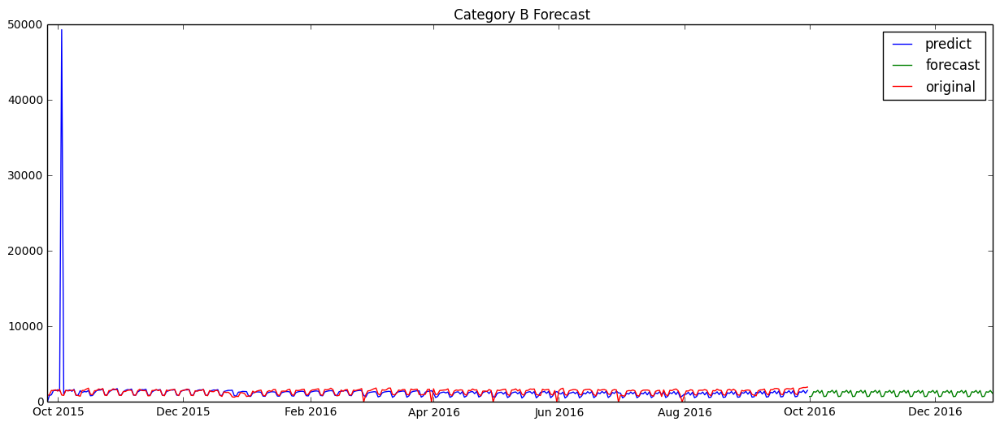

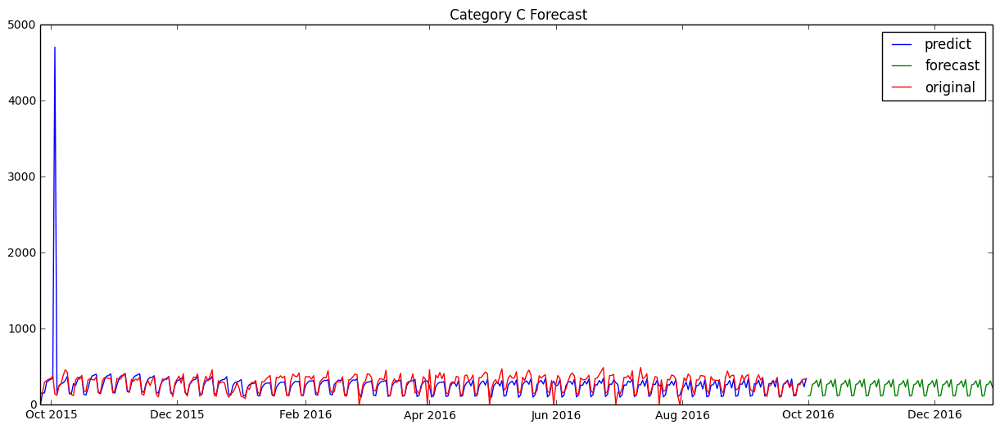

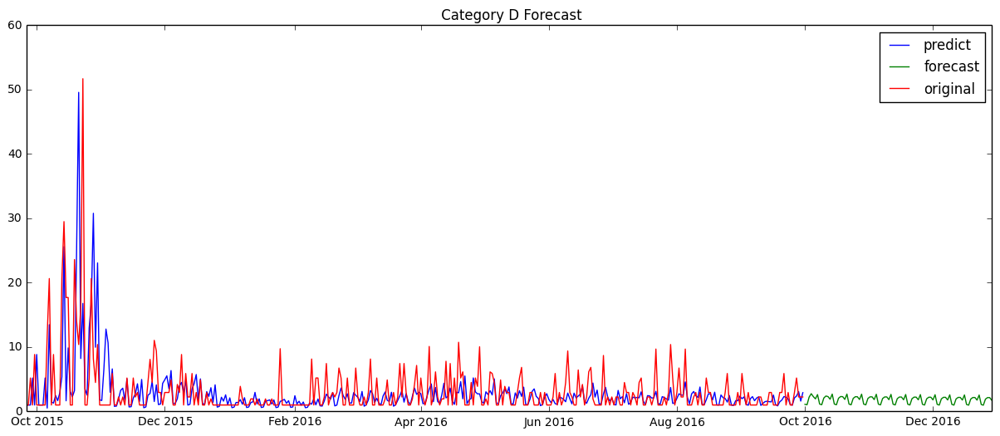

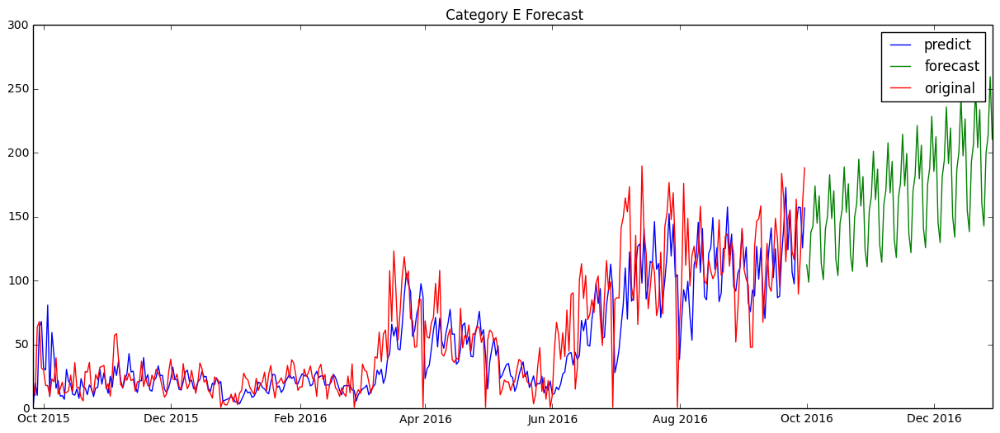

...

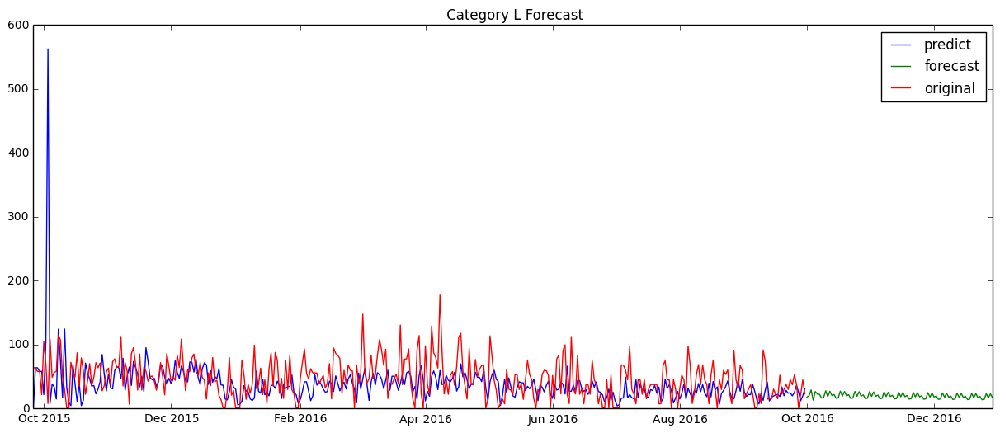

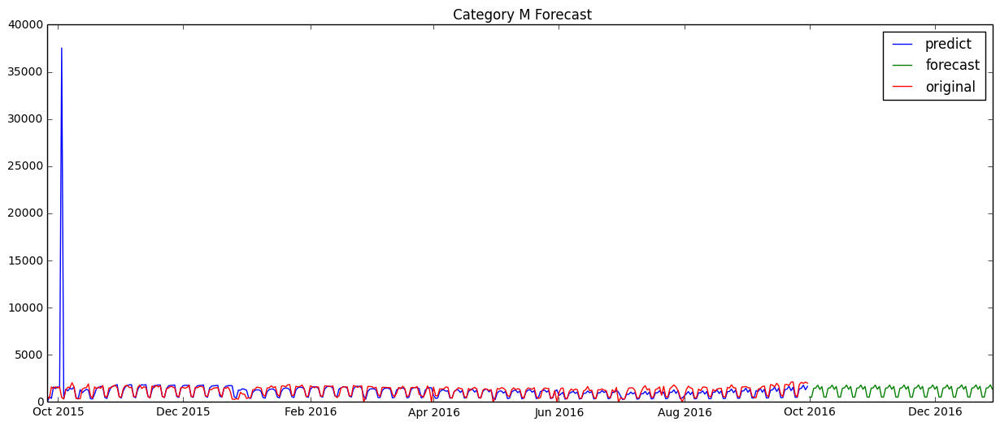

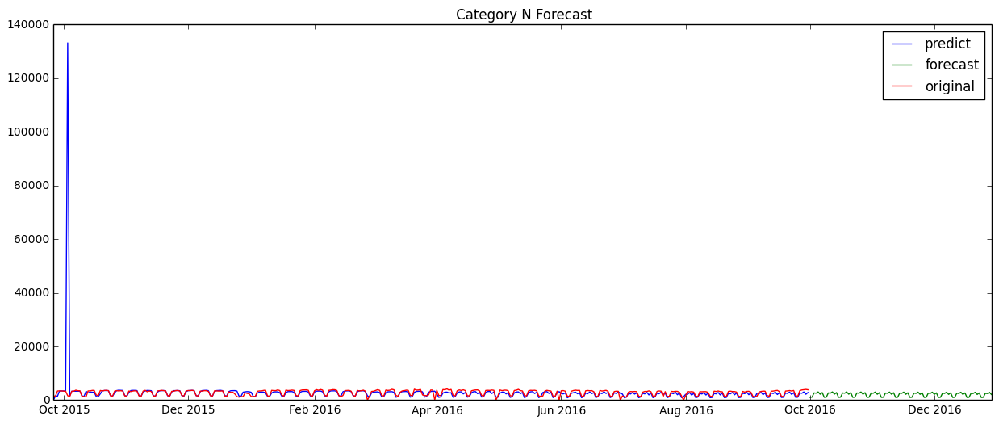

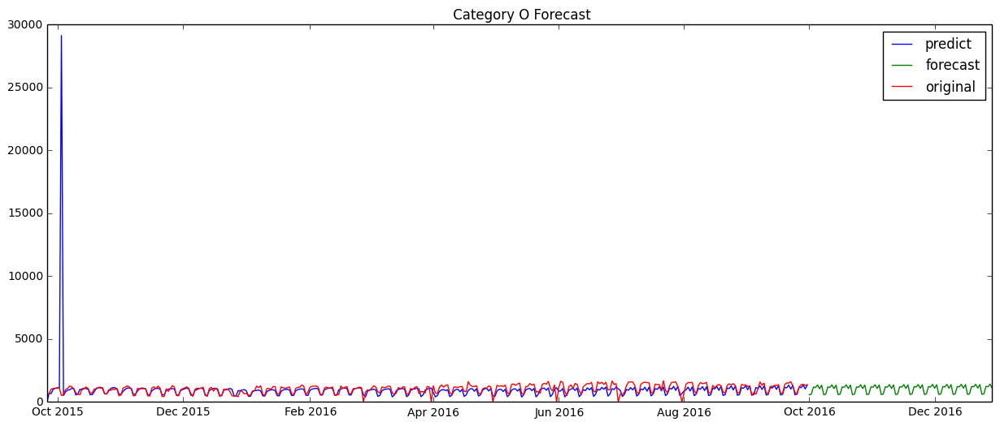

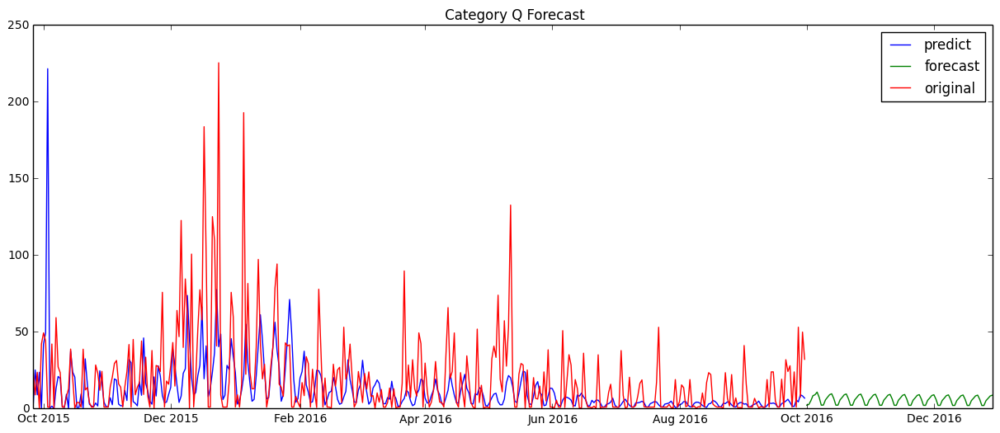

In [204]:
pred = map(plot_forecast, results_2, splitted_data, temp_list)

### Problem: A), D), E), I), L)

In [201]:
# report performance
def rmse_measurement(timeseries, pred, item):
    mse = mean_squared_error(timeseries, pred)
    rmse = sqrt(mse)
    print('Category {} - RMSE: %.3f'.format(item) % rmse)

In [202]:
_ = map(rmse_measurement, splitted_data, pred, temp_list)

Category A - RMSE: 16.222
Category B - RMSE: 2535.921
Category C - RMSE: 249.730
Category D - RMSE: 4.345
Category E - RMSE: 25.444
Category F - RMSE: 1868.498
Category G - RMSE: 616.265
Category H - RMSE: 1230.028
Category I - RMSE: 203.466
Category K - RMSE: 214.178
Category L - RMSE: 43.832
Category M - RMSE: 1955.075
Category N - RMSE: 6866.867
Category O - RMSE: 1513.784
Category Q - RMSE: 29.515


# Total Forecast

In [205]:
# forecast_90 = map(lambda x, y: np.exp(x.predict(start=len(y)-1, end=len(y)+90)), results_2, splitted_data)
# for i in range(0, len(splitted_data)):
#     plt.plot(range(0, len(splitted_data[i])), splitted_data[i], '-o')
#     forecast_90[i].plot()
#     plt.show(block=False)

forecast_90 = map(lambda x: np.exp(x.forecast(steps=90)), results_2)

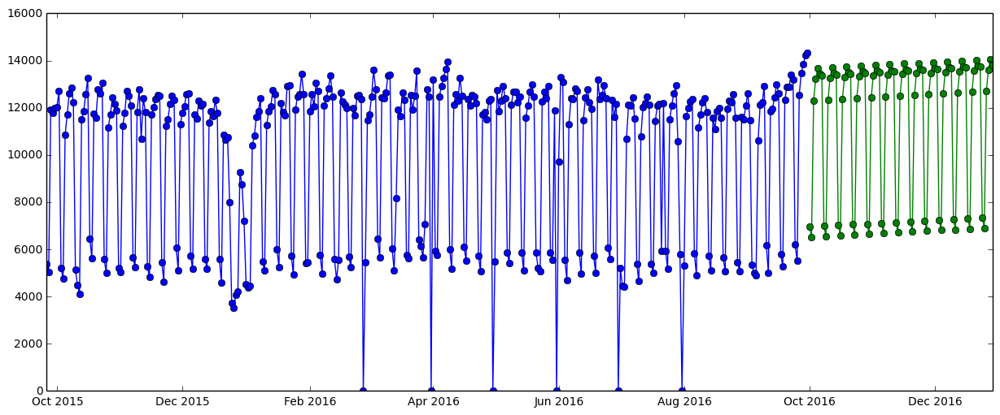

In [216]:
forecast_90 = map(lambda x: (x.forecast(steps=90)), results_3)

temp_forecast_2 = forecast_90[0]+forecast_90[1]+forecast_90[2]+forecast_90[3]+forecast_90[4]+ \
                forecast_90[5]+forecast_90[6]+forecast_90[7]+forecast_90[8]+forecast_90[9]+ \
                forecast_90[10]+forecast_90[11]+forecast_90[12]+forecast_90[13]+forecast_90[14]

temp_sales = splitted_data[0]+splitted_data[1]+splitted_data[2]+splitted_data[3]+splitted_data[4]+ \
            splitted_data[5]+splitted_data[6]+splitted_data[7]+splitted_data[8]+splitted_data[9]+ \
            splitted_data[10]+splitted_data[11]+splitted_data[12]+splitted_data[13]+splitted_data[14]

plt.plot(temp_sales.index, temp_sales, '-o')
plt.plot(temp_forecast_2.index, temp_forecast_2, '-o')

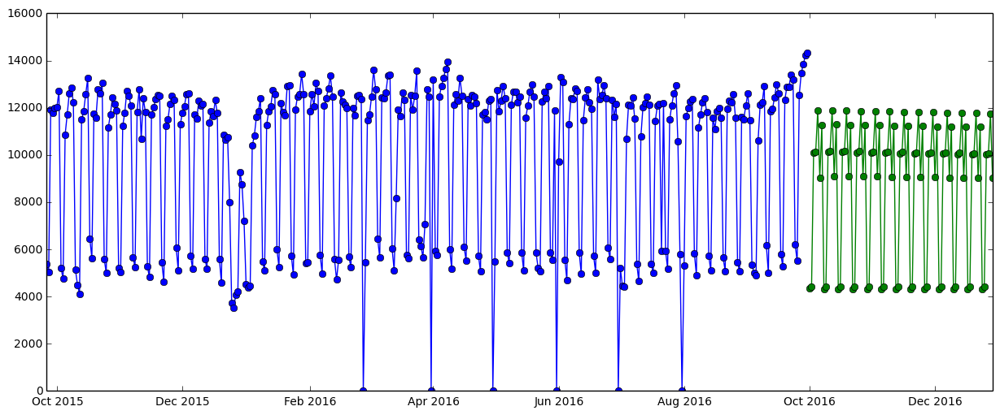

In [206]:
temp_forecast_2 = forecast_90[0]+forecast_90[1]+forecast_90[2]+forecast_90[3]+forecast_90[4]+ \
                forecast_90[5]+forecast_90[6]+forecast_90[7]+forecast_90[8]+forecast_90[9]+ \
                forecast_90[10]+forecast_90[11]+forecast_90[12]+forecast_90[13]+forecast_90[14]

temp_sales = splitted_data[0]+splitted_data[1]+splitted_data[2]+splitted_data[3]+splitted_data[4]+ \
            splitted_data[5]+splitted_data[6]+splitted_data[7]+splitted_data[8]+splitted_data[9]+ \
            splitted_data[10]+splitted_data[11]+splitted_data[12]+splitted_data[13]+splitted_data[14]

plt.plot(temp_sales.index, temp_sales, '-o')
plt.plot(temp_forecast_2.index, temp_forecast_2, '-o')

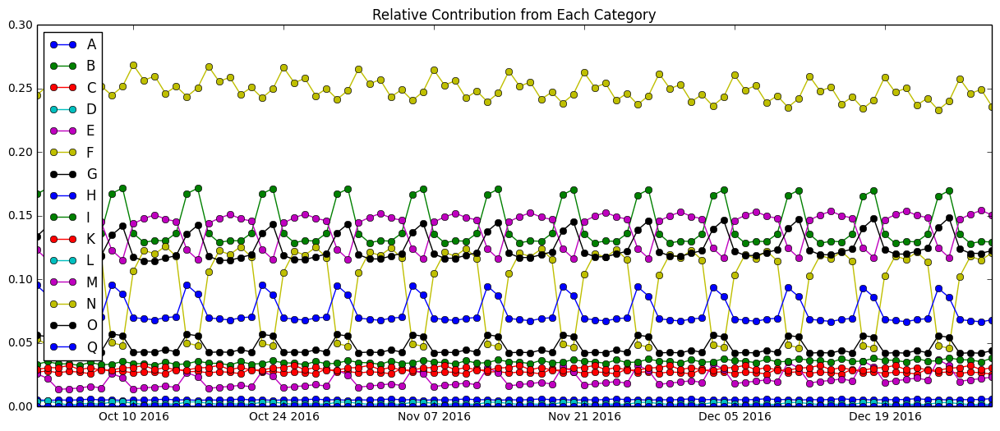

In [207]:
def relative_cont_plot(forecast_90, item):
    temp_A = forecast_90 / temp_forecast_2
    # plt.plot(temp_forecast_2.index, temp_forecast_2, '-o')
    # plt.plot(forecast_90[0].index, forecast_90[0], '-o')
    _ = plt.plot(temp_A.index, temp_A, '-o', label=item)
    _ = plt.legend(loc='best')
    _ = plt.title('Relative Contribution from Each Category')
    
_ = map(relative_cont_plot, forecast_90, temp_list)

In [383]:
temp_forecast.head(30)

2016-10-01    29913.205698
2016-10-02    28946.275998
2016-10-03    83466.469646
2016-10-04    87858.736595
2016-10-05    88965.086194
2016-10-06    88623.727943
2016-10-07    73943.700067
2016-10-08    36615.899115
2016-10-09    35810.123592
2016-10-10    80290.430530
2016-10-11    85468.301132
2016-10-12    86933.471882
2016-10-13    85581.309915
2016-10-14    74806.516967
2016-10-15    40490.084987
2016-10-16    39809.061171
2016-10-17    79581.287815
2016-10-18    85156.191958
2016-10-19    86808.063238
2016-10-20    84937.148561
2016-10-21    75960.776156
2016-10-22    43207.818145
2016-10-23    42595.282880
2016-10-24    80105.895803
2016-10-25    85876.345309
2016-10-26    87621.648282
2016-10-27    85480.894504
2016-10-28    77353.062182
2016-10-29    45409.822353
2016-10-30    44833.060519
Freq: D, dtype: float64

In [371]:
total_forecast = model_building(original_sales, 'Total', 0, 1, 0, 1)

Category Total:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  346
Model:             SARIMAX(0, 1, 1)x(0, 1, 1, 7)   Log Likelihood               -3769.269
Date:                           Thu, 16 Feb 2017   AIC                           7544.537
Time:                                   20:20:52   BIC                           7556.077
Sample:                               09-26-2015   HQIC                          7549.132
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1         -0.3097      0.037     -8.390      0.000      -0.382      -0.237
ma.S.L7       -0.2667     

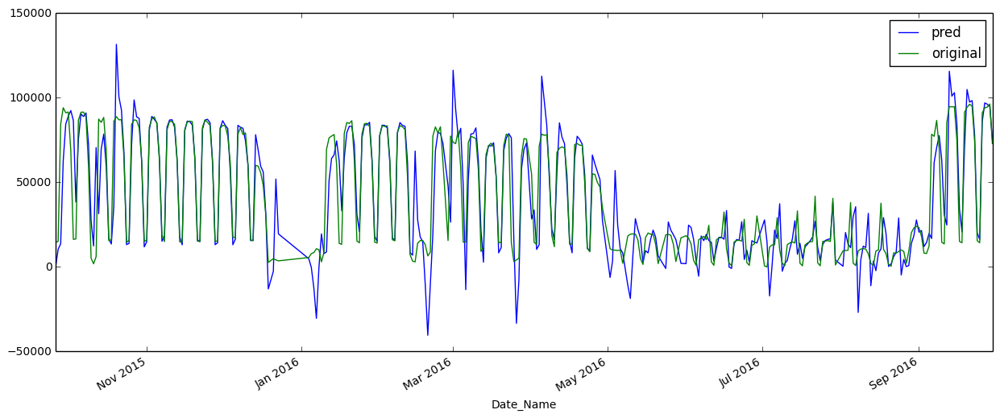

In [372]:
pred = total_forecast.predict()
pred_90 = total_forecast.predict(start=345, end=436)

pred.plot(label='pred')
original_sales.plot(label='original')
plt.legend()

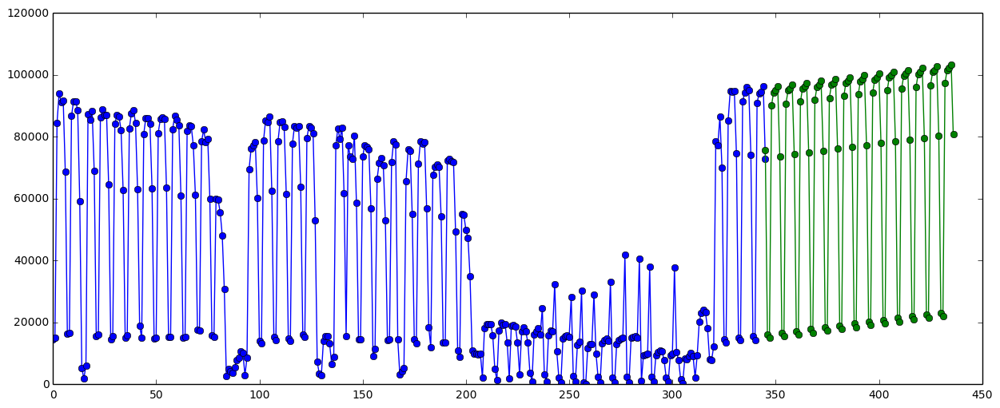

In [385]:
temp_array = np.array(original_sales)
plt.plot(temp_array, '-o')
plt.plot(pred_90.index, pred_90, '-o')

In [323]:
# Replace inf, -inf with 0...because after we log(0), we got inf values
original_sales_log = log_data(original_sales, 'foo')
original_sales_log = original_sales_log.replace([np.inf, -np.inf], 0)

In [374]:
total_forecast_2 = model_building(original_sales, 'Total', 1, 1, 1, 1)

Category Total:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  346
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 7)   Log Likelihood               -3756.059
Date:                           Thu, 16 Feb 2017   AIC                           7522.117
Time:                                   20:23:49   BIC                           7541.349
Sample:                               09-26-2015   HQIC                          7529.775
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.6920      0.040     17.327      0.000       0.614       0.770
ma.L1         -0.9960     

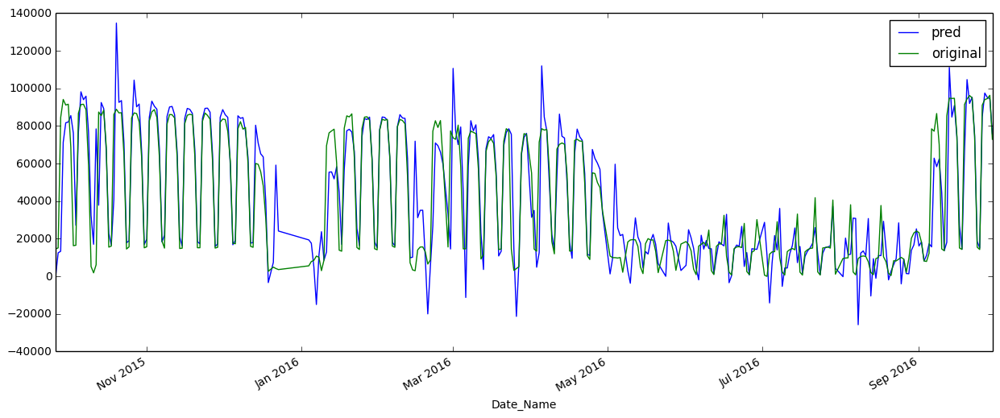

In [376]:
pred = total_forecast_2.predict()
pred_90_2 = total_forecast_2.predict(start=345, end=436)

pred.plot(label='pred')
original_sales.plot(label='original')
plt.legend()

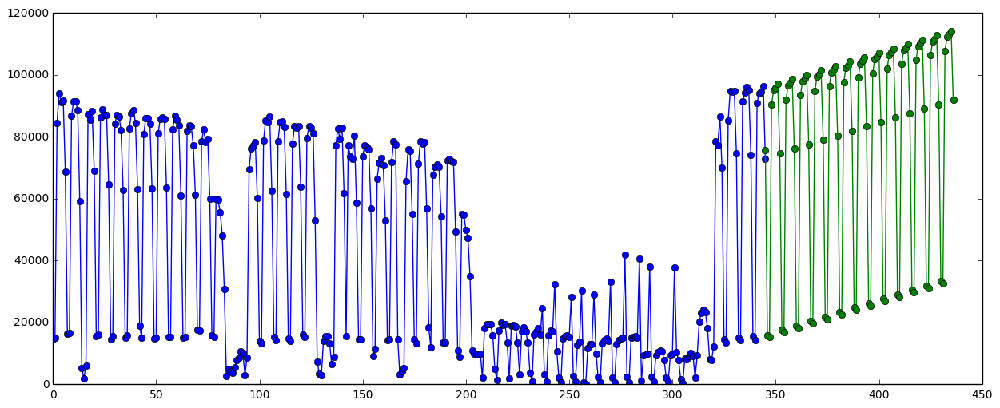

In [386]:
temp_array = np.array(original_sales)
plt.plot(temp_array, '-o')
plt.plot(pred_90_2.index, pred_90_2, '-o')

In [263]:
print original_sales.head()
idx = pd.date_range('09-26-2015', '09-30-2016')    

original_sales.index = pd.DatetimeIndex(original_sales.index)
original_sales = original_sales.reindex(idx, fill_value=original_sales.mean())
print original_sales.shape, '-', original_sales.index

print '\n', original_sales.head()

2015-09-26    14588.23
2015-09-27    15143.61
2015-09-28    84535.83
2015-09-29    94145.18
2015-09-30    91173.07
Freq: D, Name: sales, dtype: float64
(371,) - DatetimeIndex(['2015-09-26', '2015-09-27', '2015-09-28', '2015-09-29',
               '2015-09-30', '2015-10-01', '2015-10-02', '2015-10-03',
               '2015-10-04', '2015-10-05',
               ...
               '2016-09-21', '2016-09-22', '2016-09-23', '2016-09-24',
               '2016-09-25', '2016-09-26', '2016-09-27', '2016-09-28',
               '2016-09-29', '2016-09-30'],
              dtype='datetime64[ns]', length=371, freq='D')

2015-09-26    14588.23
2015-09-27    15143.61
2015-09-28    84535.83
2015-09-29    94145.18
2015-09-30    91173.07
Freq: D, Name: sales, dtype: float64
